In [1]:
from utils import *
from torchvision import transforms as T 
from DIV2K_Dataset import DIV2K_Dataset as DIV2K
from torch.utils.data import Dataset, DataLoader
from model import model
import matplotlib.pyplot as plt

define dataloader

In [2]:
batchSize = 16

In [3]:
transforms = T.Compose([Flippe(),Rotation(),ToTensor()])

train_data = DIV2K(scale=4,transform=transforms)
test_data = DIV2K(scale=4, train=False, transform=ToTensor())


train_loader = DataLoader(train_data, 
                          batch_size=batchSize,
                          drop_last=True,
                          shuffle=True)

test_loader = DataLoader(test_data, 
                         batch_size=1,
                         shuffle=False)

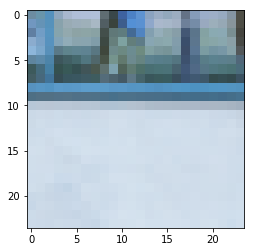

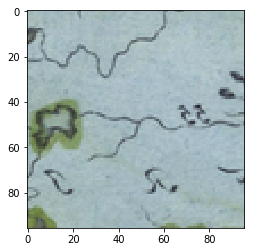

In [21]:
# t_device = torch.device('cuda:1')
# img_input = None
# img_tar = None
# # viz = Visualizer()

# for i, data in enumerate(train_data):
#     input_, target_ = data['input'], data['label']
#     input_ = input_.to(t_device)
#     target_ = target_.to(t_device)
    
#     if i == 0:
#         plt.imshow(np.transpose(input_.detach().cpu().numpy(), (1,2,0)))
#         plt.pause(0.05)
#         plt.imshow(np.transpose(target_.detach().cpu().numpy(), (1,2,0)))
# #         img_input = viz.images(input_,win = img_input,title = 'img_input')
# #         img_tar = viz.images(target_,win = img_tar,title = 'img_target')
#     else:
#         break

define variables

In [17]:
def denorm(x):
    # denormalize
    out = (x + 1) / 2
    return out.clamp(0, 1)

In [4]:
def imshow(img):
    plt.imshow(np.transpose(img.detach().cpu().numpy(), (1,2,0)))
    plt.pause(0.05)

train

In [18]:
def train(model, loss_fn, optimizer, device, dataloader):
    '''
    train for model
    model: for training
    loss_fn: the loss function
    optimizer: optimizer
    device: device for training
    dataloader: dataloader
    '''
    model.train()
    total_loss = 0
    print('Training...')
    for i, data in enumerate(dataloader):
        input_, target_ = data['input'], data['label']
        input_ = input_.to(device)
        target_ = target_.to(device)
        
        # forward
        output = model(input_)
        loss = loss_fn(output, target_)
        
        # backward and optimize
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        # compute total loss
        total_loss += loss.item()
        
        # every 50 iter show two img
        if i == 0 or (i + 1) % 50 == 0:
            imshow(denorm(output[0]))
            imshow(denorm(target_[0]))
            print('--------------------------------------------------------------------------------------')
       
    return total_loss / (len(dataloader))

In [19]:
def eval(model, loss_fn, device, dataloader):
    
    model.eval()
    print('Testing...')
    with torch.no_grad():
        t_loss = 0.0
        for i, datas in enumerate(dataloader):
            inputs = datas['input'].to(device)
            targets = datas['label'].to(device)

            output = model(inputs)
            loss = loss_fn(output, targets)
            
            t_loss += loss.item()
            
            # every 10 iter show two img
            if i == 0 or (i + 1) % 10 == 0:
                imshow(denorm(output[0]))
                imshow(denorm(targets[0]))
                print('--------------------------------------------------------------------------------------')
            
        return t_loss / len(dataloader)

In [20]:
def show_curve(ys, title):
    """
    plot curlve for Loss and Accuacy
    Args:
        ys: loss or acc list
        title: loss or accuracy
    """
    x = np.array(range(len(ys)))
    y = np.array(ys)
    plt.plot(x, y, c='b')
    plt.axis()
    plt.title('{} curve'.format(title))
    plt.xlabel('epoch')
    plt.ylabel('{}'.format(title))
    plt.show()

In [21]:
def run_model(model, epochs, loss_fn, lr, lr_decay, device, train_loader, test_loader, save):
    model.to(device)
    loss_fn.to(device)
    # log train loss and test accuracy
    train_losses = []
    test_losses = []
    
    decayType = 0
    
    for epoch in range(epochs):
        
        optimizer = optim.Adam(my_model.parameters())
        learning_rate = set_lr(lr, decayType, lr_decay, epoch, optimizer)
        
        # train step
        train_loss = train(model, loss_fn, optimizer, device, train_loader)
        train_losses.append(train_loss)
        
        # evaluate step
        test_loss = eval(model, loss_fn, device, test_loader)
        test_losses.append(test_loss)
        
        print('Epoch {}/{}:'.format(epoch + 1, epochs))
        print('Train Loss: {:.4f}'.format(train_loss))
        print('Test(Validation) Loss: {:.4f}'.format(test_loss))
        
        if (epoch + 1) % 10 == 0:
            '''show loss 10 epoch'''
            log = "[{} / {}] \tLearning_rate: {}\t train_loss: {:.4f}\t test_loss: {:.4f}".format(epoch+1, 
                            epochs, learning_rate, train_loss, test_loss)
            print(log)
            
            show_curve(train_losses, 'training loss')
            show_curve(test_losses, 'testing loss')

In [22]:
epochs = 50
lr = 1e-4
lr_decay = 500
device = torch.device('cuda:0')

my_model = model.RDN(scale=4)
my_model.apply(weights_init_kaiming)

loss_fn = nn.L1Loss() 
# loss_fn = nn.MSELoss()


In [23]:
save = None

fine tuning

Training...


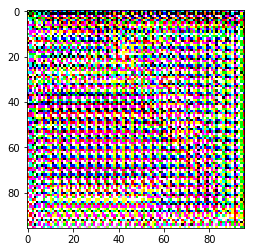

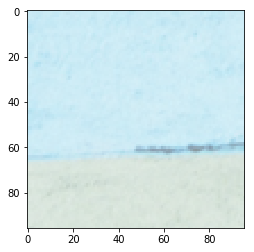

--------------------------------------------------------------------------------------


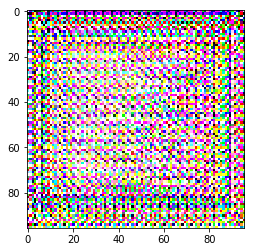

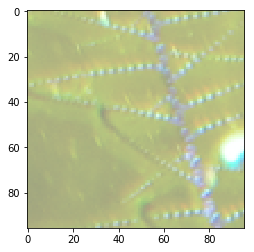

--------------------------------------------------------------------------------------
Testing...


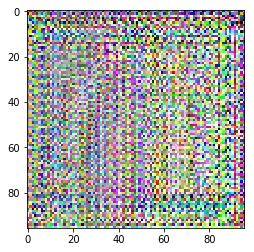

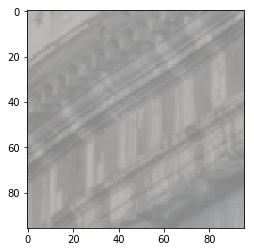

--------------------------------------------------------------------------------------


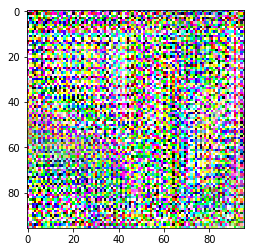

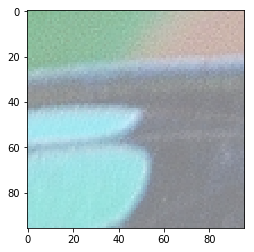

--------------------------------------------------------------------------------------


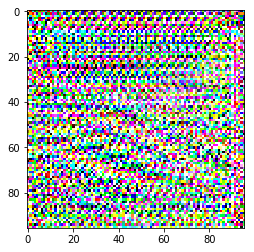

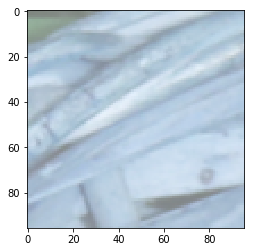

--------------------------------------------------------------------------------------


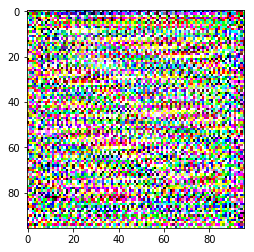

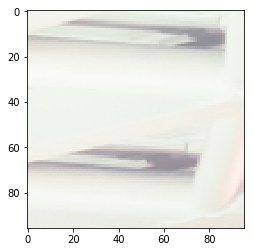

--------------------------------------------------------------------------------------


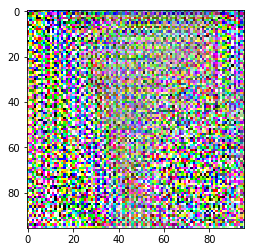

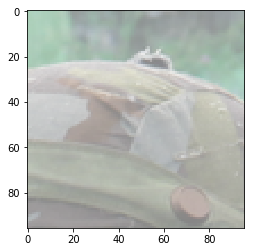

--------------------------------------------------------------------------------------


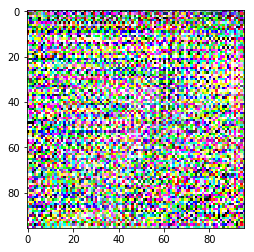

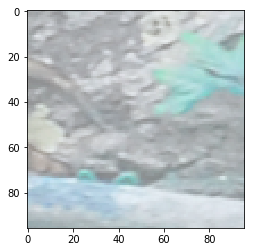

--------------------------------------------------------------------------------------


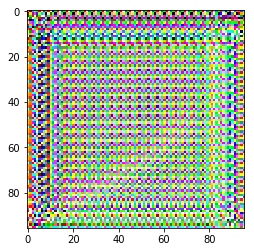

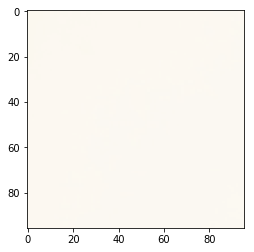

--------------------------------------------------------------------------------------


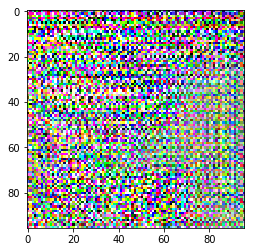

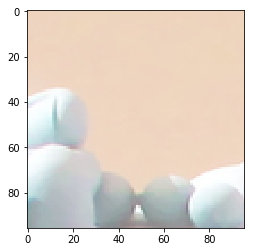

--------------------------------------------------------------------------------------


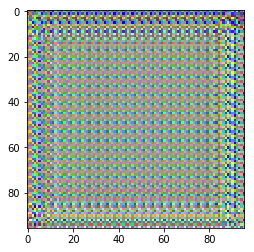

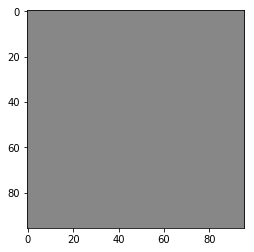

--------------------------------------------------------------------------------------


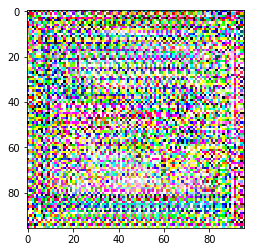

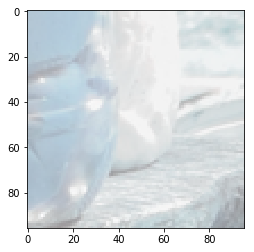

--------------------------------------------------------------------------------------


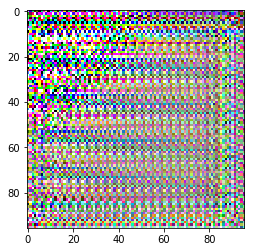

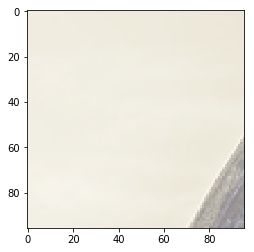

--------------------------------------------------------------------------------------
Epoch 1/50:
Train Loss: 1.9670
Test(Validation) Loss: 1.1959
Training...


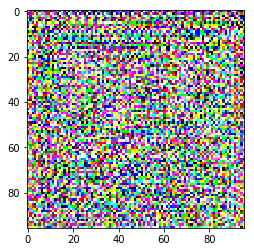

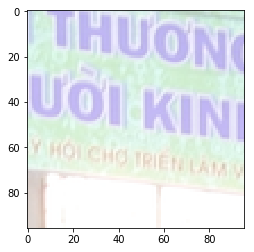

--------------------------------------------------------------------------------------


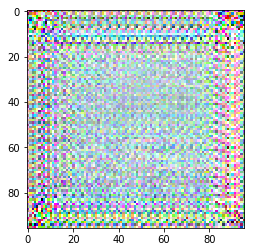

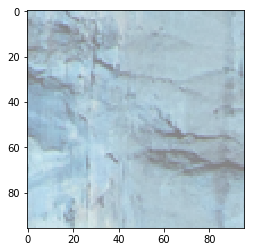

--------------------------------------------------------------------------------------
Testing...


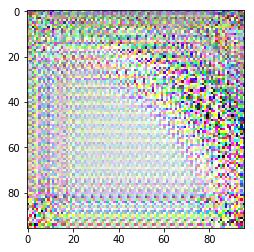

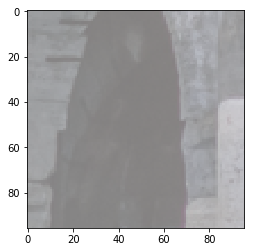

--------------------------------------------------------------------------------------


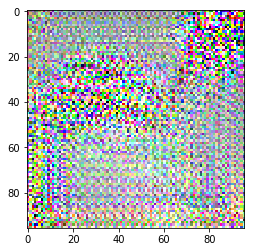

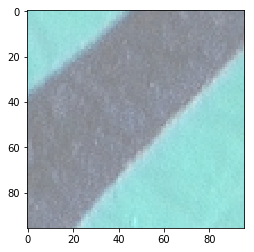

--------------------------------------------------------------------------------------


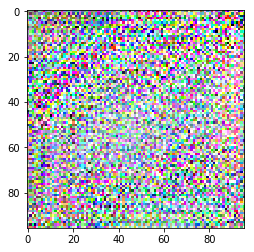

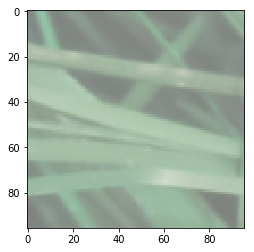

--------------------------------------------------------------------------------------


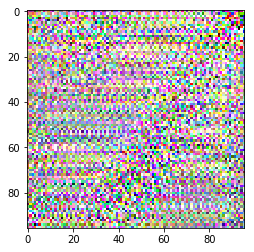

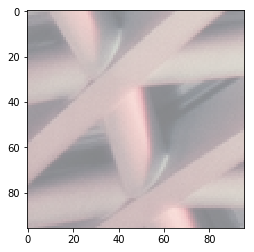

--------------------------------------------------------------------------------------


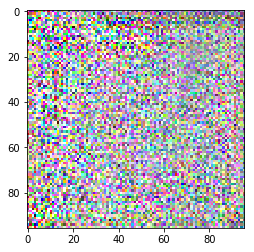

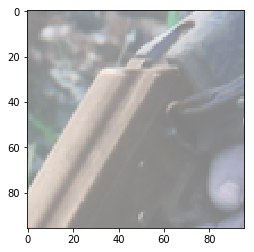

--------------------------------------------------------------------------------------


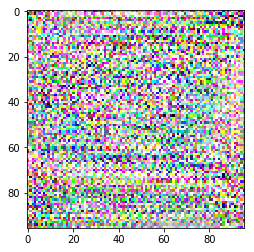

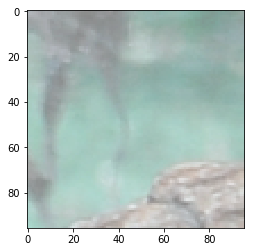

--------------------------------------------------------------------------------------


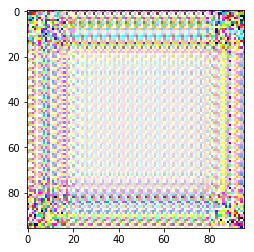

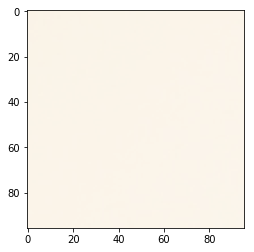

--------------------------------------------------------------------------------------


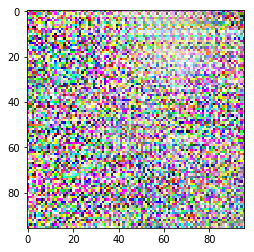

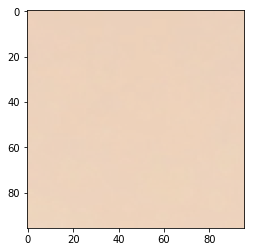

--------------------------------------------------------------------------------------


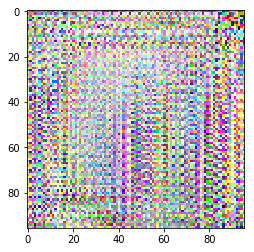

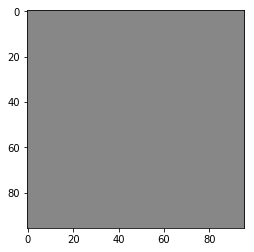

--------------------------------------------------------------------------------------


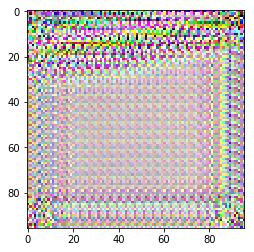

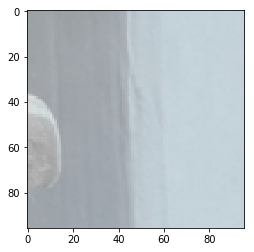

--------------------------------------------------------------------------------------


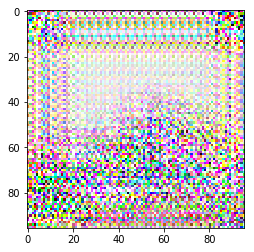

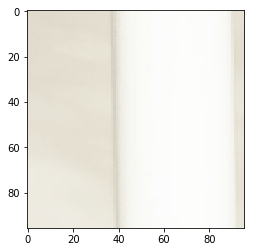

--------------------------------------------------------------------------------------
Epoch 2/50:
Train Loss: 0.8307
Test(Validation) Loss: 0.6169
Training...


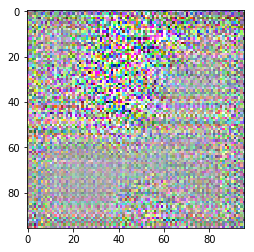

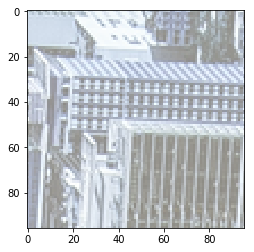

--------------------------------------------------------------------------------------


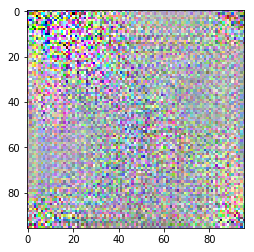

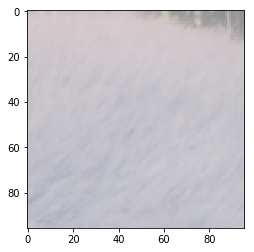

--------------------------------------------------------------------------------------
Testing...


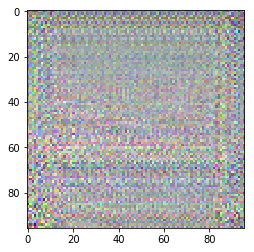

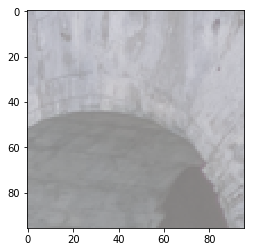

--------------------------------------------------------------------------------------


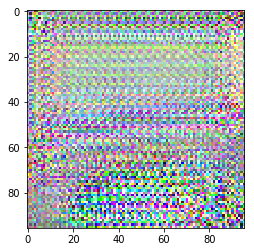

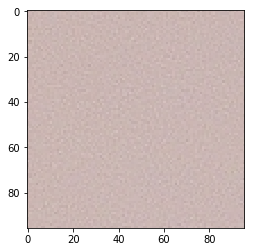

--------------------------------------------------------------------------------------


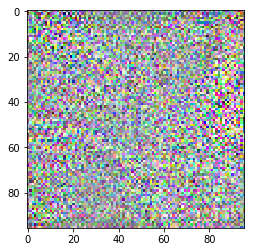

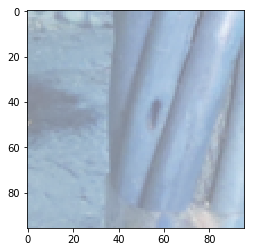

--------------------------------------------------------------------------------------


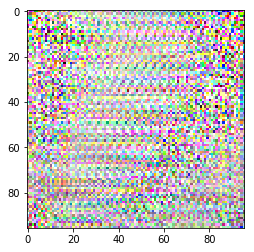

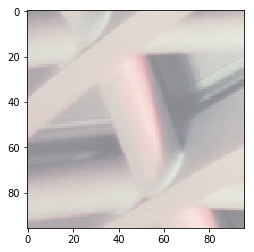

--------------------------------------------------------------------------------------


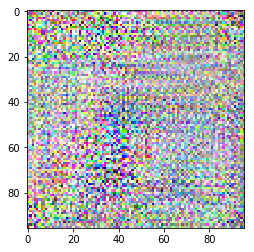

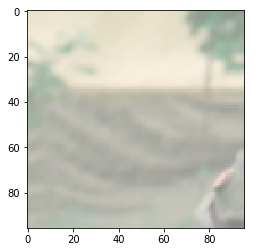

--------------------------------------------------------------------------------------


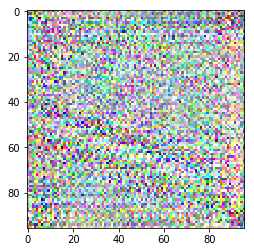

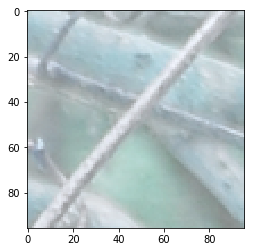

--------------------------------------------------------------------------------------


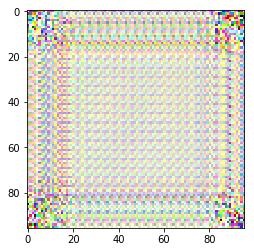

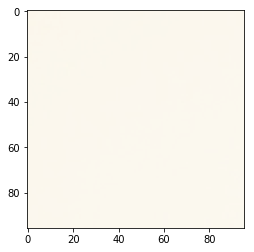

--------------------------------------------------------------------------------------


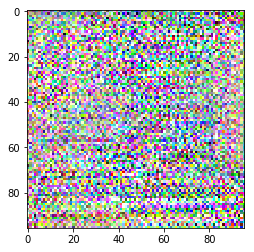

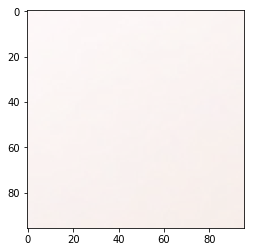

--------------------------------------------------------------------------------------


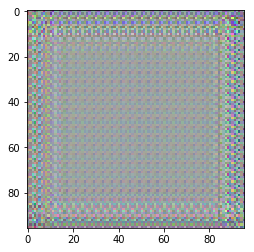

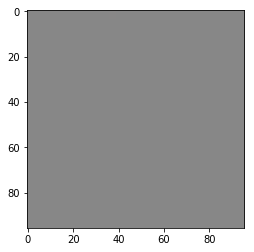

--------------------------------------------------------------------------------------


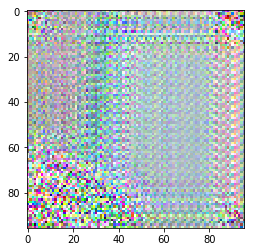

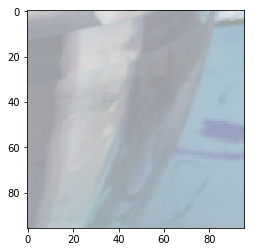

--------------------------------------------------------------------------------------


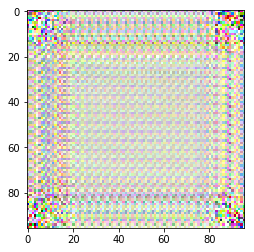

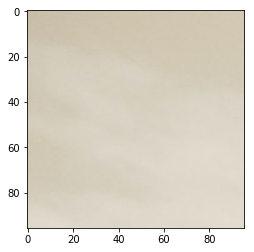

--------------------------------------------------------------------------------------
Epoch 3/50:
Train Loss: 0.5281
Test(Validation) Loss: 0.4666
Training...


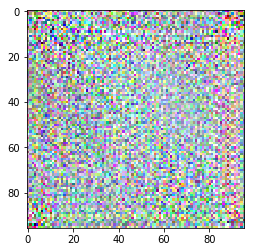

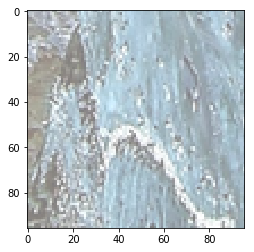

--------------------------------------------------------------------------------------


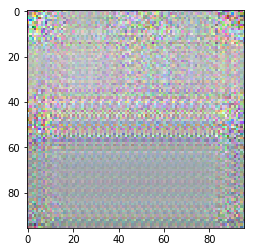

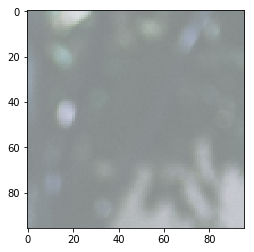

--------------------------------------------------------------------------------------
Testing...


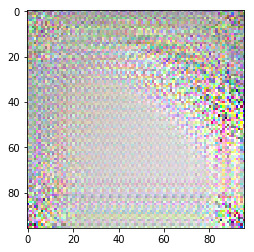

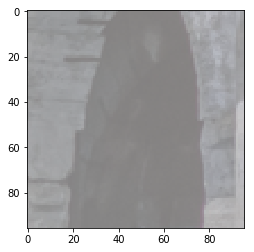

--------------------------------------------------------------------------------------


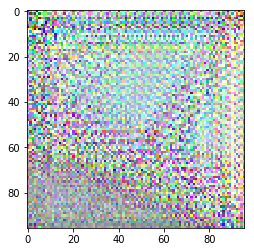

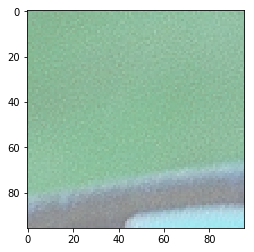

--------------------------------------------------------------------------------------


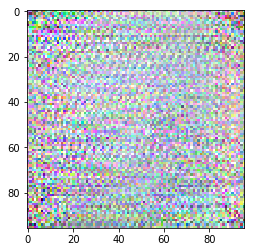

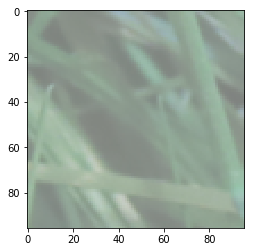

--------------------------------------------------------------------------------------


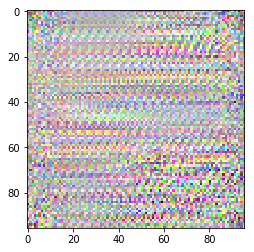

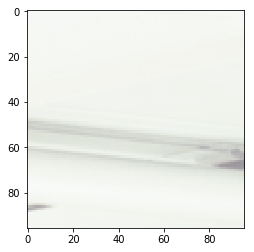

--------------------------------------------------------------------------------------


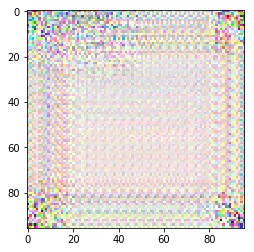

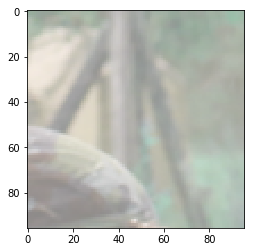

--------------------------------------------------------------------------------------


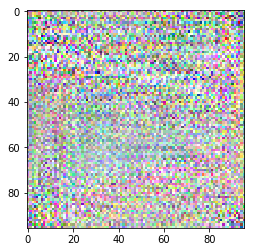

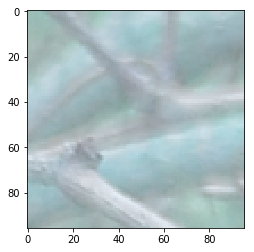

--------------------------------------------------------------------------------------


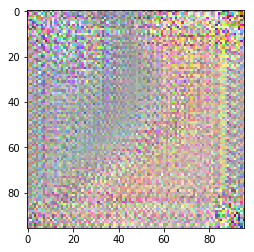

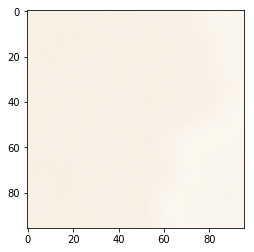

--------------------------------------------------------------------------------------


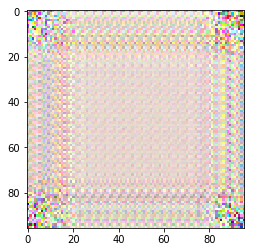

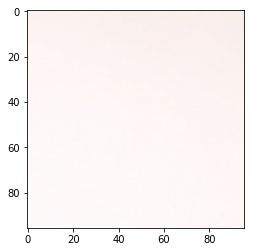

--------------------------------------------------------------------------------------


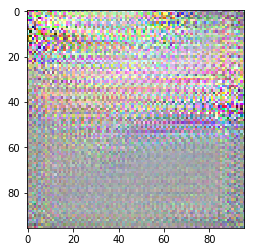

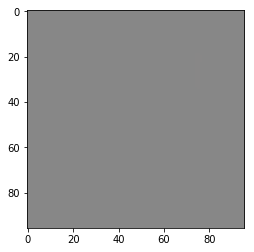

--------------------------------------------------------------------------------------


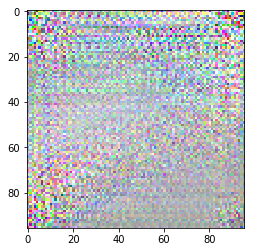

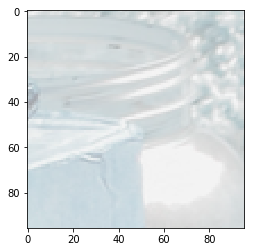

--------------------------------------------------------------------------------------


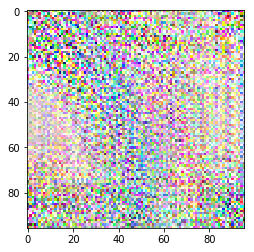

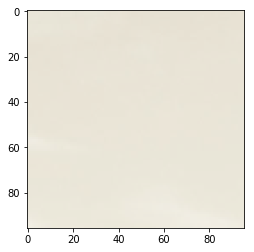

--------------------------------------------------------------------------------------
Epoch 4/50:
Train Loss: 0.4082
Test(Validation) Loss: 0.3687
Training...


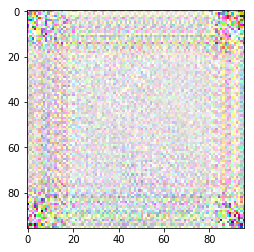

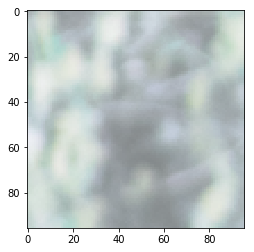

--------------------------------------------------------------------------------------


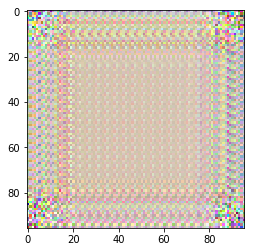

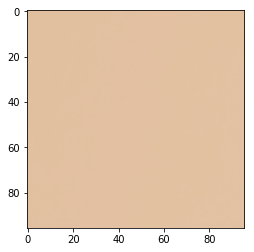

--------------------------------------------------------------------------------------
Testing...


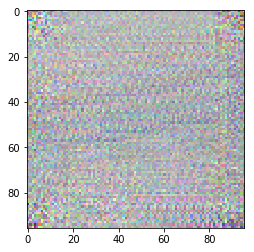

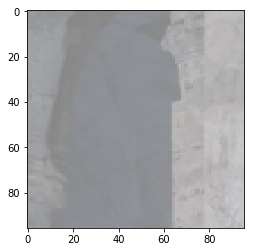

--------------------------------------------------------------------------------------


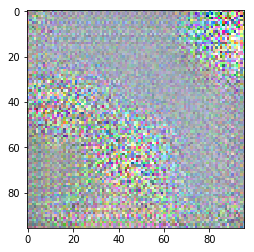

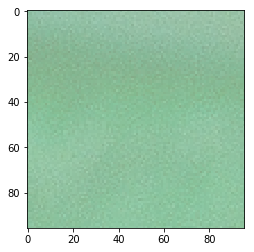

--------------------------------------------------------------------------------------


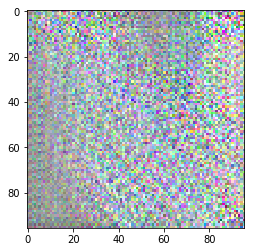

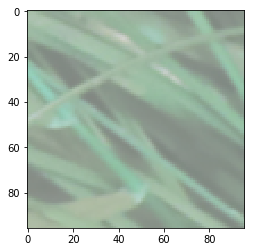

--------------------------------------------------------------------------------------


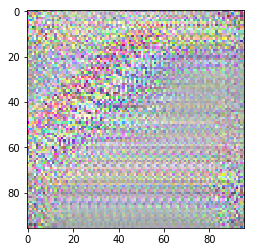

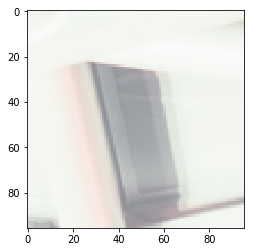

--------------------------------------------------------------------------------------


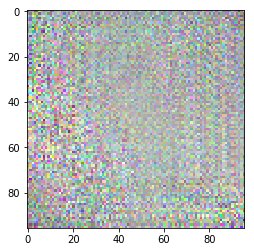

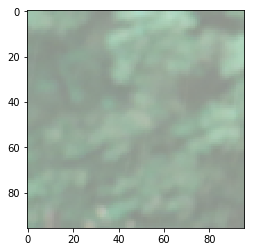

--------------------------------------------------------------------------------------


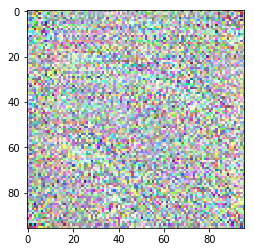

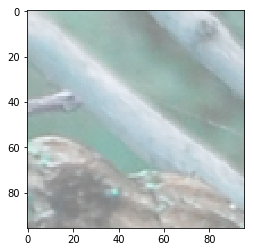

--------------------------------------------------------------------------------------


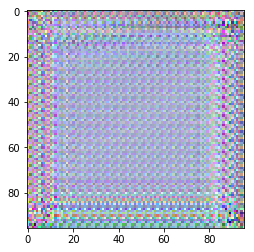

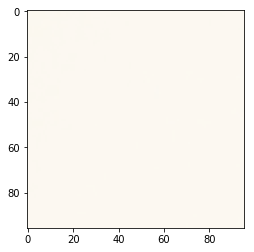

--------------------------------------------------------------------------------------


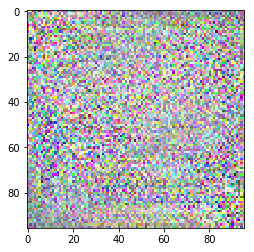

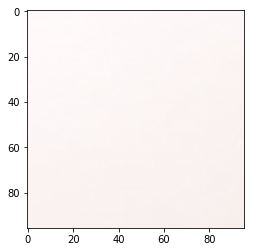

--------------------------------------------------------------------------------------


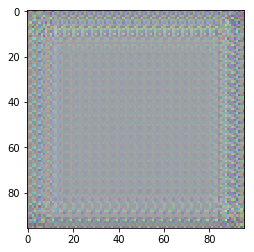

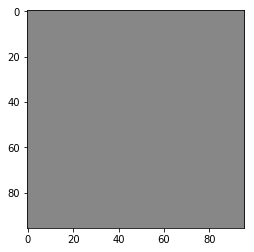

--------------------------------------------------------------------------------------


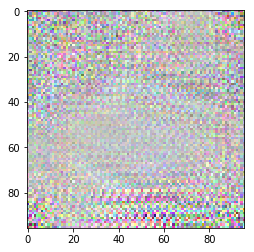

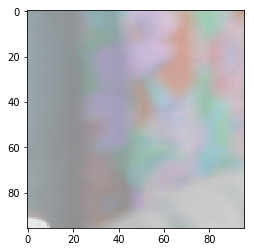

--------------------------------------------------------------------------------------


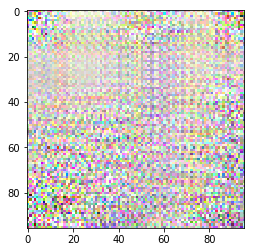

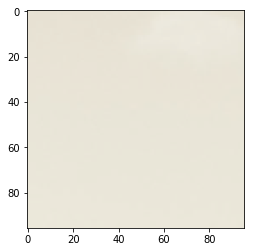

--------------------------------------------------------------------------------------
Epoch 5/50:
Train Loss: 0.3543
Test(Validation) Loss: 0.3311
Training...


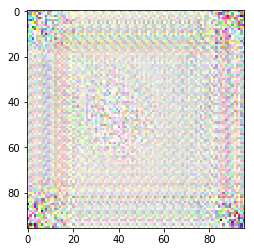

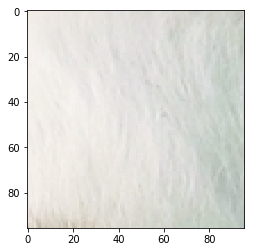

--------------------------------------------------------------------------------------


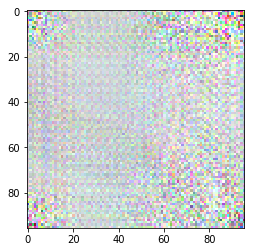

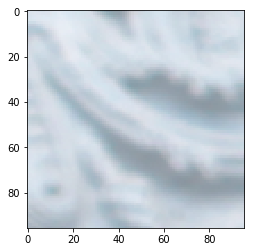

--------------------------------------------------------------------------------------
Testing...


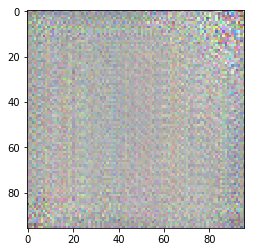

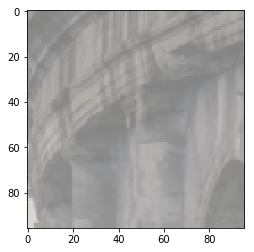

--------------------------------------------------------------------------------------


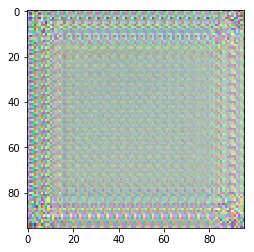

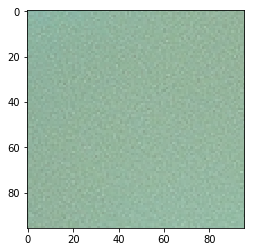

--------------------------------------------------------------------------------------


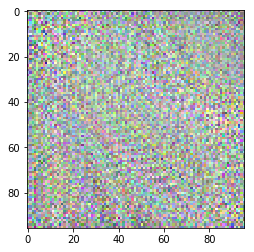

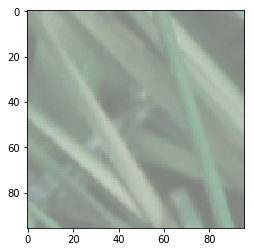

--------------------------------------------------------------------------------------


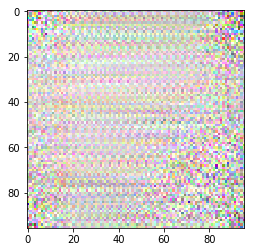

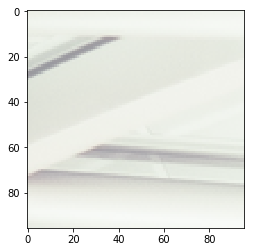

--------------------------------------------------------------------------------------


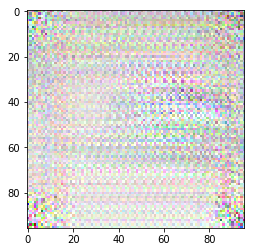

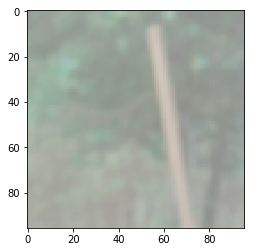

--------------------------------------------------------------------------------------


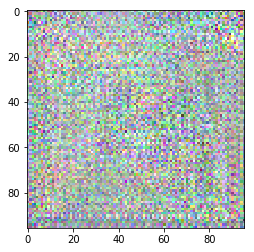

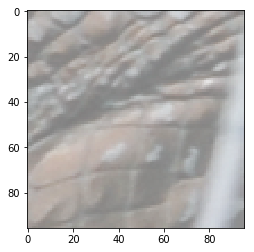

--------------------------------------------------------------------------------------


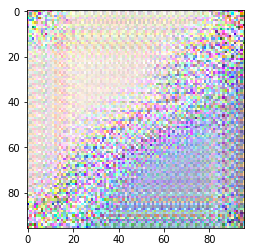

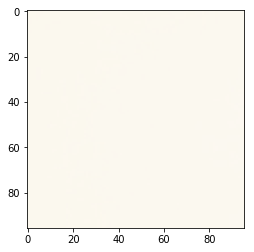

--------------------------------------------------------------------------------------


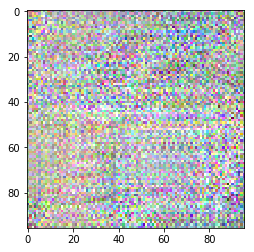

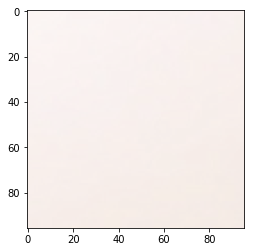

--------------------------------------------------------------------------------------


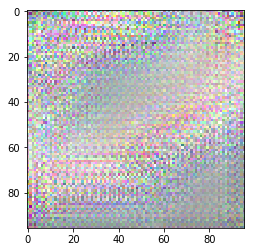

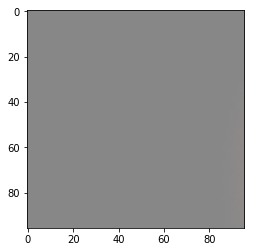

--------------------------------------------------------------------------------------


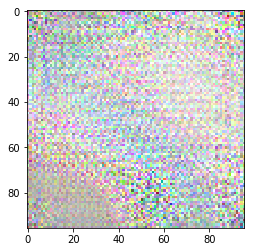

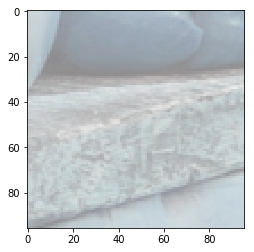

--------------------------------------------------------------------------------------


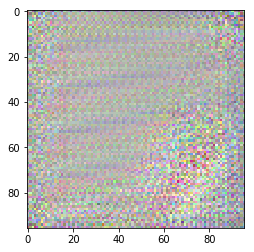

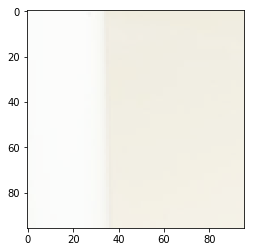

--------------------------------------------------------------------------------------
Epoch 6/50:
Train Loss: 0.3232
Test(Validation) Loss: 0.3021
Training...


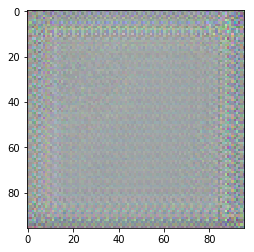

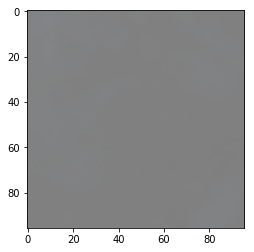

--------------------------------------------------------------------------------------


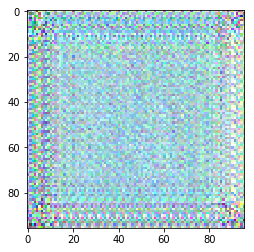

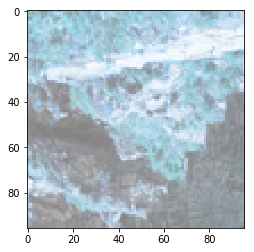

--------------------------------------------------------------------------------------
Testing...


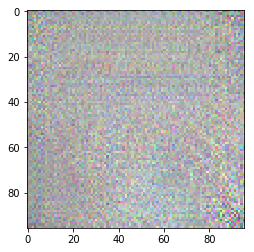

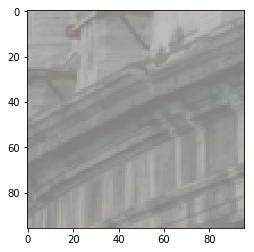

--------------------------------------------------------------------------------------


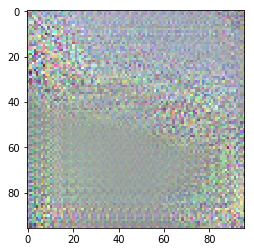

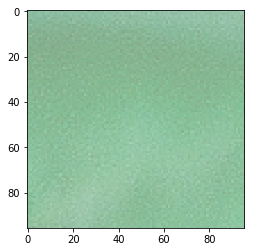

--------------------------------------------------------------------------------------


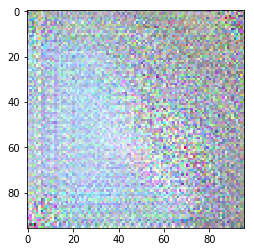

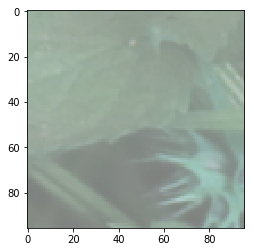

--------------------------------------------------------------------------------------


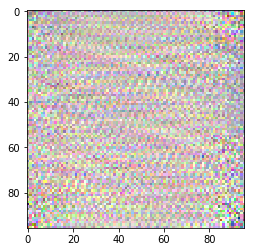

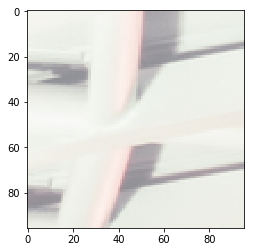

--------------------------------------------------------------------------------------


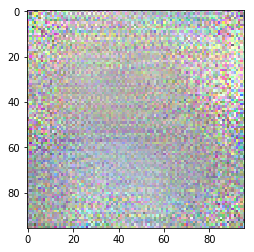

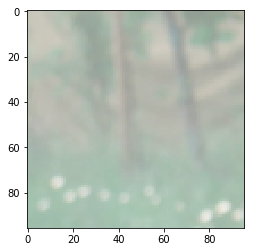

--------------------------------------------------------------------------------------


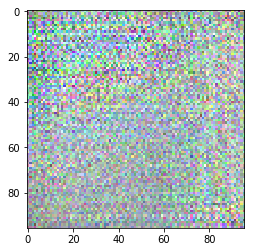

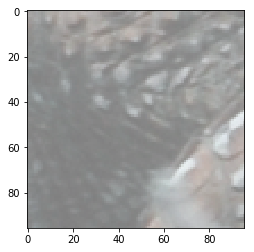

--------------------------------------------------------------------------------------


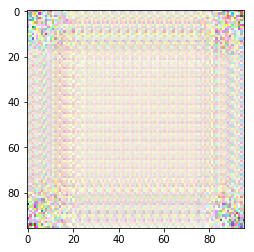

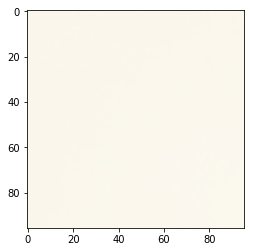

--------------------------------------------------------------------------------------


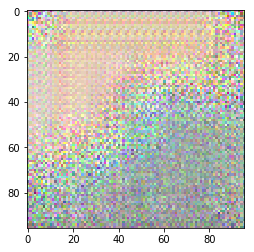

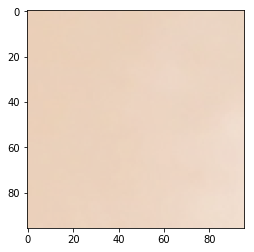

--------------------------------------------------------------------------------------


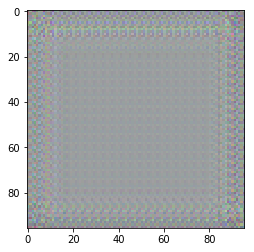

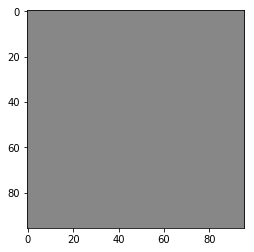

--------------------------------------------------------------------------------------


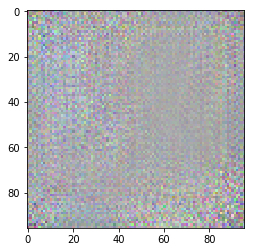

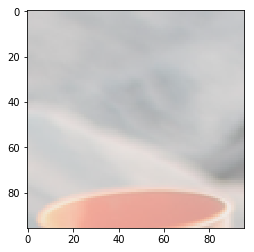

--------------------------------------------------------------------------------------


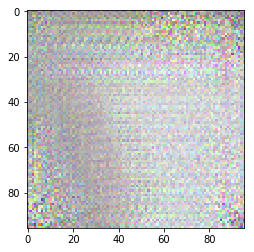

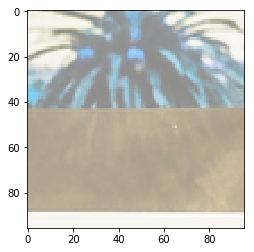

--------------------------------------------------------------------------------------
Epoch 7/50:
Train Loss: 0.2926
Test(Validation) Loss: 0.2897
Training...


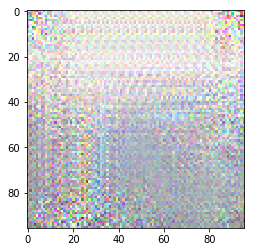

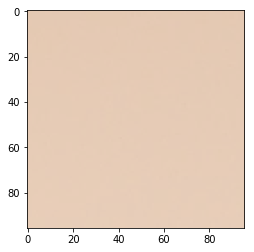

--------------------------------------------------------------------------------------


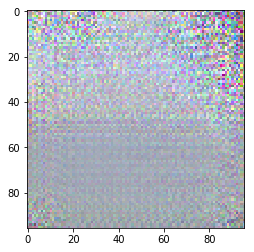

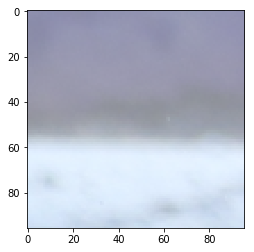

--------------------------------------------------------------------------------------
Testing...


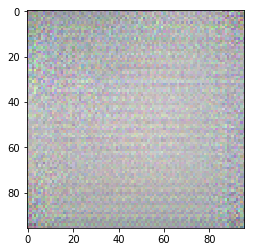

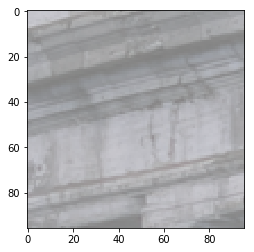

--------------------------------------------------------------------------------------


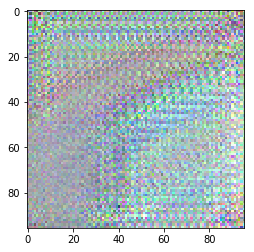

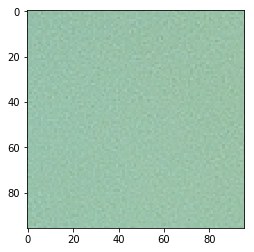

--------------------------------------------------------------------------------------


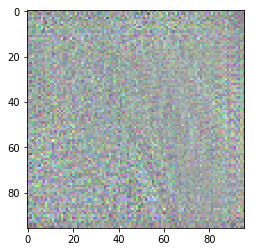

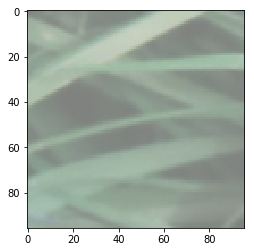

--------------------------------------------------------------------------------------


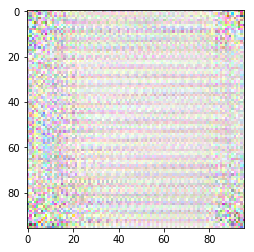

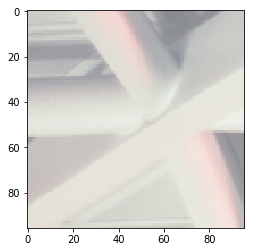

--------------------------------------------------------------------------------------


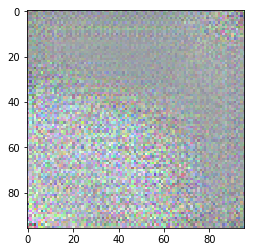

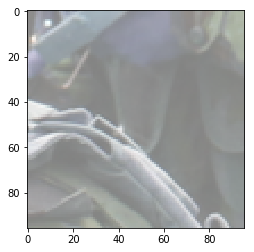

--------------------------------------------------------------------------------------


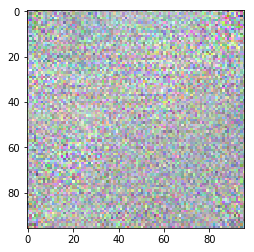

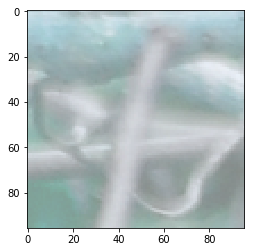

--------------------------------------------------------------------------------------


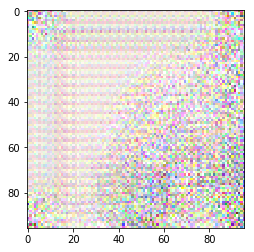

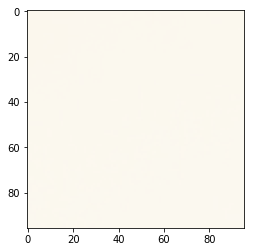

--------------------------------------------------------------------------------------


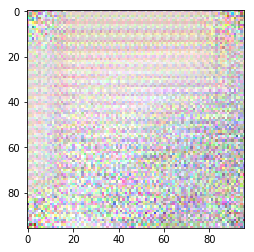

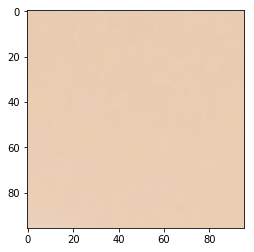

--------------------------------------------------------------------------------------


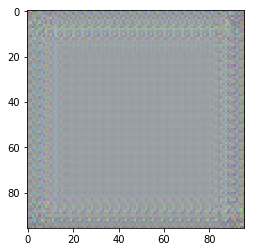

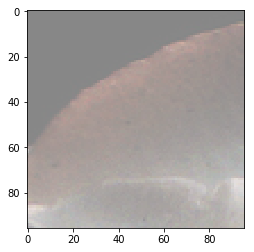

--------------------------------------------------------------------------------------


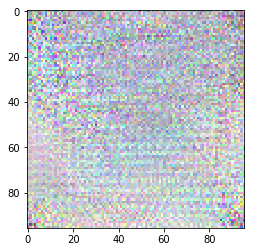

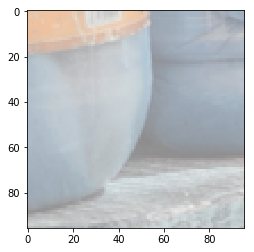

--------------------------------------------------------------------------------------


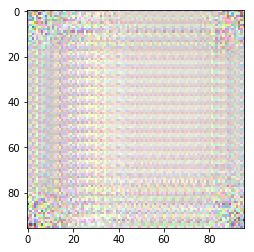

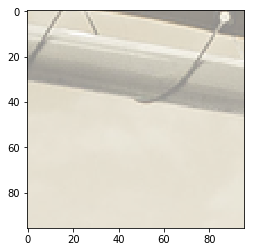

--------------------------------------------------------------------------------------
Epoch 8/50:
Train Loss: 0.2795
Test(Validation) Loss: 0.2667
Training...


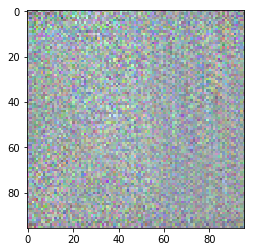

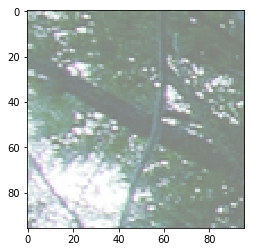

--------------------------------------------------------------------------------------


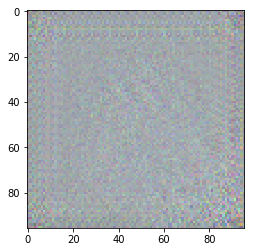

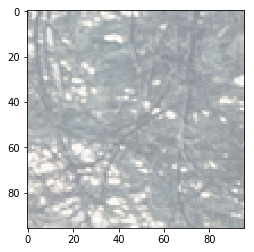

--------------------------------------------------------------------------------------
Testing...


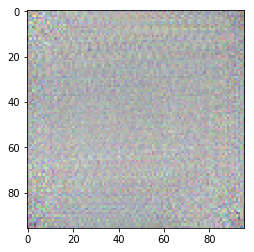

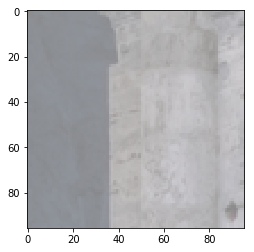

--------------------------------------------------------------------------------------


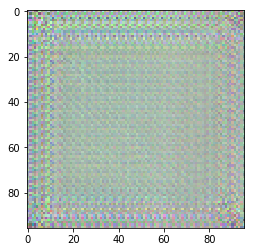

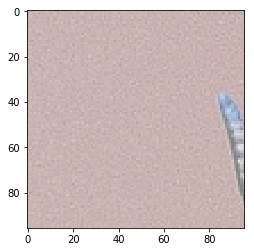

--------------------------------------------------------------------------------------


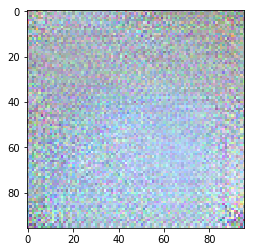

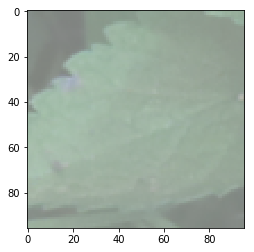

--------------------------------------------------------------------------------------


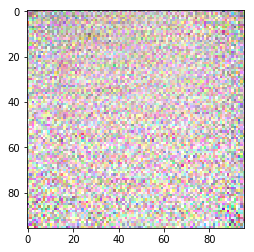

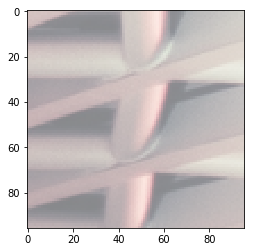

--------------------------------------------------------------------------------------


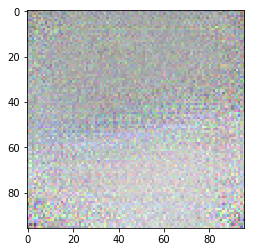

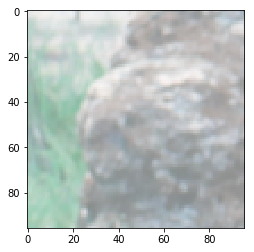

--------------------------------------------------------------------------------------


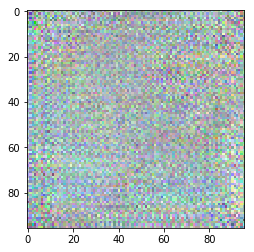

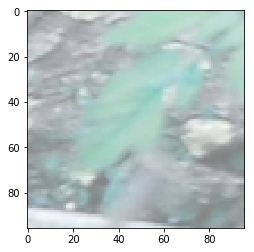

--------------------------------------------------------------------------------------


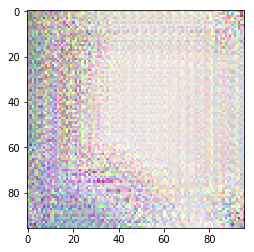

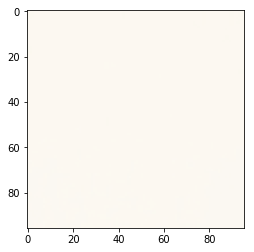

--------------------------------------------------------------------------------------


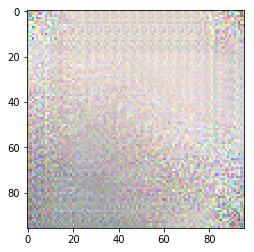

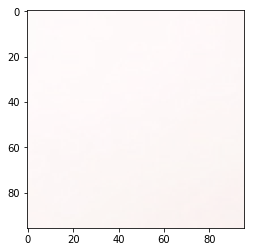

--------------------------------------------------------------------------------------


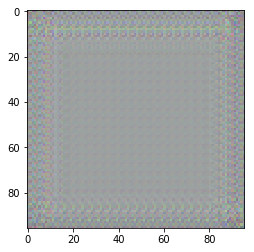

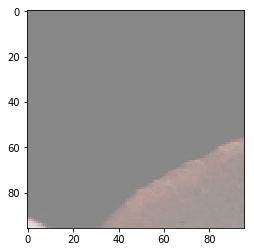

--------------------------------------------------------------------------------------


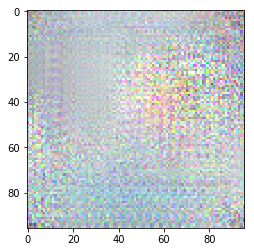

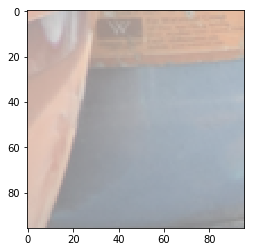

--------------------------------------------------------------------------------------


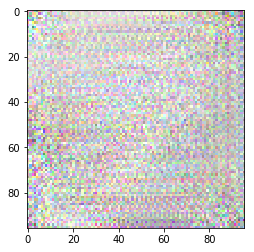

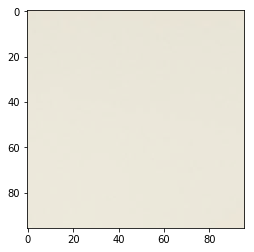

--------------------------------------------------------------------------------------
Epoch 9/50:
Train Loss: 0.2670
Test(Validation) Loss: 0.2672
Training...


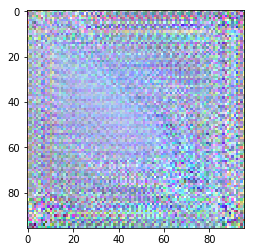

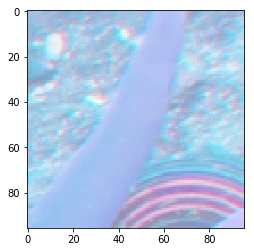

--------------------------------------------------------------------------------------


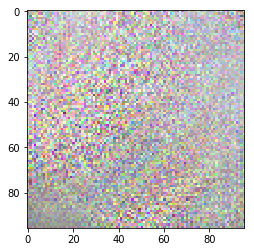

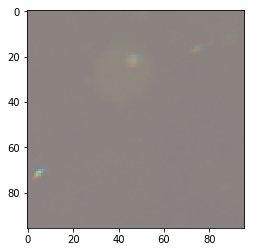

--------------------------------------------------------------------------------------
Testing...


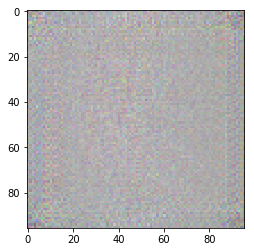

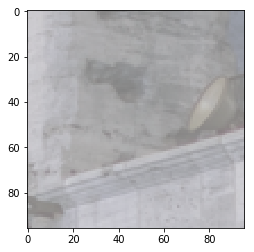

--------------------------------------------------------------------------------------


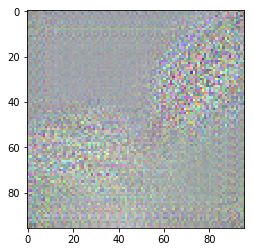

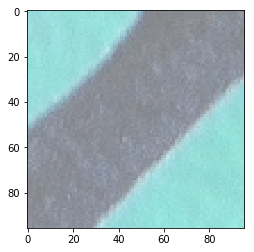

--------------------------------------------------------------------------------------


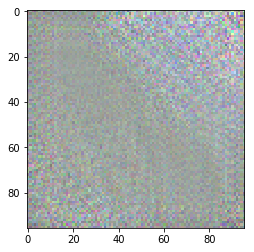

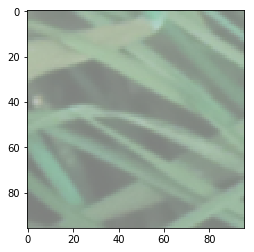

--------------------------------------------------------------------------------------


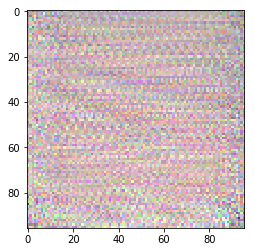

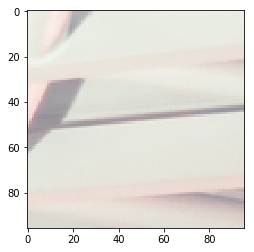

--------------------------------------------------------------------------------------


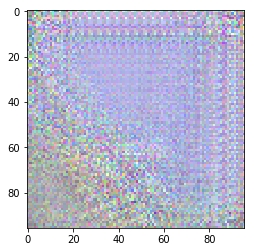

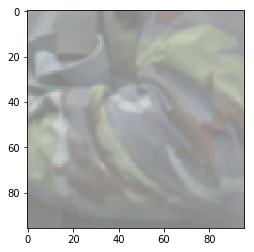

--------------------------------------------------------------------------------------


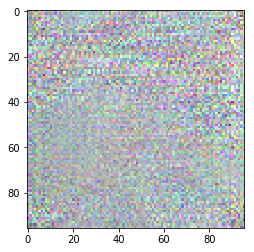

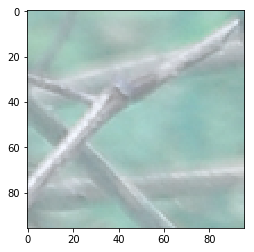

--------------------------------------------------------------------------------------


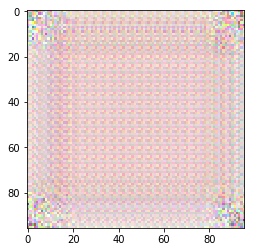

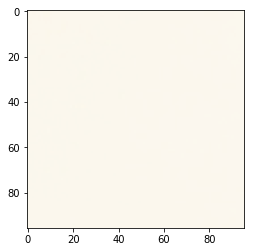

--------------------------------------------------------------------------------------


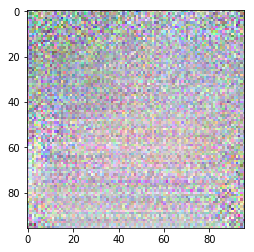

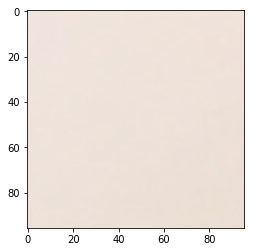

--------------------------------------------------------------------------------------


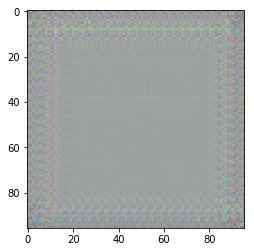

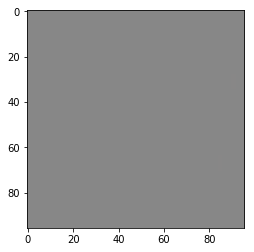

--------------------------------------------------------------------------------------


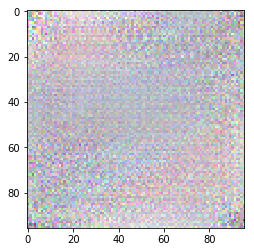

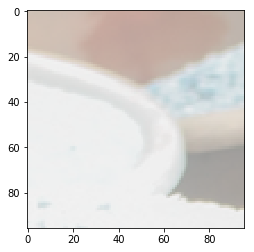

--------------------------------------------------------------------------------------


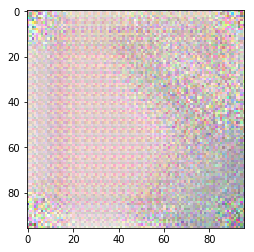

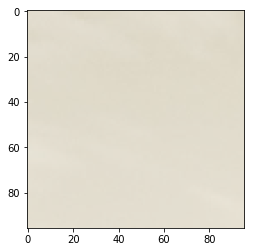

--------------------------------------------------------------------------------------
Epoch 10/50:
Train Loss: 0.2613
Test(Validation) Loss: 0.2551
[10 / 50] 	Learning_rate: 0.0001	 train_loss: 0.2613	 test_loss: 0.2551


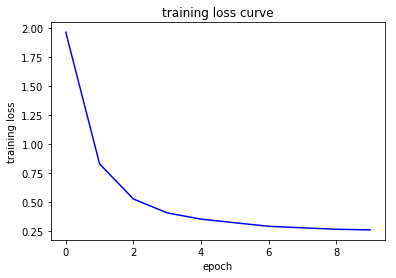

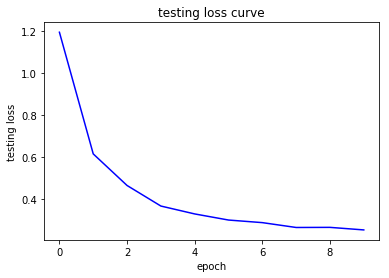

Training...


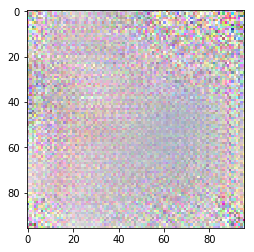

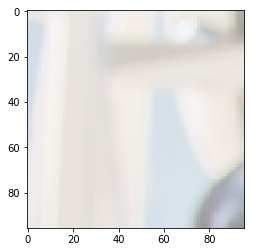

--------------------------------------------------------------------------------------


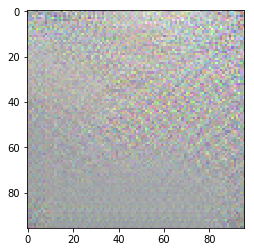

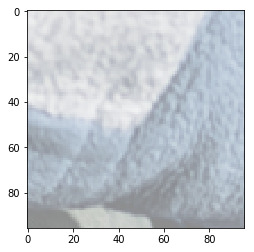

--------------------------------------------------------------------------------------
Testing...


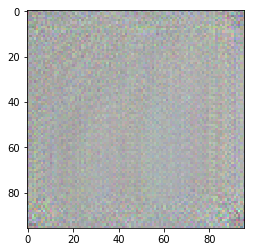

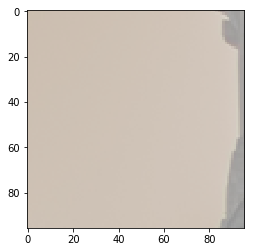

--------------------------------------------------------------------------------------


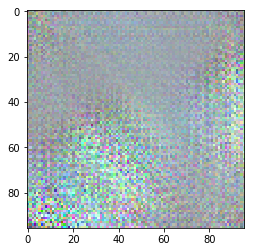

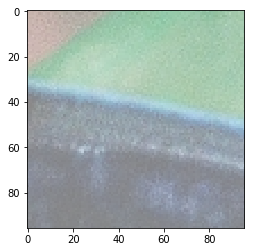

--------------------------------------------------------------------------------------


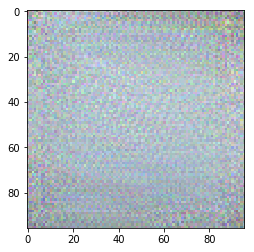

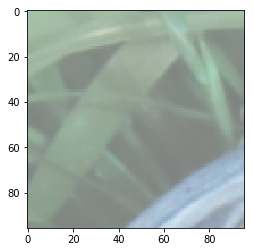

--------------------------------------------------------------------------------------


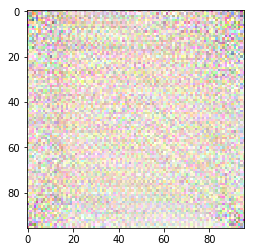

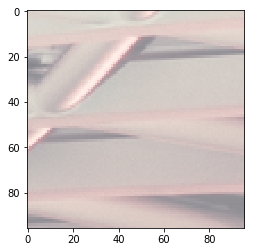

--------------------------------------------------------------------------------------


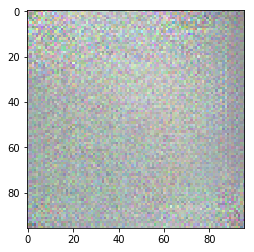

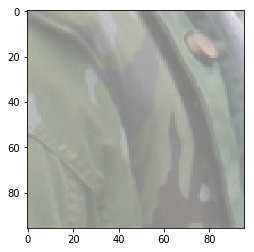

--------------------------------------------------------------------------------------


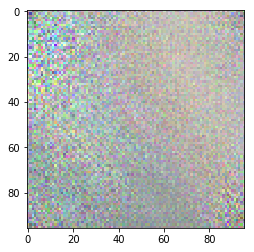

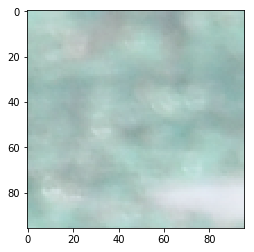

--------------------------------------------------------------------------------------


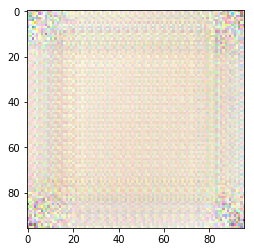

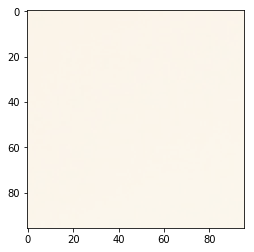

--------------------------------------------------------------------------------------


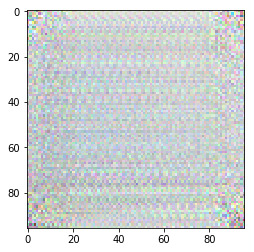

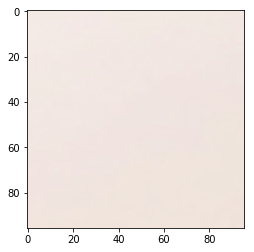

--------------------------------------------------------------------------------------


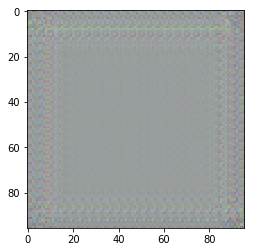

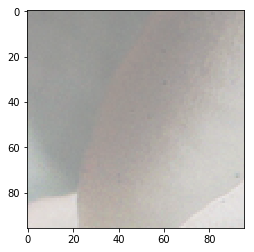

--------------------------------------------------------------------------------------


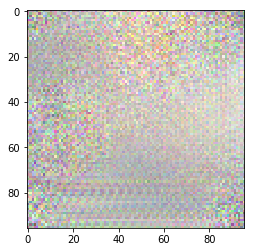

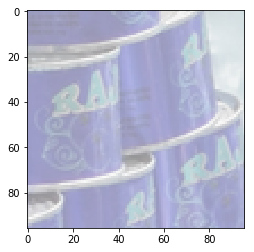

--------------------------------------------------------------------------------------


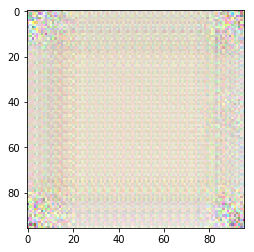

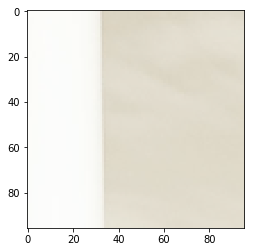

--------------------------------------------------------------------------------------
Epoch 11/50:
Train Loss: 0.2541
Test(Validation) Loss: 0.2464
Training...


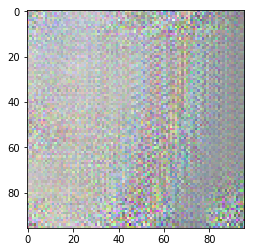

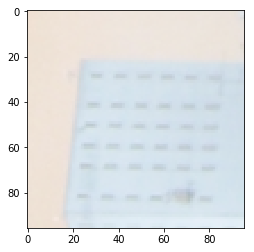

--------------------------------------------------------------------------------------


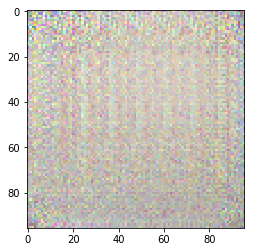

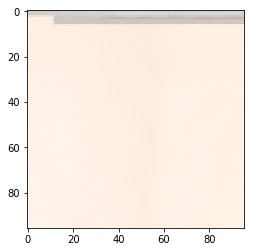

--------------------------------------------------------------------------------------
Testing...


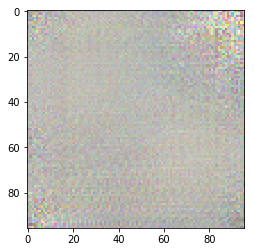

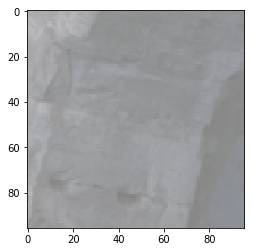

--------------------------------------------------------------------------------------


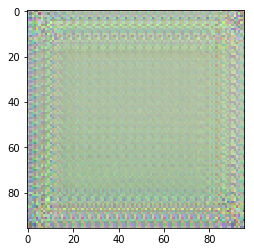

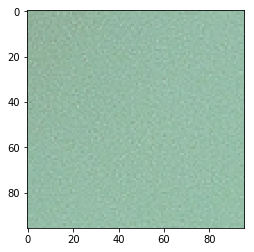

--------------------------------------------------------------------------------------


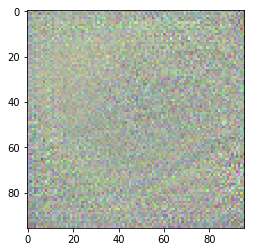

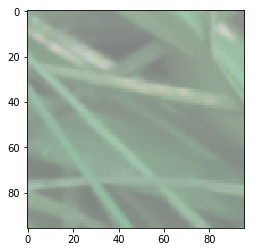

--------------------------------------------------------------------------------------


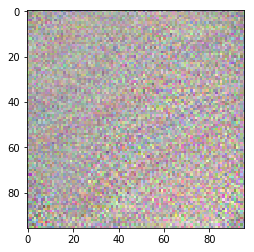

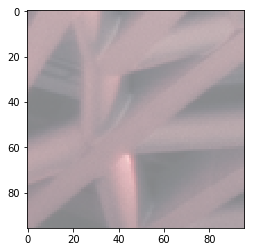

--------------------------------------------------------------------------------------


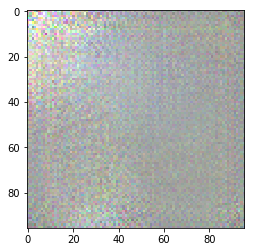

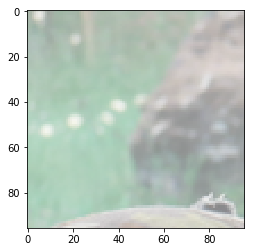

--------------------------------------------------------------------------------------


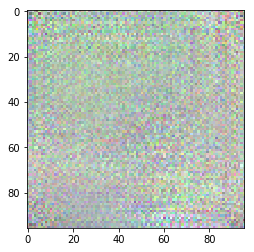

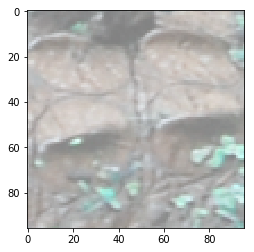

--------------------------------------------------------------------------------------


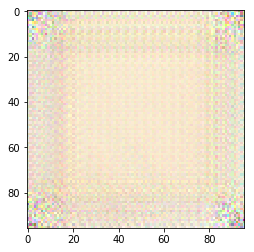

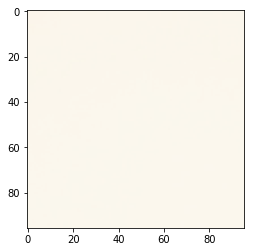

--------------------------------------------------------------------------------------


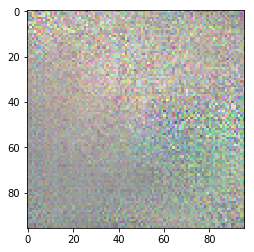

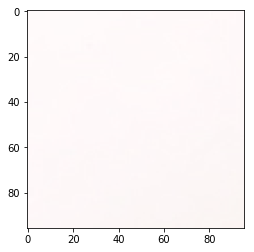

--------------------------------------------------------------------------------------


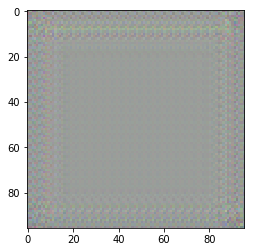

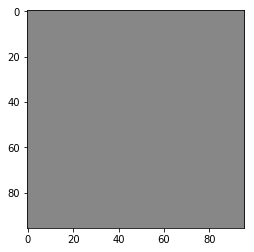

--------------------------------------------------------------------------------------


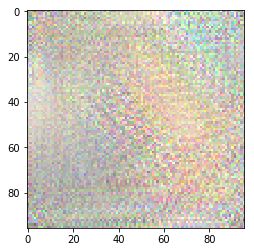

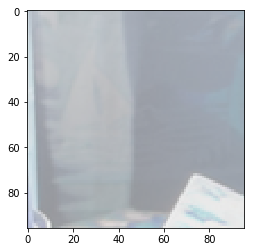

--------------------------------------------------------------------------------------


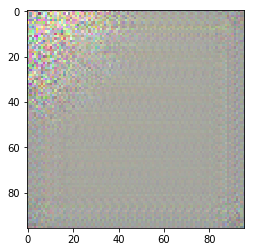

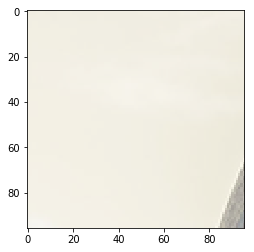

--------------------------------------------------------------------------------------
Epoch 12/50:
Train Loss: 0.2502
Test(Validation) Loss: 0.2495
Training...


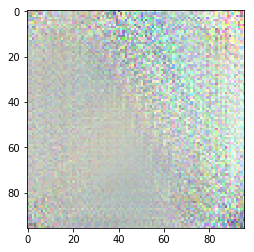

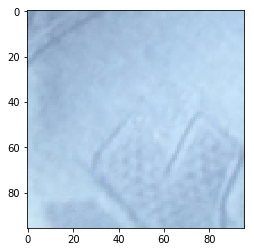

--------------------------------------------------------------------------------------


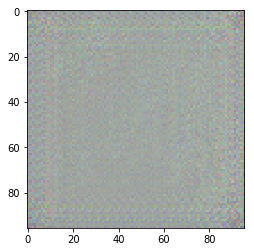

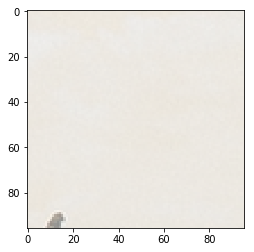

--------------------------------------------------------------------------------------
Testing...


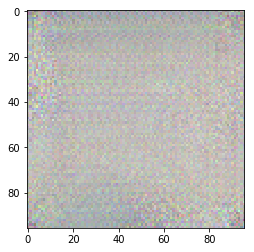

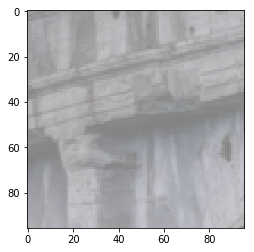

--------------------------------------------------------------------------------------


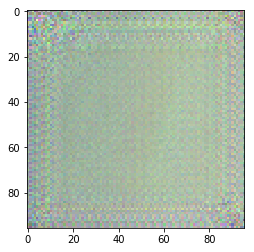

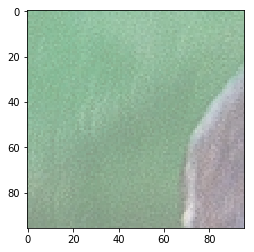

--------------------------------------------------------------------------------------


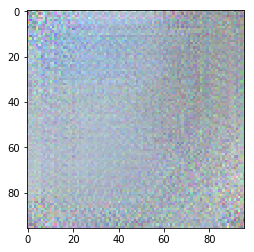

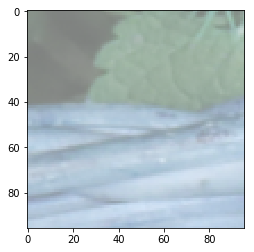

--------------------------------------------------------------------------------------


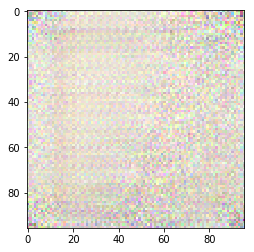

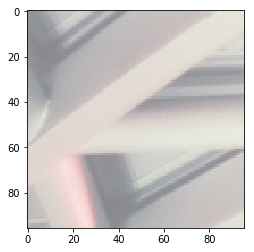

--------------------------------------------------------------------------------------


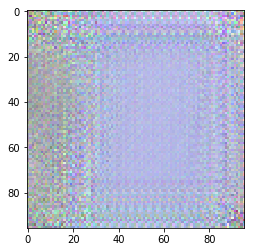

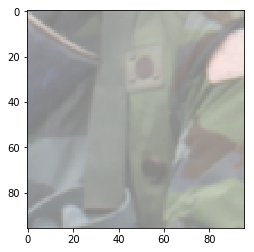

--------------------------------------------------------------------------------------


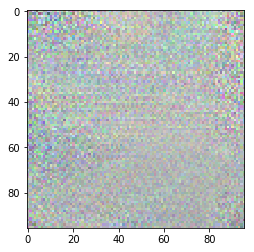

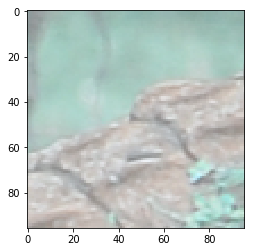

--------------------------------------------------------------------------------------


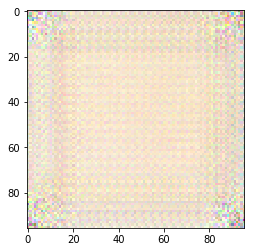

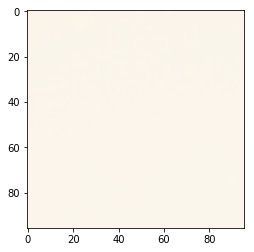

--------------------------------------------------------------------------------------


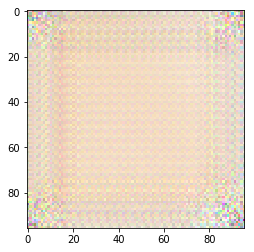

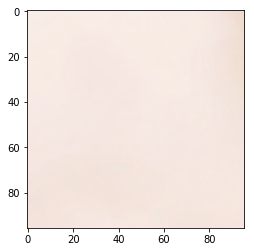

--------------------------------------------------------------------------------------


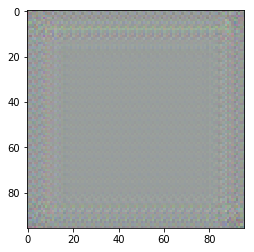

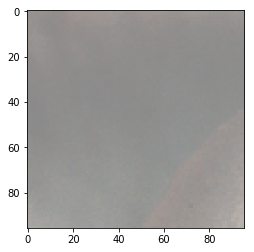

--------------------------------------------------------------------------------------


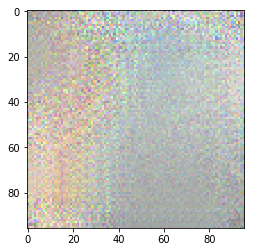

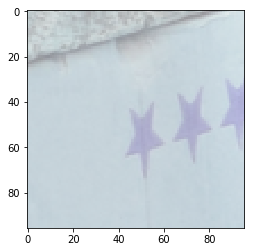

--------------------------------------------------------------------------------------


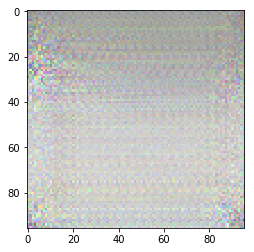

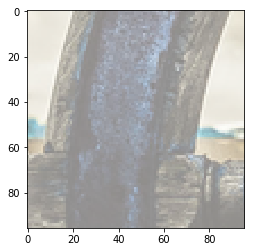

--------------------------------------------------------------------------------------
Epoch 13/50:
Train Loss: 0.2489
Test(Validation) Loss: 0.2478
Training...


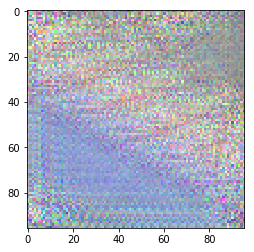

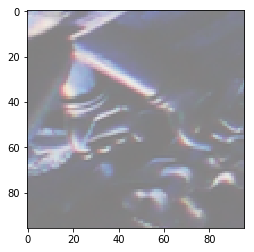

--------------------------------------------------------------------------------------


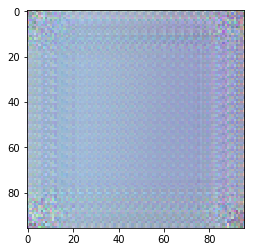

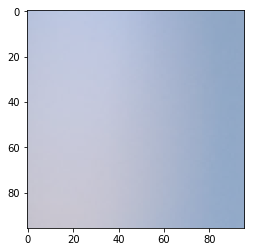

--------------------------------------------------------------------------------------
Testing...


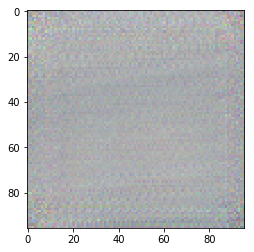

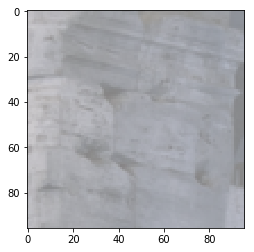

--------------------------------------------------------------------------------------


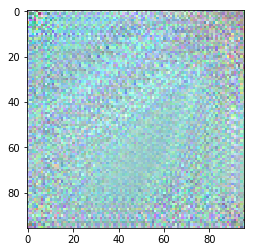

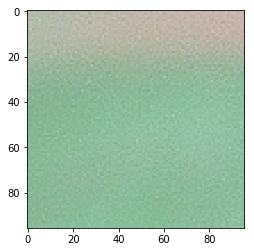

--------------------------------------------------------------------------------------


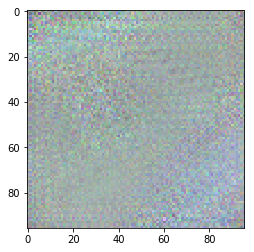

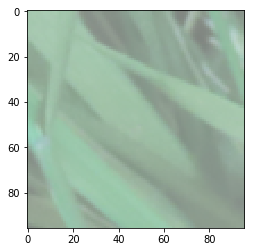

--------------------------------------------------------------------------------------


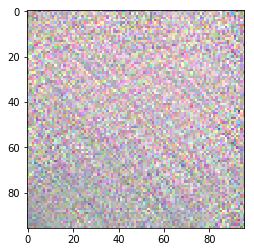

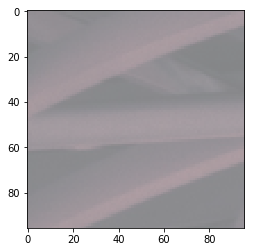

--------------------------------------------------------------------------------------


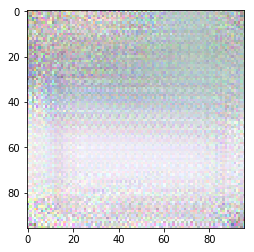

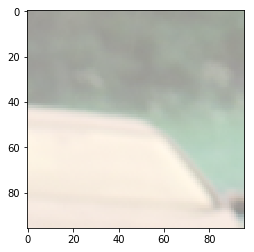

--------------------------------------------------------------------------------------


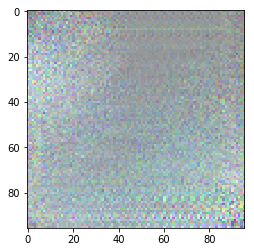

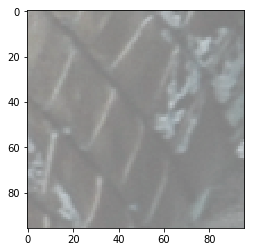

--------------------------------------------------------------------------------------


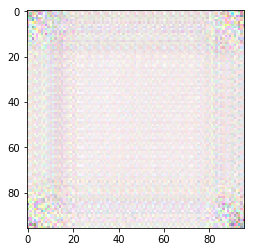

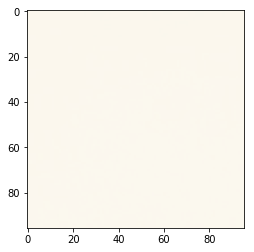

--------------------------------------------------------------------------------------


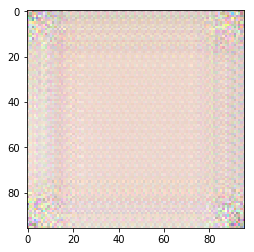

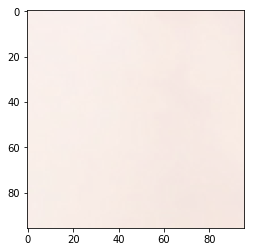

--------------------------------------------------------------------------------------


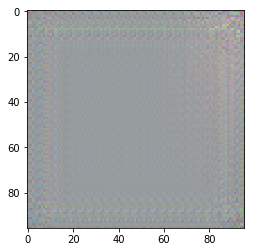

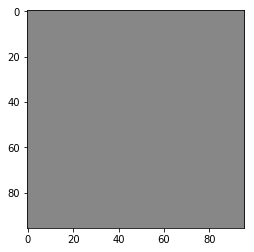

--------------------------------------------------------------------------------------


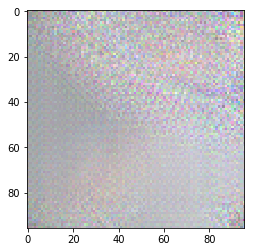

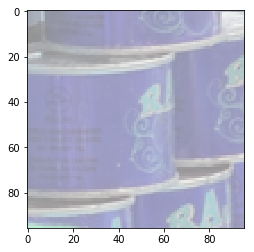

--------------------------------------------------------------------------------------


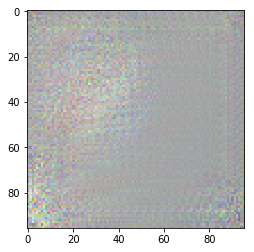

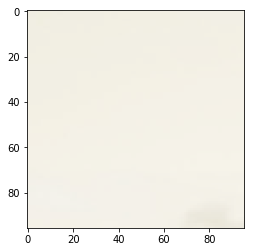

--------------------------------------------------------------------------------------
Epoch 14/50:
Train Loss: 0.2432
Test(Validation) Loss: 0.2423
Training...


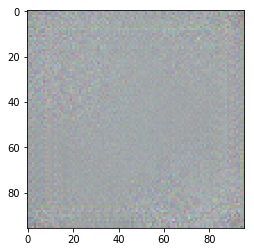

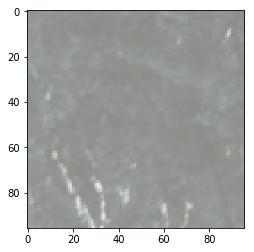

--------------------------------------------------------------------------------------


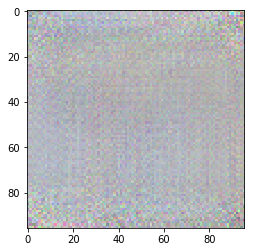

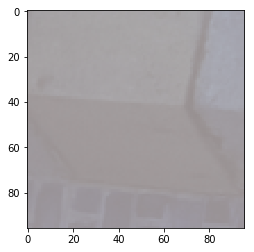

--------------------------------------------------------------------------------------
Testing...


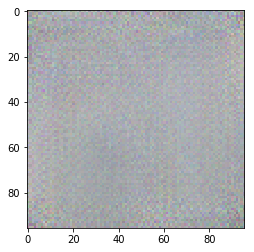

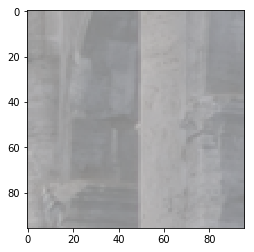

--------------------------------------------------------------------------------------


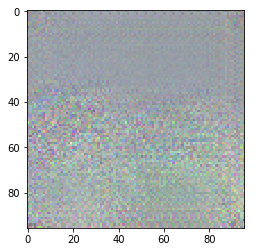

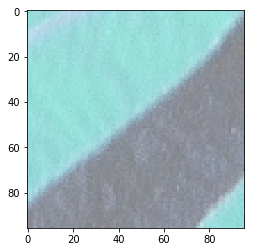

--------------------------------------------------------------------------------------


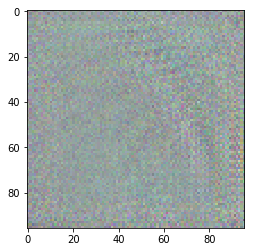

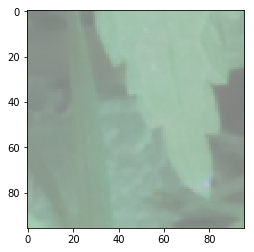

--------------------------------------------------------------------------------------


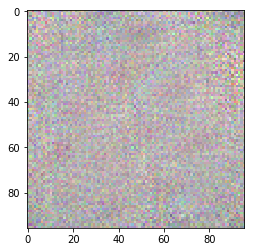

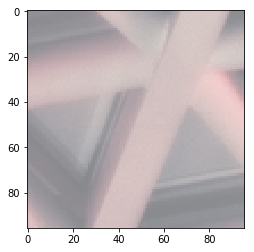

--------------------------------------------------------------------------------------


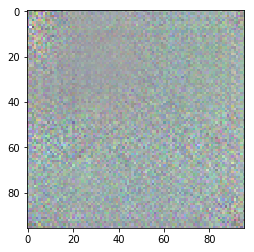

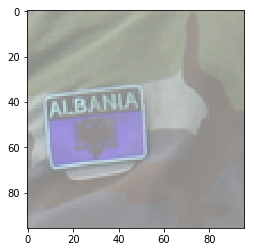

--------------------------------------------------------------------------------------


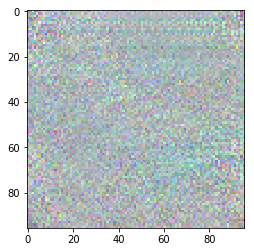

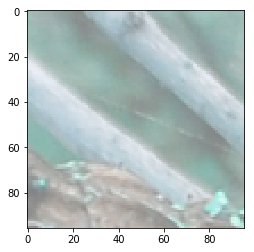

--------------------------------------------------------------------------------------


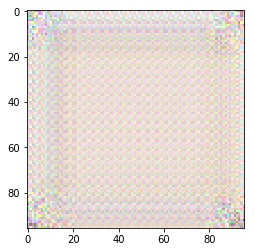

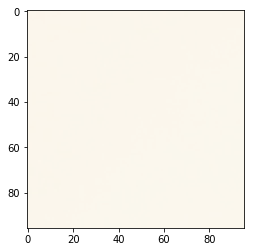

--------------------------------------------------------------------------------------


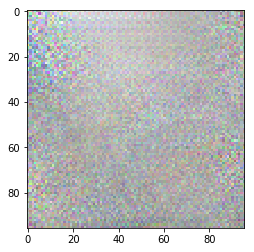

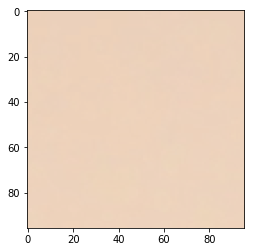

--------------------------------------------------------------------------------------


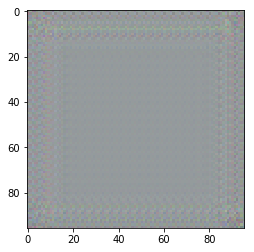

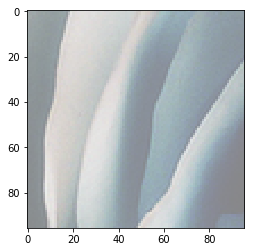

--------------------------------------------------------------------------------------


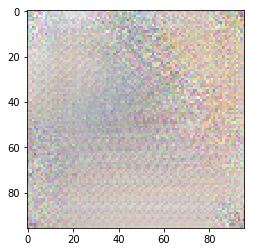

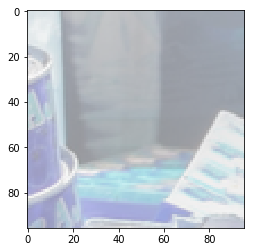

--------------------------------------------------------------------------------------


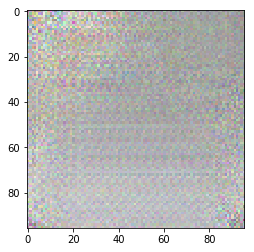

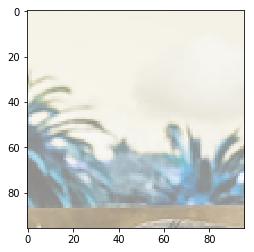

--------------------------------------------------------------------------------------
Epoch 15/50:
Train Loss: 0.2412
Test(Validation) Loss: 0.2167
Training...


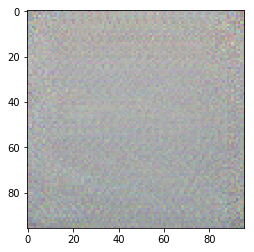

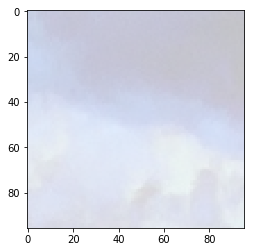

--------------------------------------------------------------------------------------


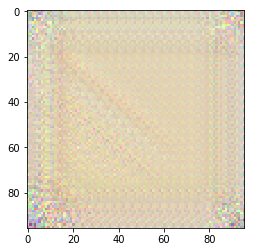

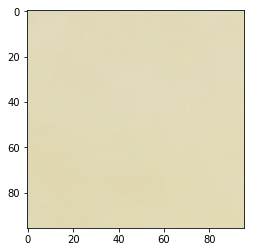

--------------------------------------------------------------------------------------
Testing...


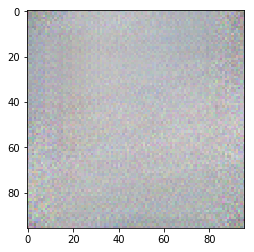

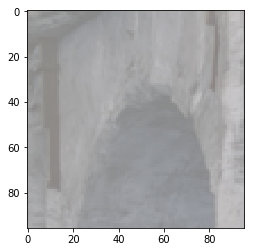

--------------------------------------------------------------------------------------


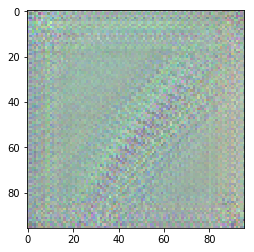

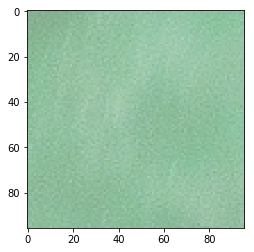

--------------------------------------------------------------------------------------


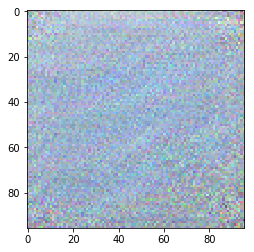

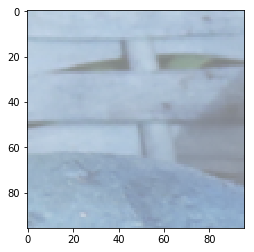

--------------------------------------------------------------------------------------


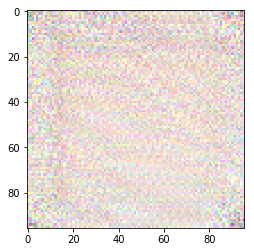

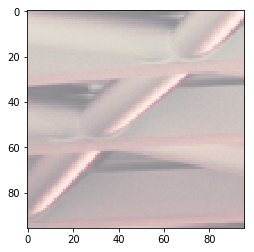

--------------------------------------------------------------------------------------


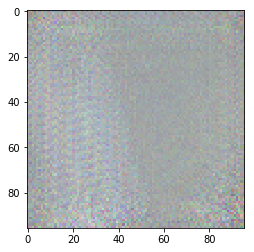

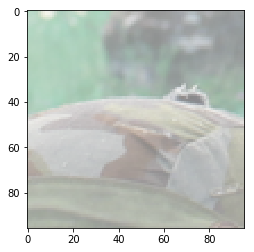

--------------------------------------------------------------------------------------


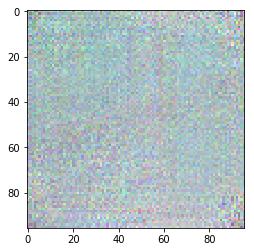

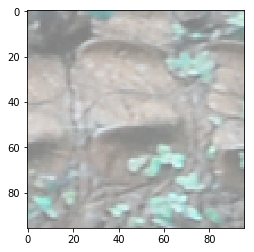

--------------------------------------------------------------------------------------


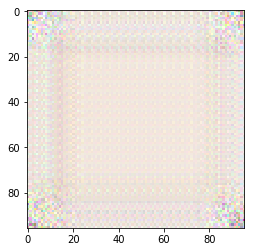

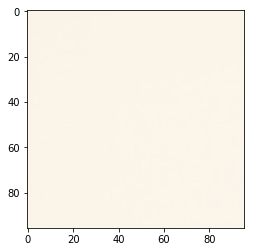

--------------------------------------------------------------------------------------


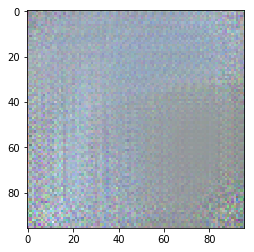

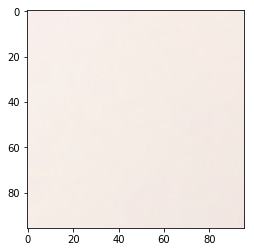

--------------------------------------------------------------------------------------


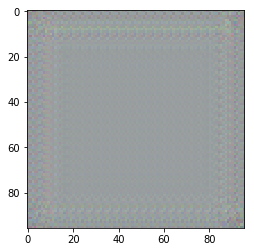

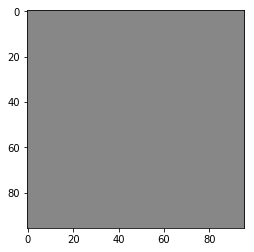

--------------------------------------------------------------------------------------


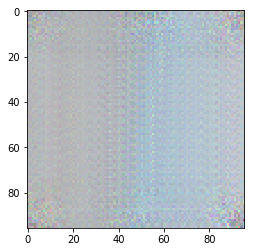

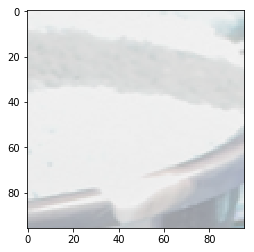

--------------------------------------------------------------------------------------


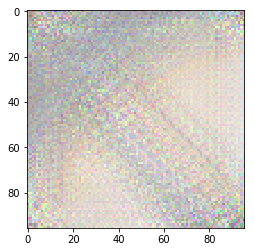

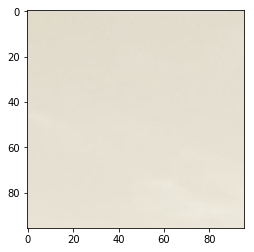

--------------------------------------------------------------------------------------
Epoch 16/50:
Train Loss: 0.2386
Test(Validation) Loss: 0.2190
Training...


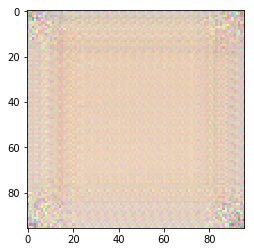

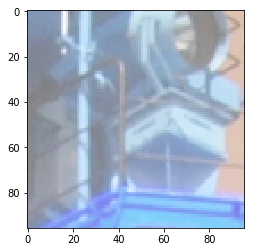

--------------------------------------------------------------------------------------


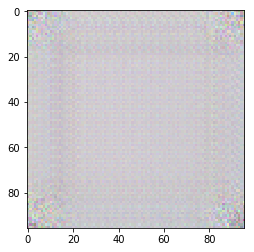

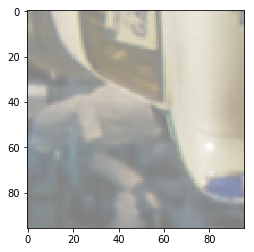

--------------------------------------------------------------------------------------
Testing...


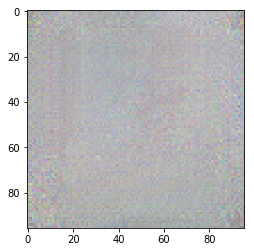

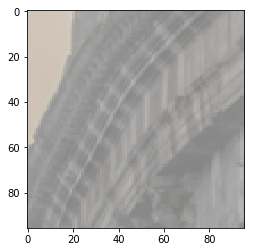

--------------------------------------------------------------------------------------


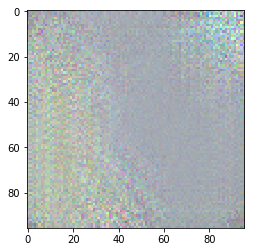

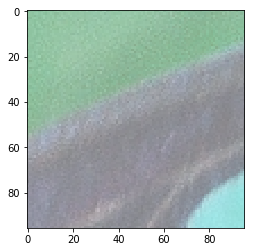

--------------------------------------------------------------------------------------


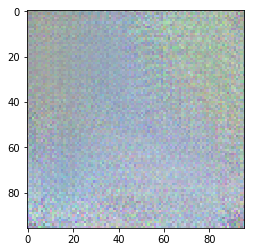

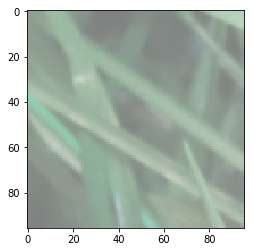

--------------------------------------------------------------------------------------


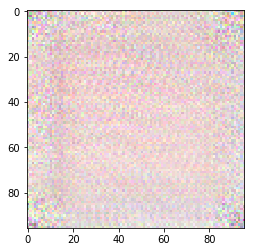

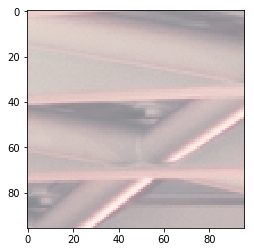

--------------------------------------------------------------------------------------


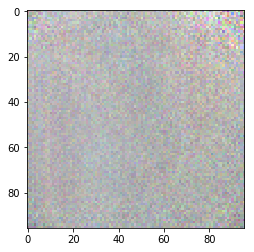

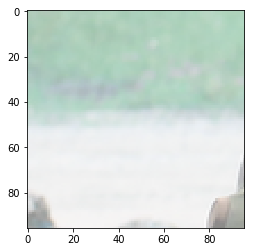

--------------------------------------------------------------------------------------


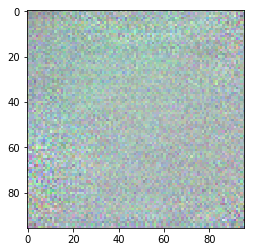

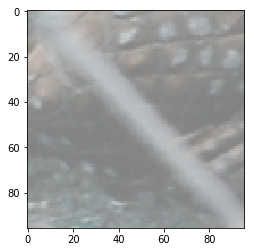

--------------------------------------------------------------------------------------


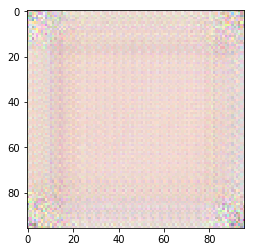

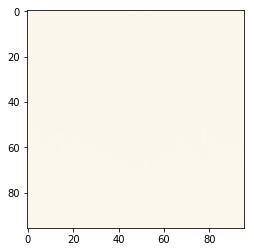

--------------------------------------------------------------------------------------


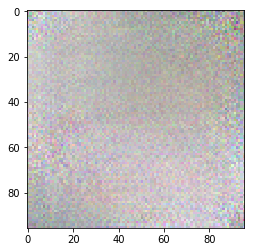

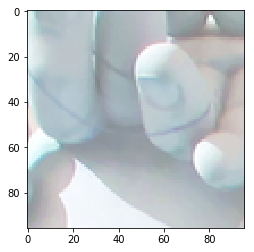

--------------------------------------------------------------------------------------


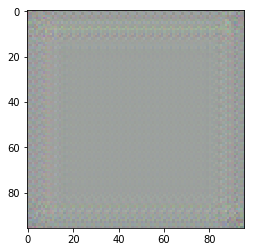

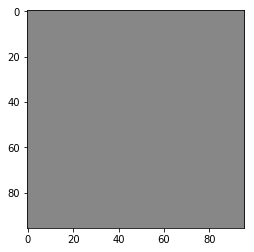

--------------------------------------------------------------------------------------


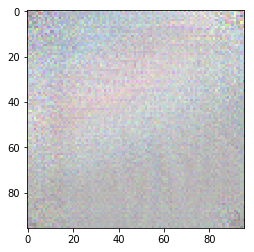

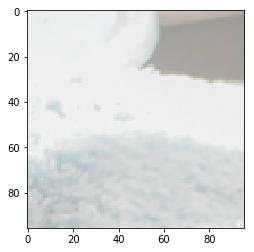

--------------------------------------------------------------------------------------


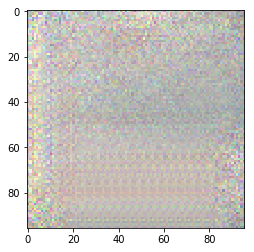

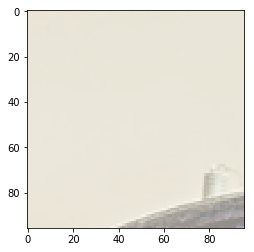

--------------------------------------------------------------------------------------
Epoch 17/50:
Train Loss: 0.2381
Test(Validation) Loss: 0.2294
Training...


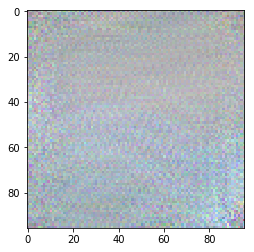

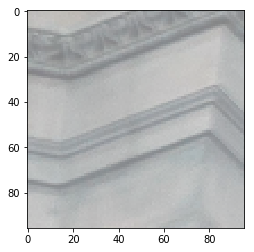

--------------------------------------------------------------------------------------


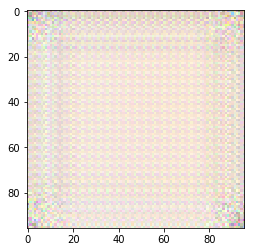

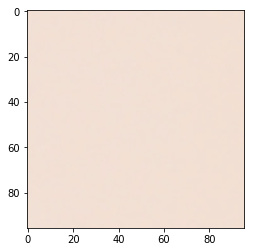

--------------------------------------------------------------------------------------
Testing...


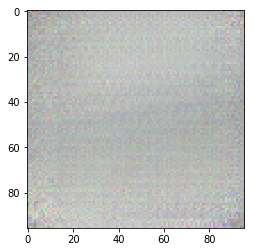

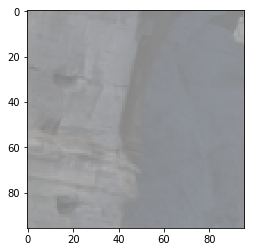

--------------------------------------------------------------------------------------


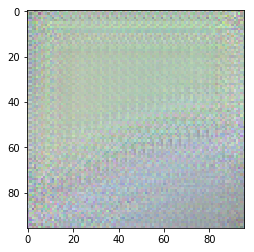

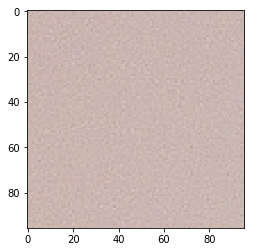

--------------------------------------------------------------------------------------


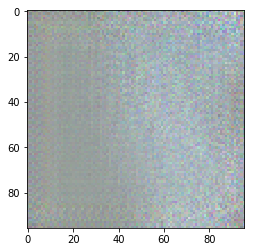

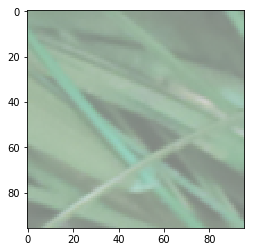

--------------------------------------------------------------------------------------


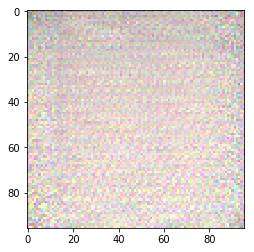

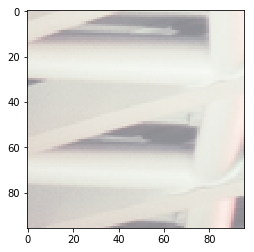

--------------------------------------------------------------------------------------


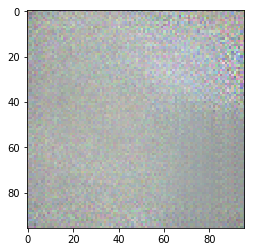

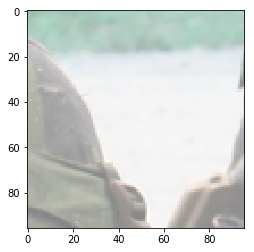

--------------------------------------------------------------------------------------


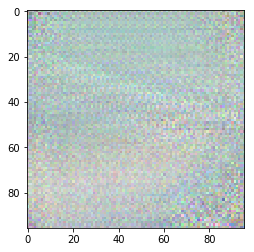

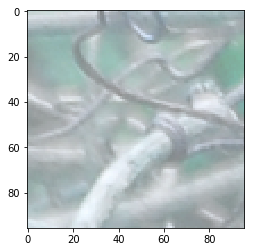

--------------------------------------------------------------------------------------


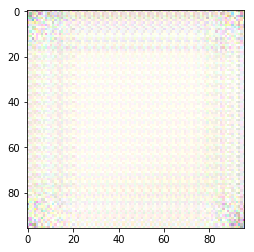

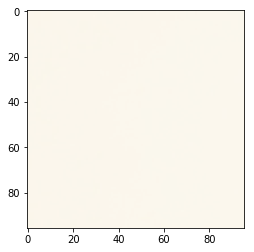

--------------------------------------------------------------------------------------


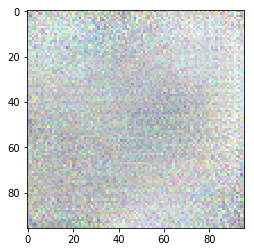

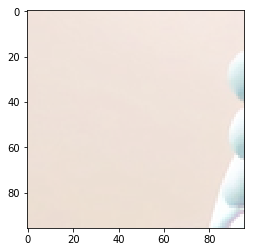

--------------------------------------------------------------------------------------


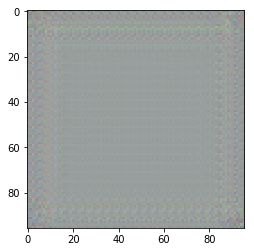

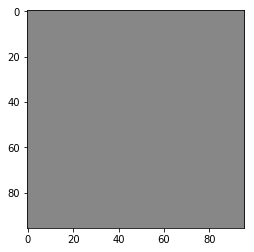

--------------------------------------------------------------------------------------


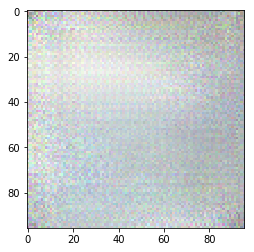

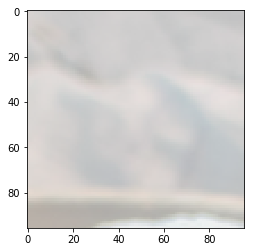

--------------------------------------------------------------------------------------


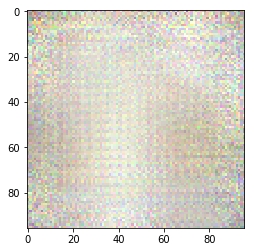

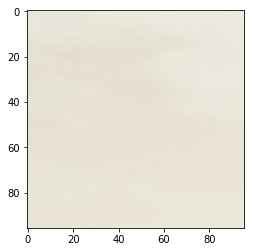

--------------------------------------------------------------------------------------
Epoch 18/50:
Train Loss: 0.2375
Test(Validation) Loss: 0.2462
Training...


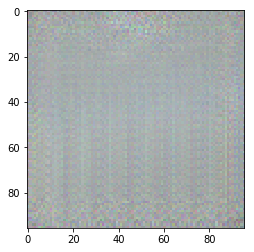

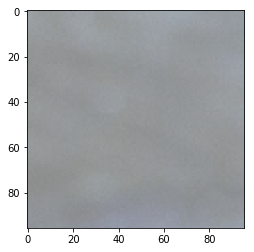

--------------------------------------------------------------------------------------


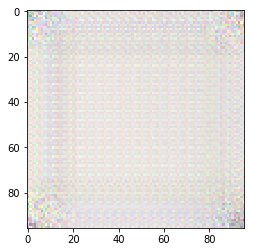

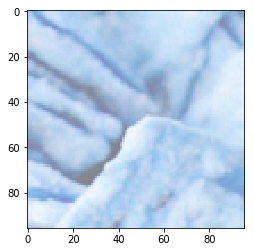

--------------------------------------------------------------------------------------
Testing...


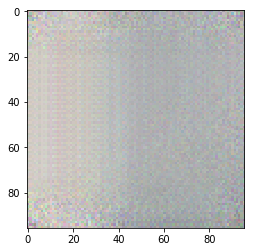

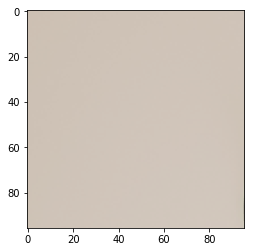

--------------------------------------------------------------------------------------


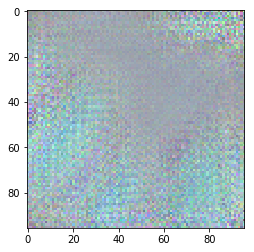

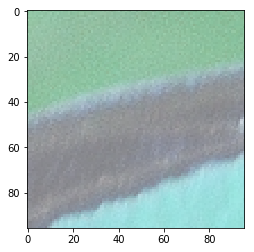

--------------------------------------------------------------------------------------


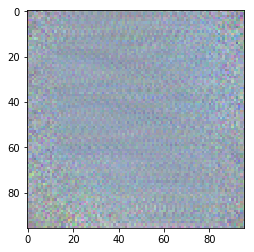

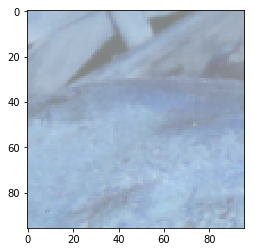

--------------------------------------------------------------------------------------


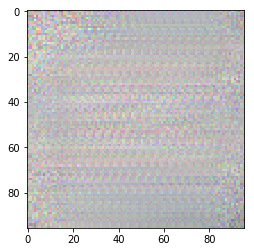

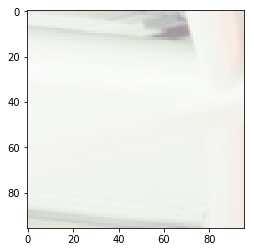

--------------------------------------------------------------------------------------


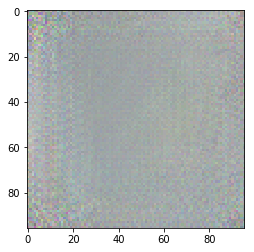

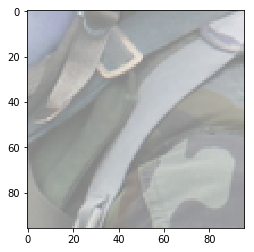

--------------------------------------------------------------------------------------


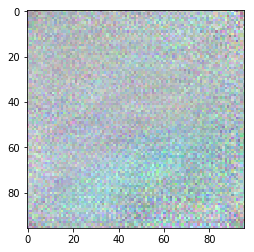

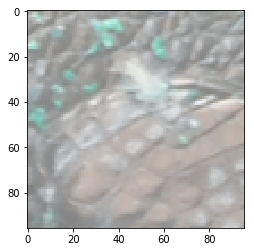

--------------------------------------------------------------------------------------


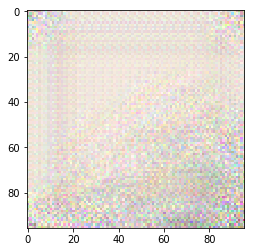

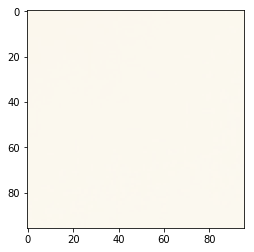

--------------------------------------------------------------------------------------


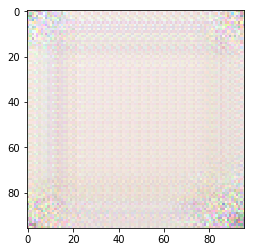

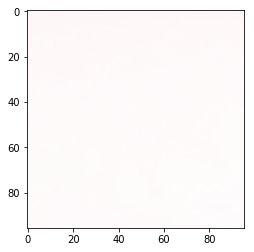

--------------------------------------------------------------------------------------


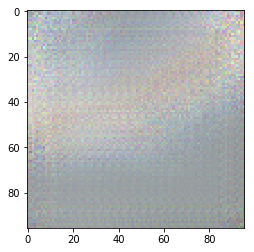

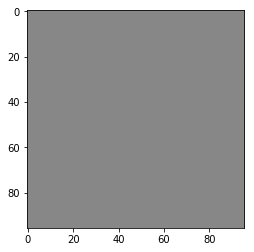

--------------------------------------------------------------------------------------


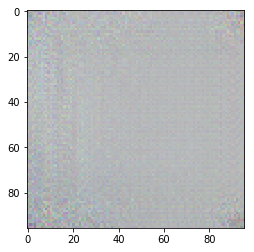

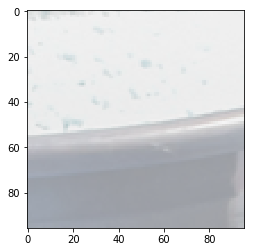

--------------------------------------------------------------------------------------


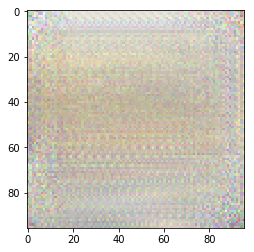

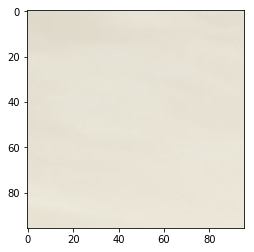

--------------------------------------------------------------------------------------
Epoch 19/50:
Train Loss: 0.2349
Test(Validation) Loss: 0.2146
Training...


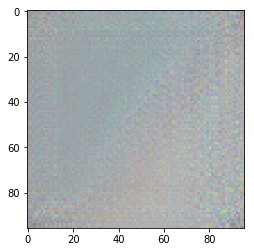

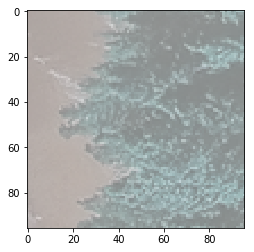

--------------------------------------------------------------------------------------


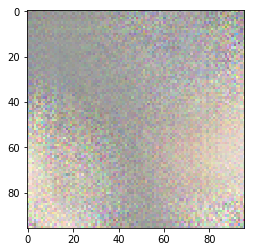

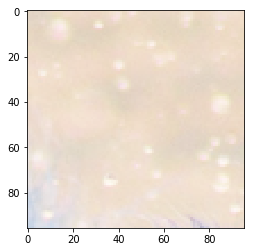

--------------------------------------------------------------------------------------
Testing...


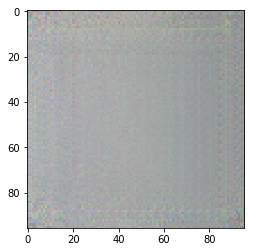

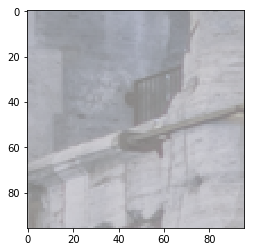

--------------------------------------------------------------------------------------


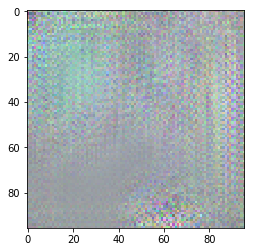

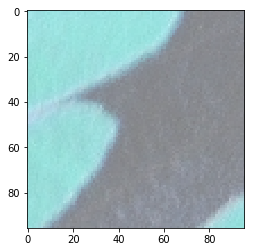

--------------------------------------------------------------------------------------


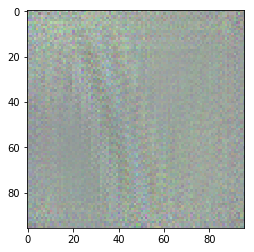

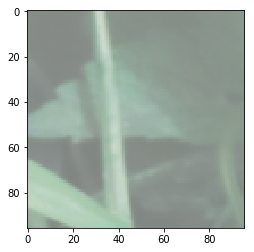

--------------------------------------------------------------------------------------


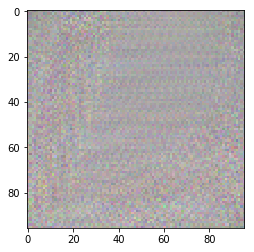

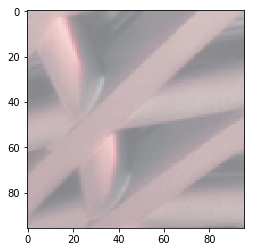

--------------------------------------------------------------------------------------


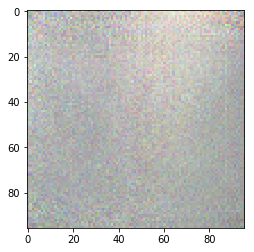

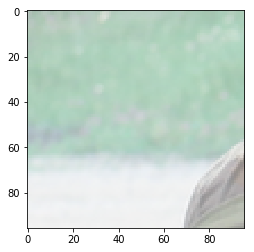

--------------------------------------------------------------------------------------


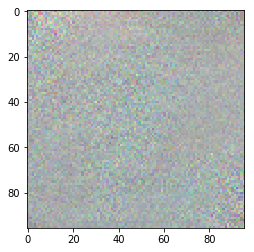

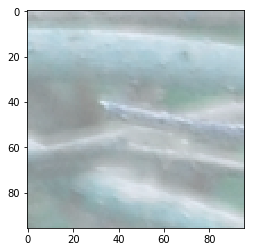

--------------------------------------------------------------------------------------


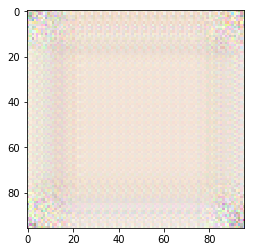

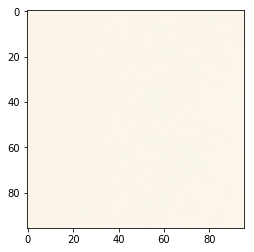

--------------------------------------------------------------------------------------


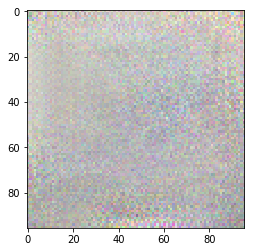

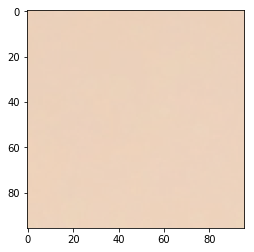

--------------------------------------------------------------------------------------


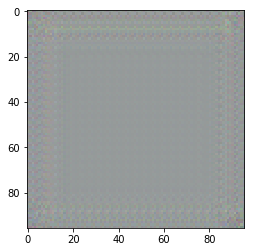

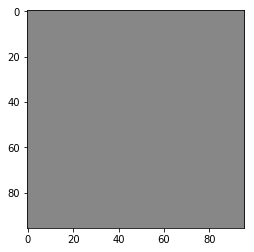

--------------------------------------------------------------------------------------


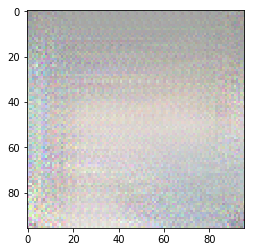

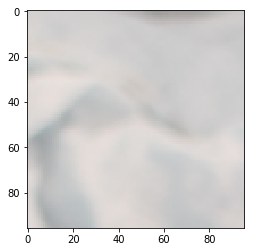

--------------------------------------------------------------------------------------


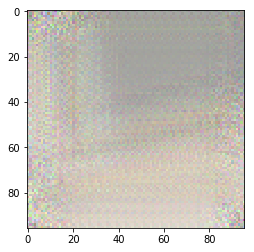

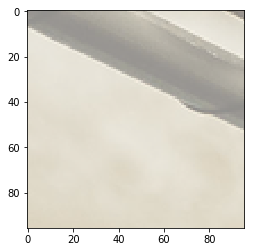

--------------------------------------------------------------------------------------
Epoch 20/50:
Train Loss: 0.2339
Test(Validation) Loss: 0.2126
[20 / 50] 	Learning_rate: 0.0001	 train_loss: 0.2339	 test_loss: 0.2126


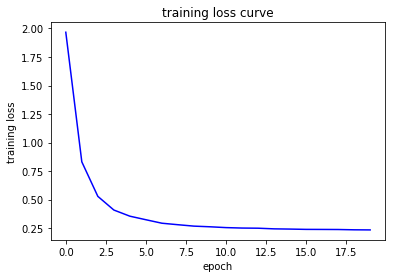

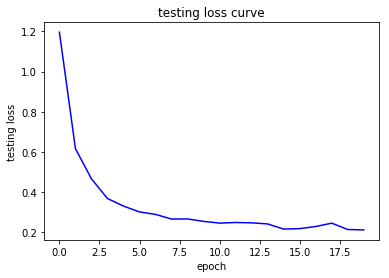

Training...


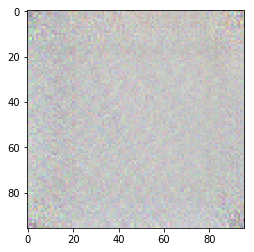

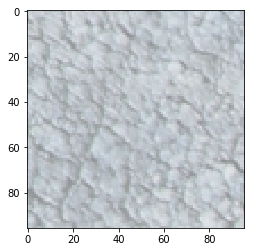

--------------------------------------------------------------------------------------


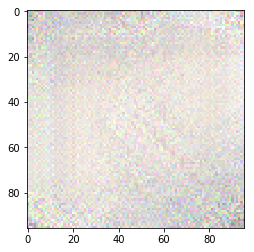

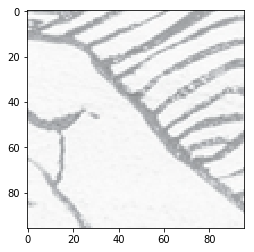

--------------------------------------------------------------------------------------
Testing...


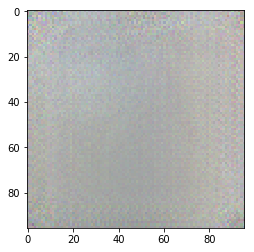

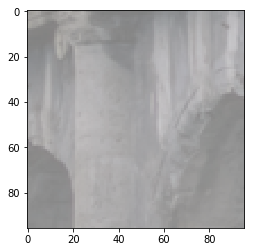

--------------------------------------------------------------------------------------


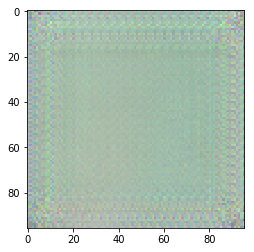

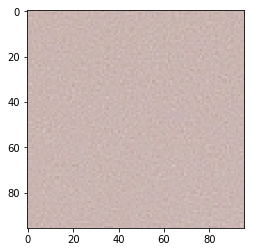

--------------------------------------------------------------------------------------


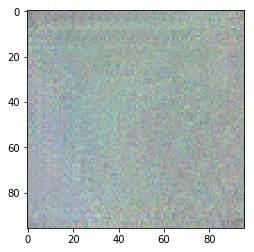

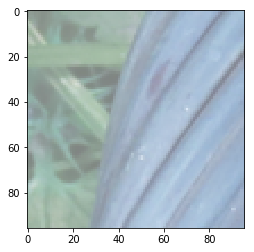

--------------------------------------------------------------------------------------


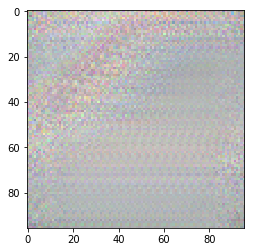

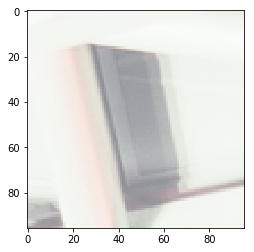

--------------------------------------------------------------------------------------


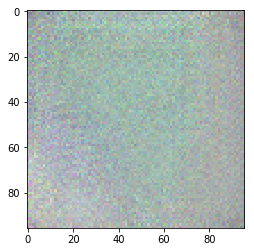

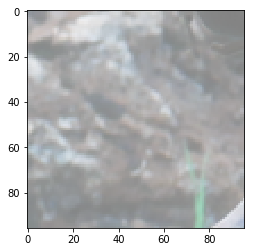

--------------------------------------------------------------------------------------


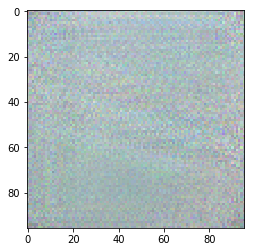

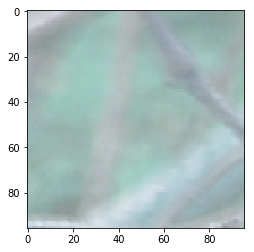

--------------------------------------------------------------------------------------


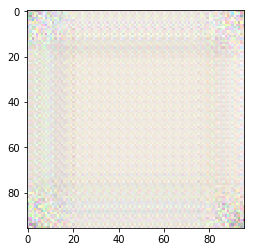

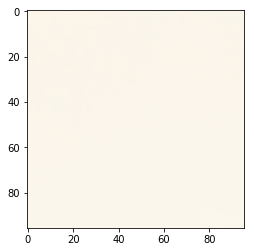

--------------------------------------------------------------------------------------


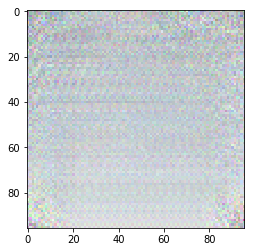

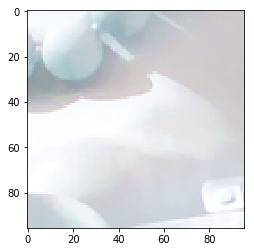

--------------------------------------------------------------------------------------


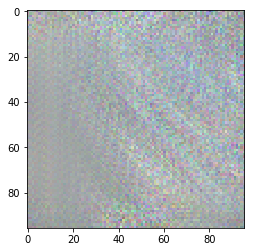

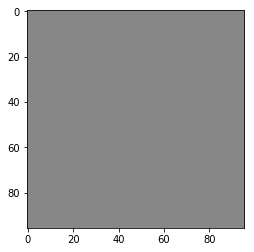

--------------------------------------------------------------------------------------


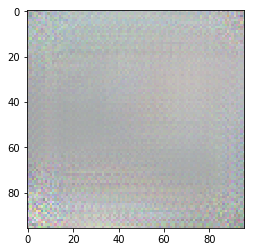

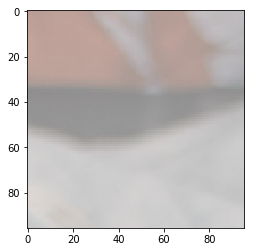

--------------------------------------------------------------------------------------


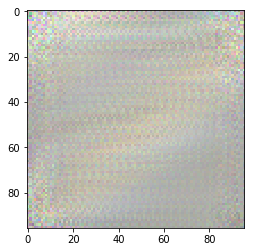

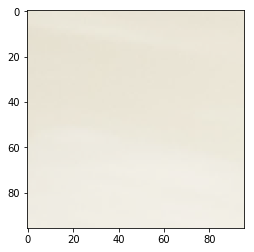

--------------------------------------------------------------------------------------
Epoch 21/50:
Train Loss: 0.2418
Test(Validation) Loss: 0.2235
Training...


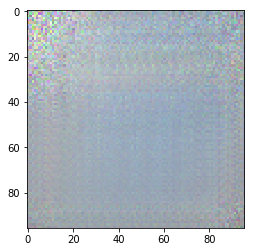

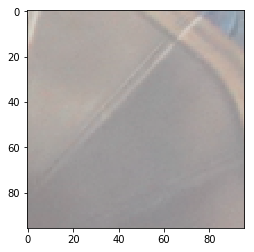

--------------------------------------------------------------------------------------


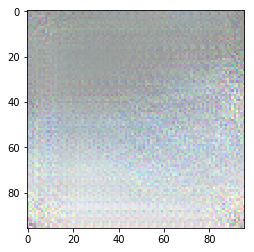

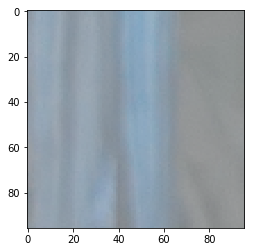

--------------------------------------------------------------------------------------
Testing...


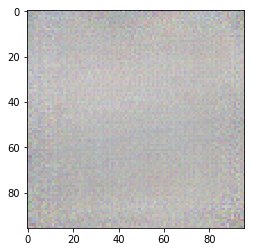

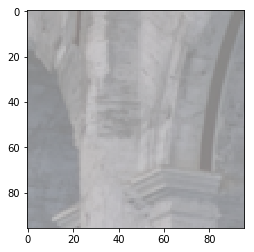

--------------------------------------------------------------------------------------


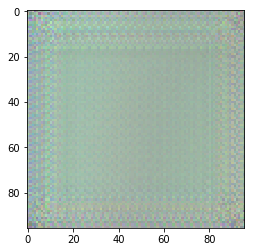

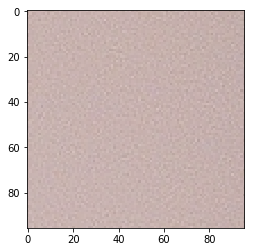

--------------------------------------------------------------------------------------


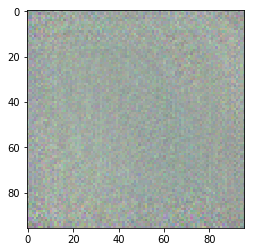

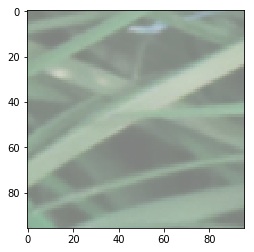

--------------------------------------------------------------------------------------


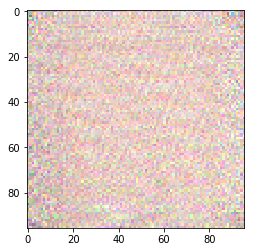

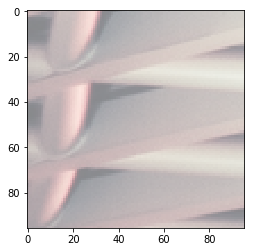

--------------------------------------------------------------------------------------


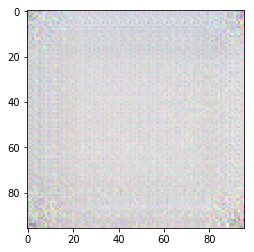

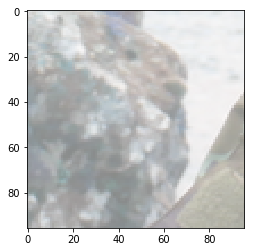

--------------------------------------------------------------------------------------


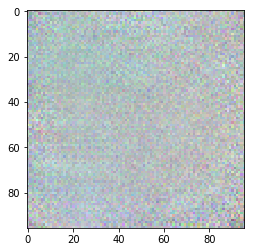

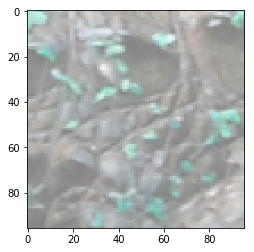

--------------------------------------------------------------------------------------


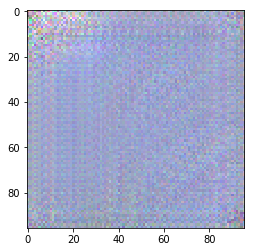

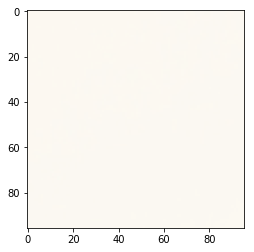

--------------------------------------------------------------------------------------


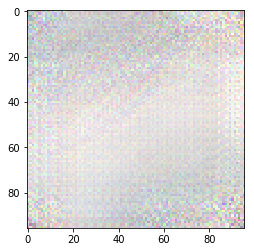

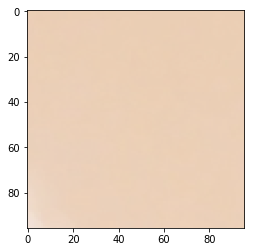

--------------------------------------------------------------------------------------


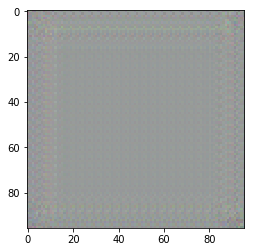

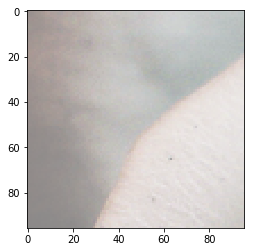

--------------------------------------------------------------------------------------


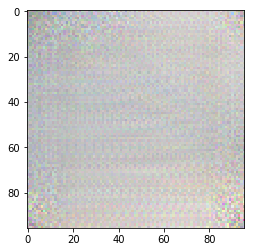

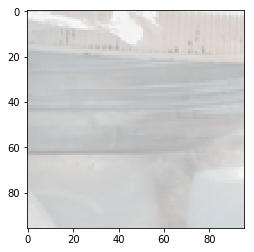

--------------------------------------------------------------------------------------


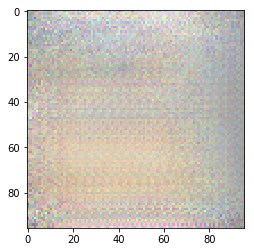

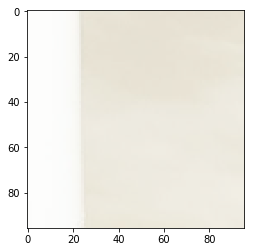

--------------------------------------------------------------------------------------
Epoch 22/50:
Train Loss: 0.2304
Test(Validation) Loss: 0.2246
Training...


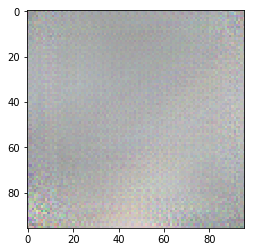

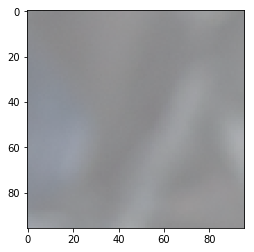

--------------------------------------------------------------------------------------


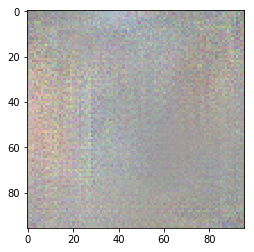

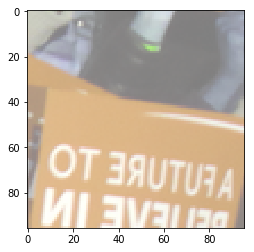

--------------------------------------------------------------------------------------
Testing...


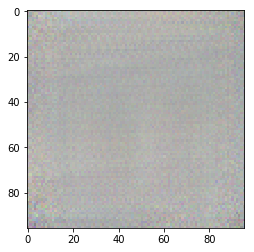

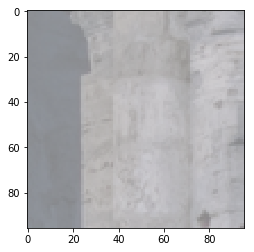

--------------------------------------------------------------------------------------


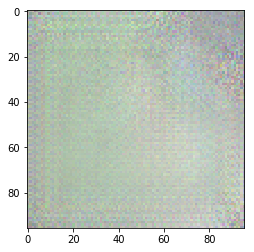

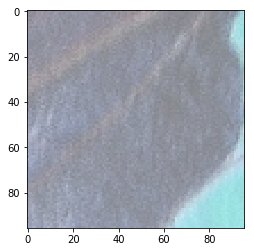

--------------------------------------------------------------------------------------


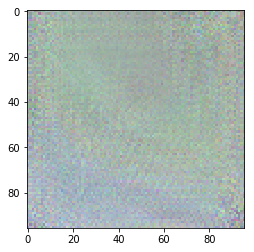

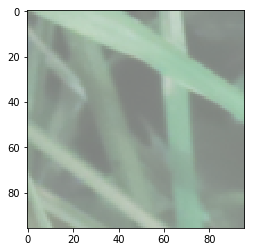

--------------------------------------------------------------------------------------


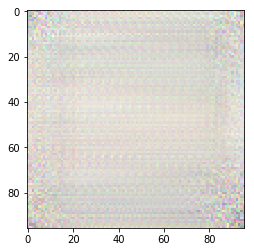

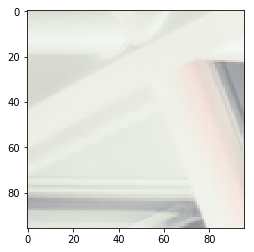

--------------------------------------------------------------------------------------


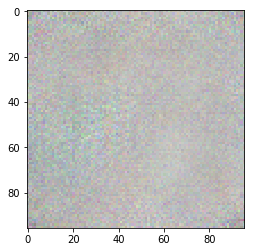

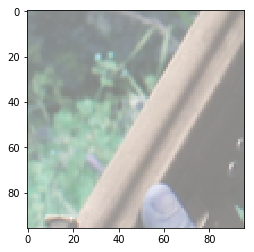

--------------------------------------------------------------------------------------


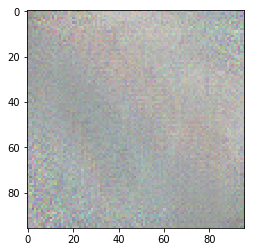

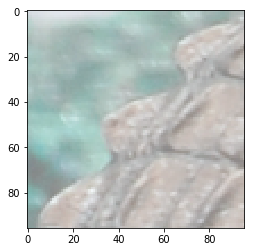

--------------------------------------------------------------------------------------


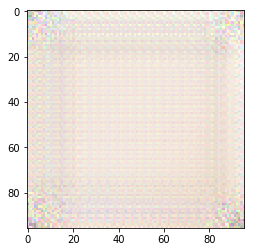

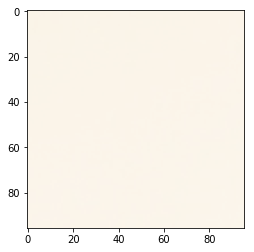

--------------------------------------------------------------------------------------


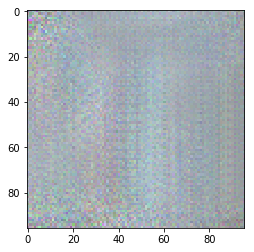

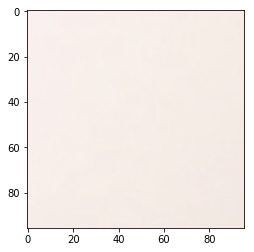

--------------------------------------------------------------------------------------


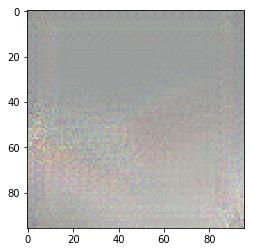

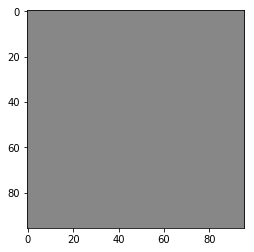

--------------------------------------------------------------------------------------


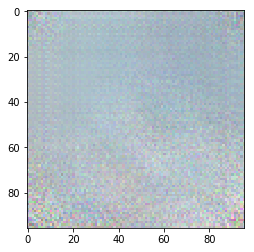

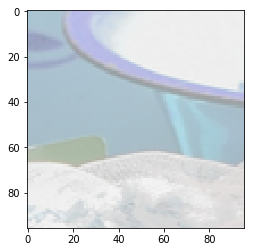

--------------------------------------------------------------------------------------


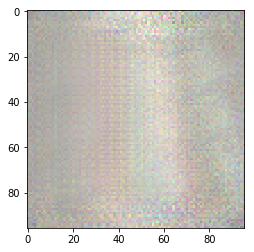

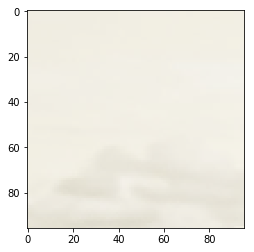

--------------------------------------------------------------------------------------
Epoch 23/50:
Train Loss: 0.2326
Test(Validation) Loss: 0.2191
Training...


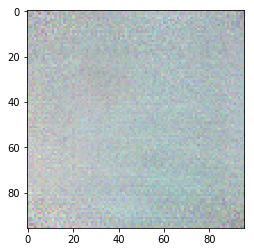

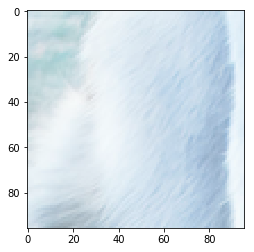

--------------------------------------------------------------------------------------


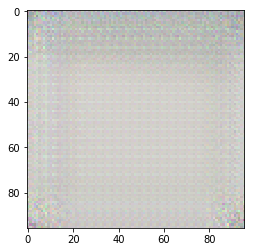

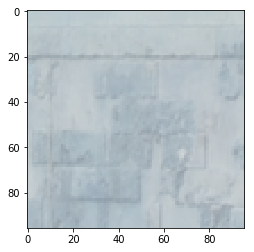

--------------------------------------------------------------------------------------
Testing...


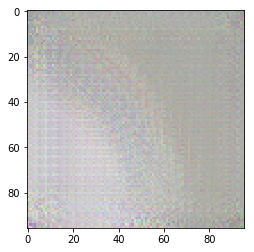

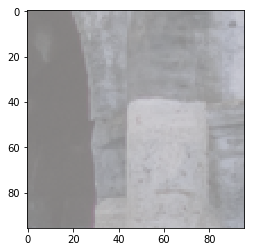

--------------------------------------------------------------------------------------


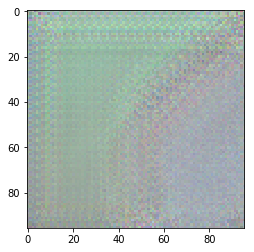

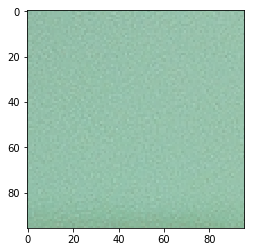

--------------------------------------------------------------------------------------


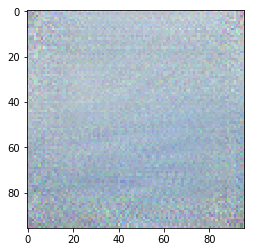

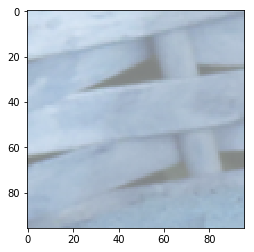

--------------------------------------------------------------------------------------


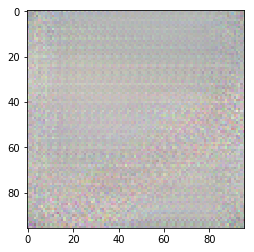

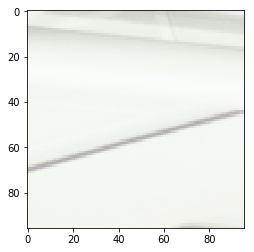

--------------------------------------------------------------------------------------


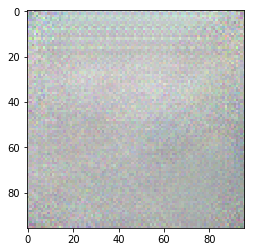

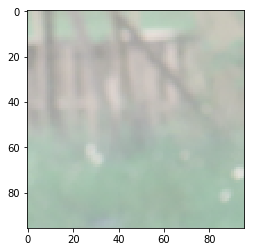

--------------------------------------------------------------------------------------


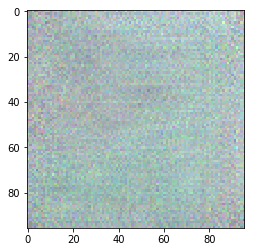

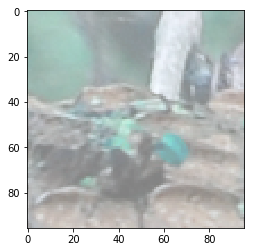

--------------------------------------------------------------------------------------


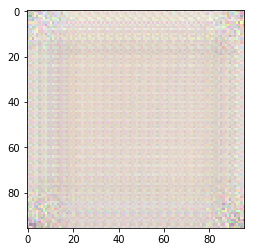

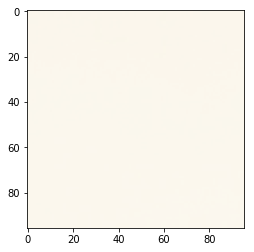

--------------------------------------------------------------------------------------


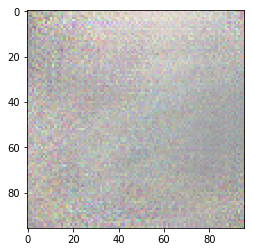

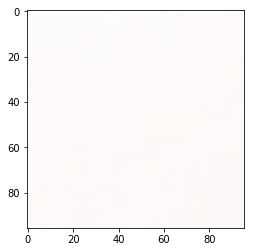

--------------------------------------------------------------------------------------


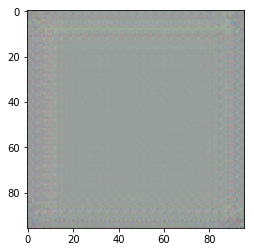

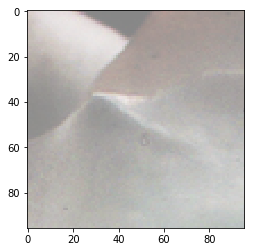

--------------------------------------------------------------------------------------


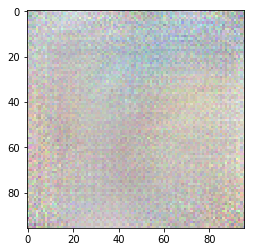

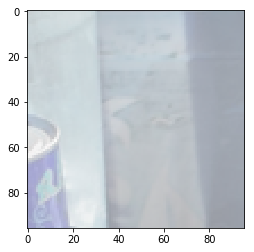

--------------------------------------------------------------------------------------


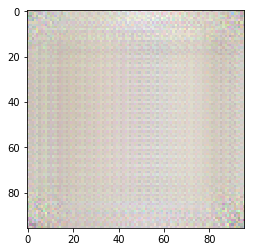

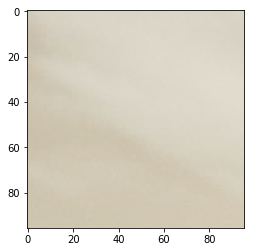

--------------------------------------------------------------------------------------
Epoch 24/50:
Train Loss: 0.2289
Test(Validation) Loss: 0.2200
Training...


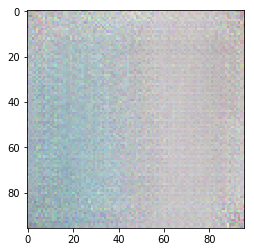

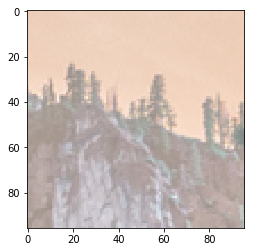

--------------------------------------------------------------------------------------


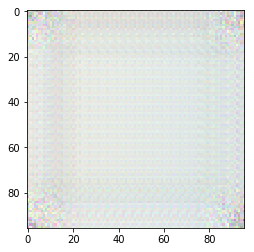

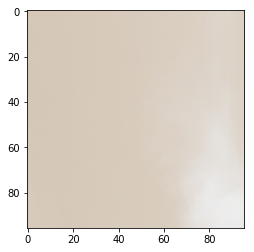

--------------------------------------------------------------------------------------
Testing...


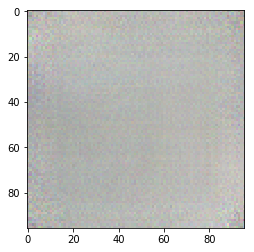

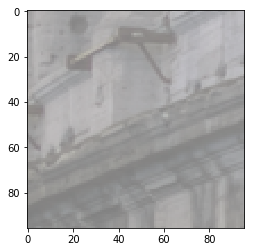

--------------------------------------------------------------------------------------


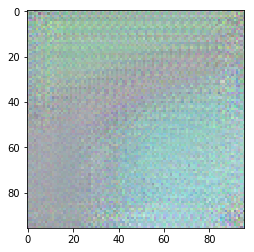

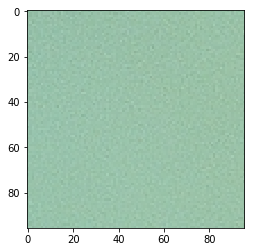

--------------------------------------------------------------------------------------


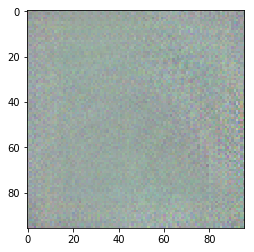

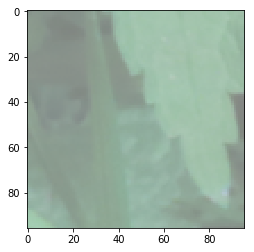

--------------------------------------------------------------------------------------


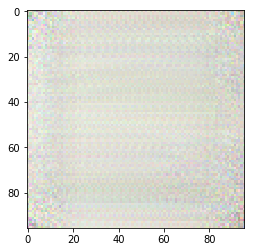

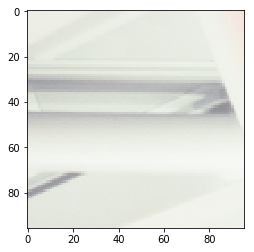

--------------------------------------------------------------------------------------


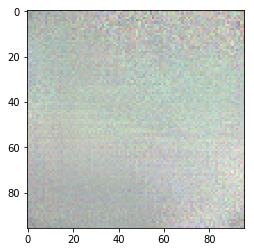

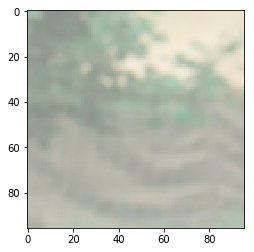

--------------------------------------------------------------------------------------


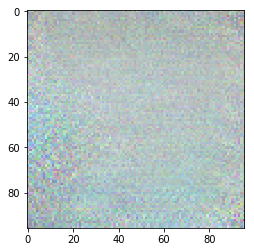

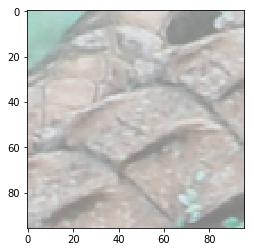

--------------------------------------------------------------------------------------


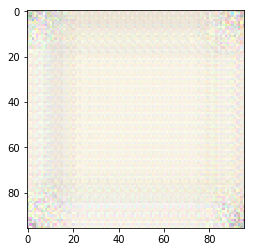

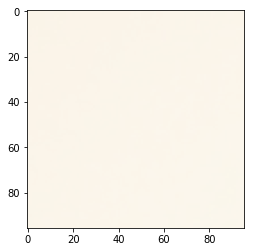

--------------------------------------------------------------------------------------


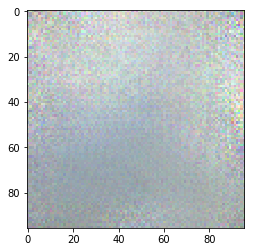

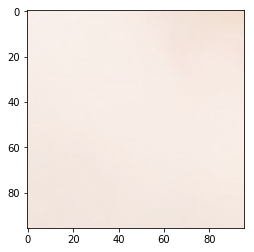

--------------------------------------------------------------------------------------


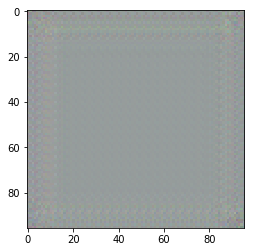

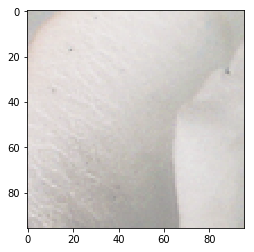

--------------------------------------------------------------------------------------


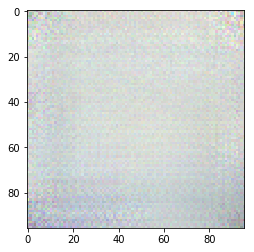

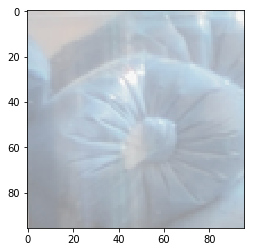

--------------------------------------------------------------------------------------


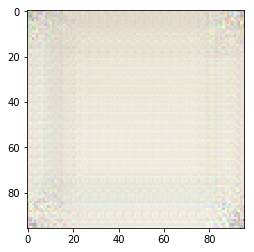

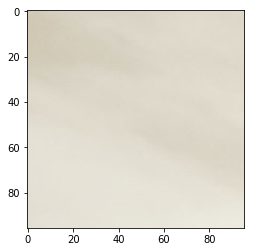

--------------------------------------------------------------------------------------
Epoch 25/50:
Train Loss: 0.2248
Test(Validation) Loss: 0.2013
Training...


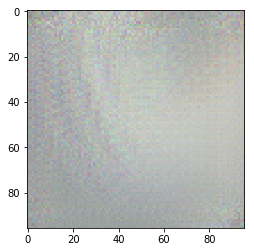

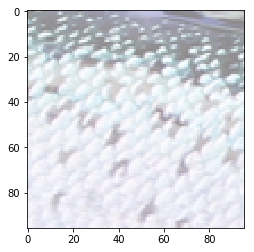

--------------------------------------------------------------------------------------


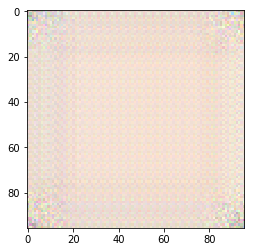

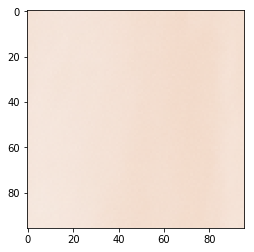

--------------------------------------------------------------------------------------
Testing...


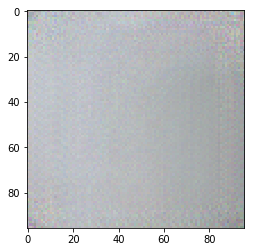

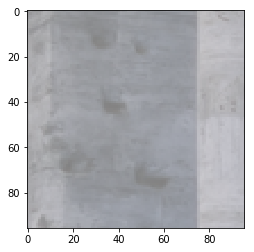

--------------------------------------------------------------------------------------


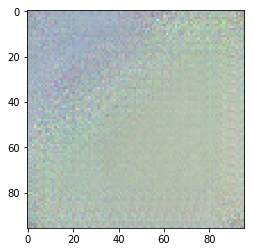

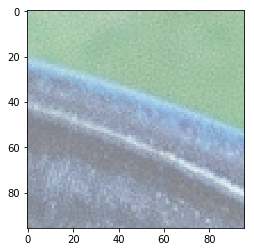

--------------------------------------------------------------------------------------


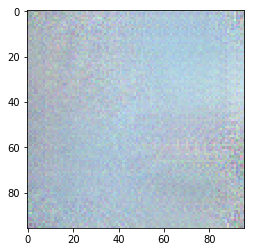

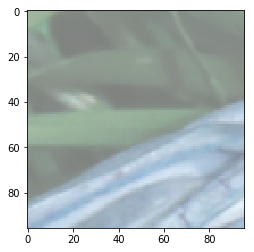

--------------------------------------------------------------------------------------


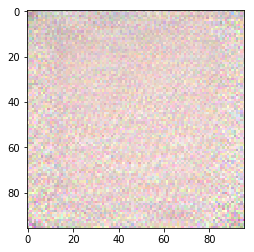

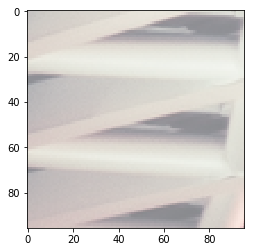

--------------------------------------------------------------------------------------


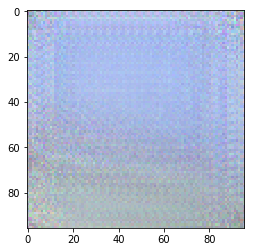

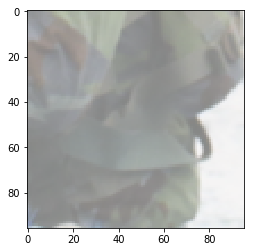

--------------------------------------------------------------------------------------


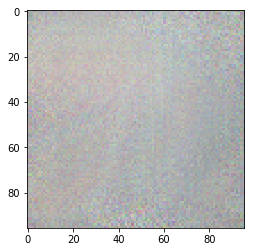

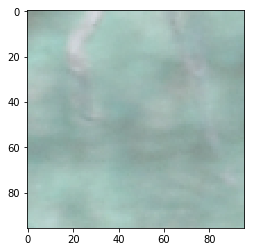

--------------------------------------------------------------------------------------


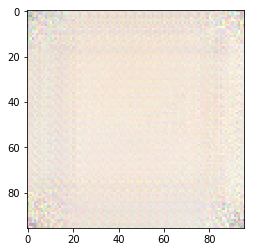

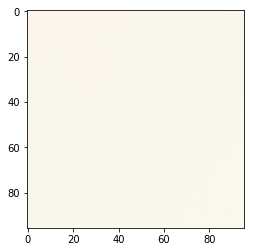

--------------------------------------------------------------------------------------


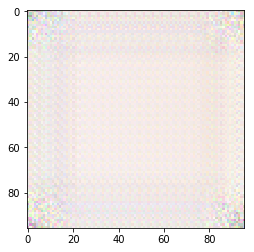

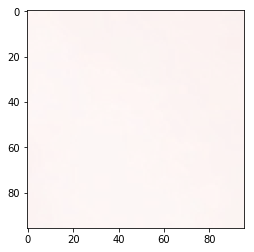

--------------------------------------------------------------------------------------


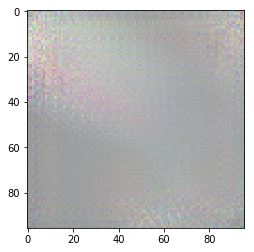

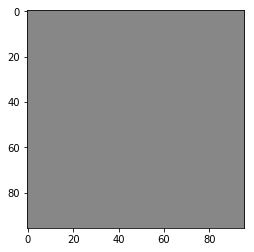

--------------------------------------------------------------------------------------


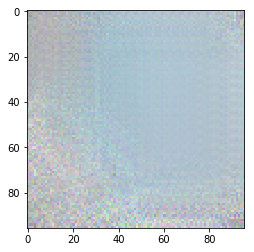

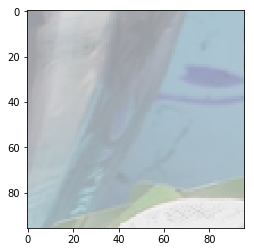

--------------------------------------------------------------------------------------


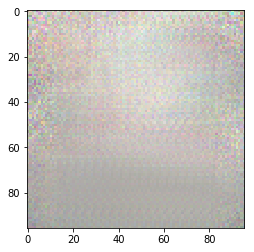

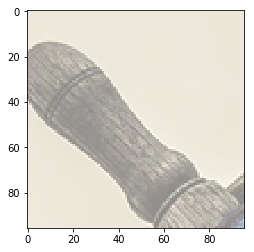

--------------------------------------------------------------------------------------
Epoch 26/50:
Train Loss: 0.2357
Test(Validation) Loss: 0.2204
Training...


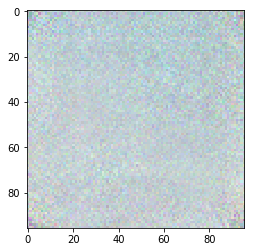

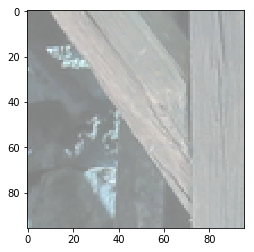

--------------------------------------------------------------------------------------


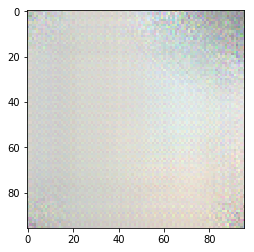

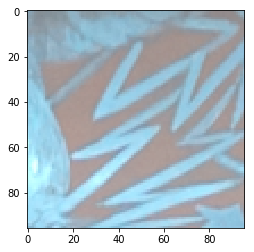

--------------------------------------------------------------------------------------
Testing...


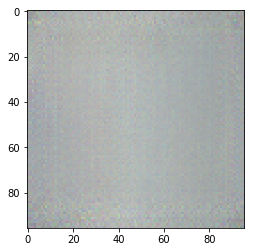

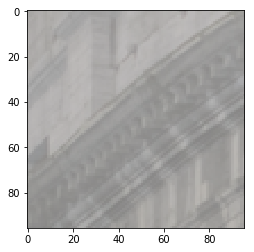

--------------------------------------------------------------------------------------


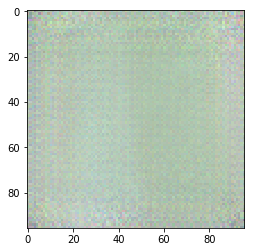

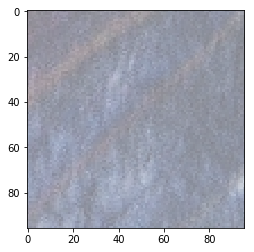

--------------------------------------------------------------------------------------


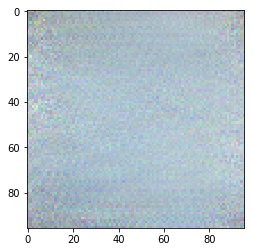

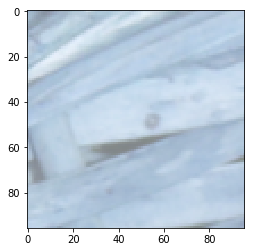

--------------------------------------------------------------------------------------


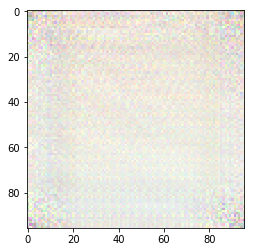

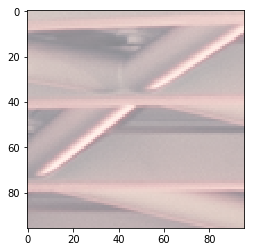

--------------------------------------------------------------------------------------


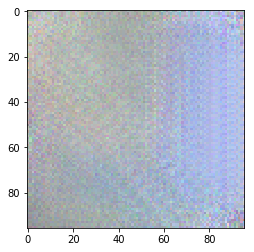

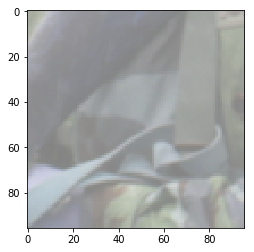

--------------------------------------------------------------------------------------


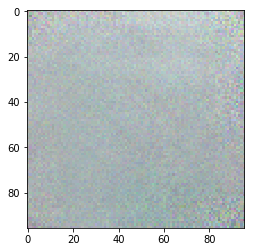

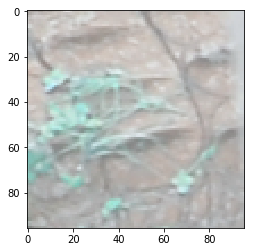

--------------------------------------------------------------------------------------


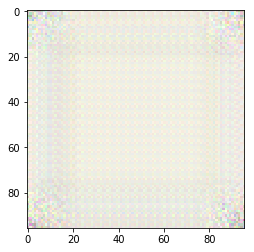

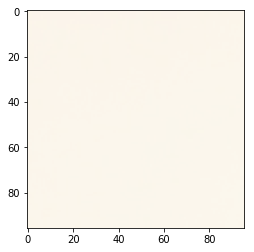

--------------------------------------------------------------------------------------


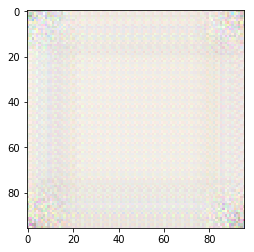

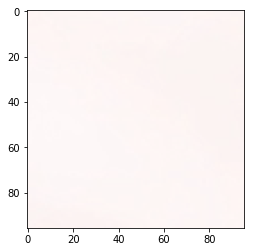

--------------------------------------------------------------------------------------


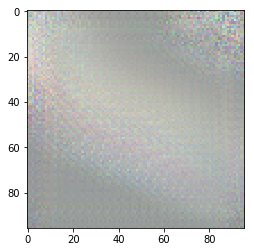

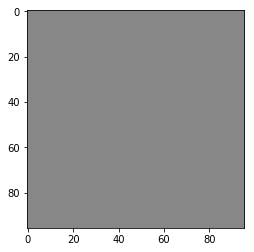

--------------------------------------------------------------------------------------


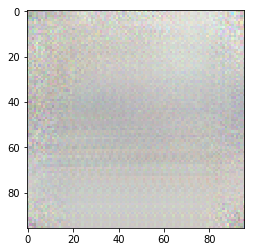

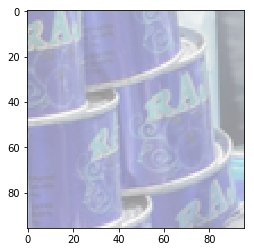

--------------------------------------------------------------------------------------


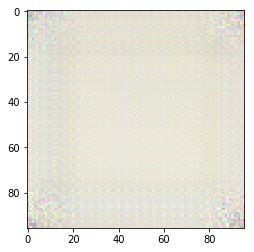

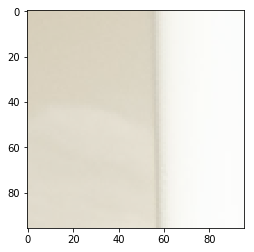

--------------------------------------------------------------------------------------
Epoch 27/50:
Train Loss: 0.2308
Test(Validation) Loss: 0.2163
Training...


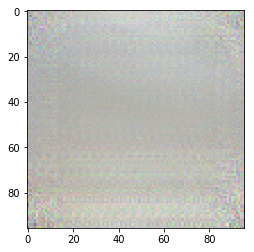

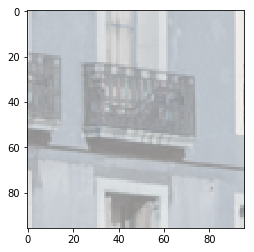

--------------------------------------------------------------------------------------


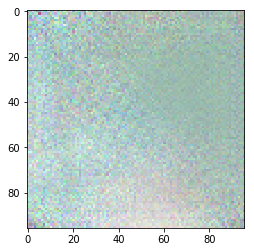

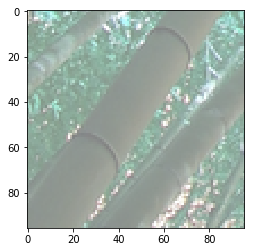

--------------------------------------------------------------------------------------
Testing...


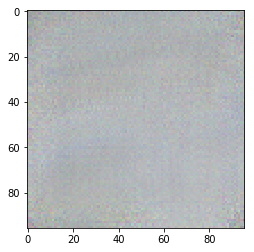

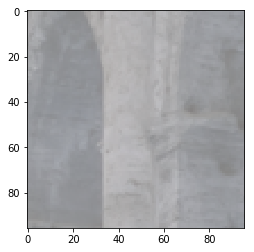

--------------------------------------------------------------------------------------


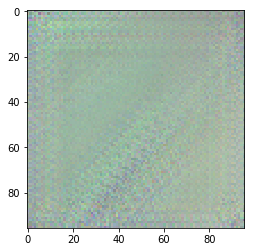

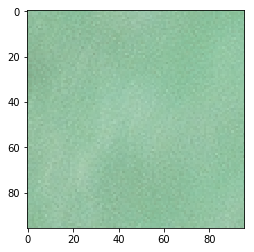

--------------------------------------------------------------------------------------


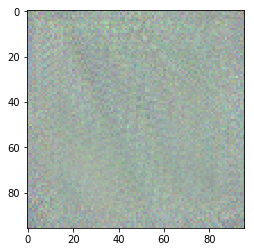

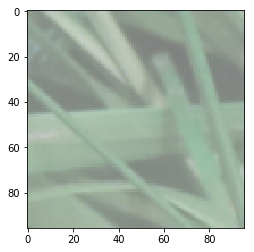

--------------------------------------------------------------------------------------


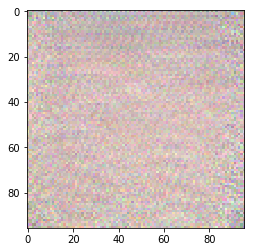

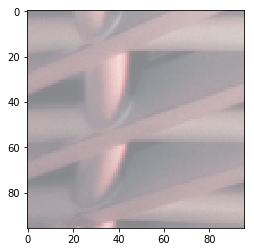

--------------------------------------------------------------------------------------


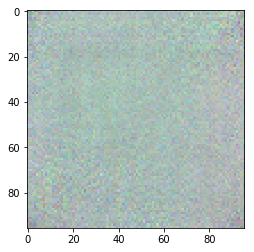

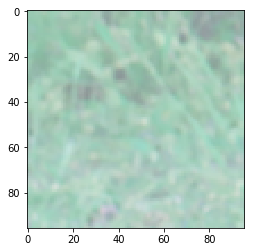

--------------------------------------------------------------------------------------


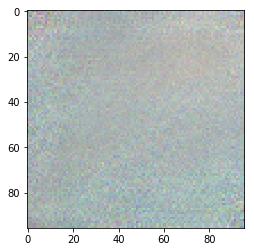

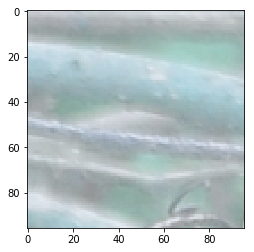

--------------------------------------------------------------------------------------


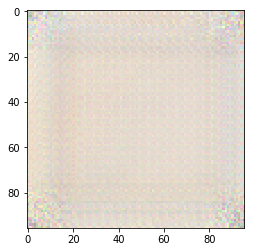

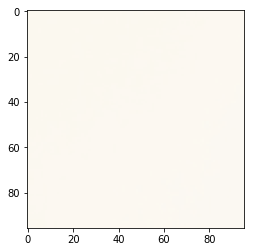

--------------------------------------------------------------------------------------


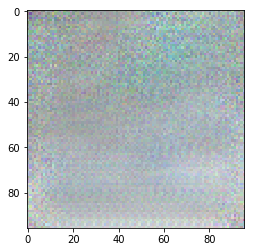

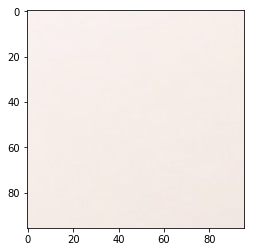

--------------------------------------------------------------------------------------


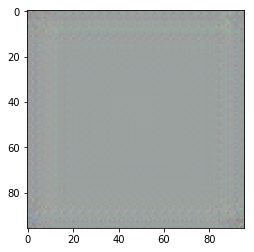

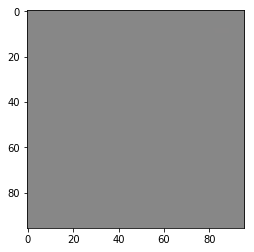

--------------------------------------------------------------------------------------


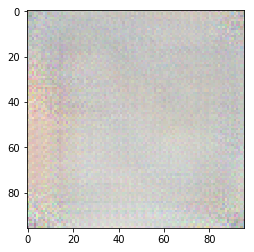

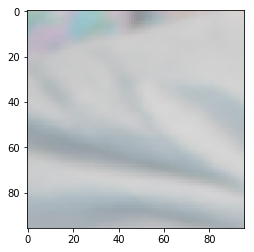

--------------------------------------------------------------------------------------


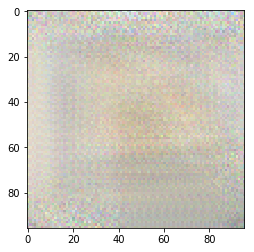

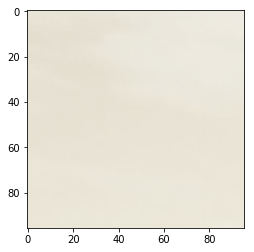

--------------------------------------------------------------------------------------
Epoch 28/50:
Train Loss: 0.2322
Test(Validation) Loss: 0.2219
Training...


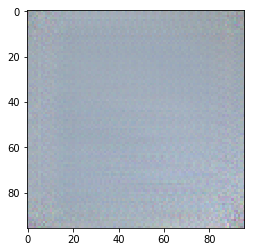

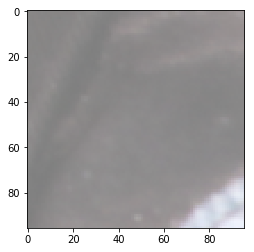

--------------------------------------------------------------------------------------


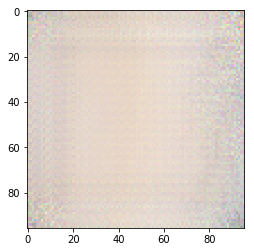

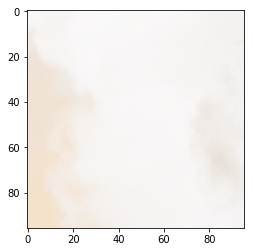

--------------------------------------------------------------------------------------
Testing...


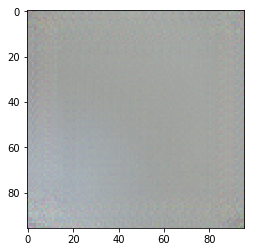

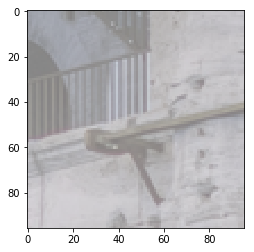

--------------------------------------------------------------------------------------


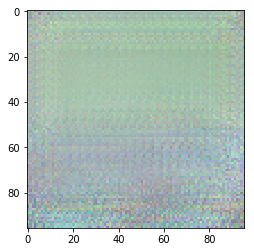

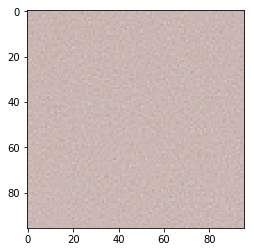

--------------------------------------------------------------------------------------


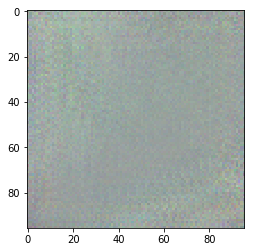

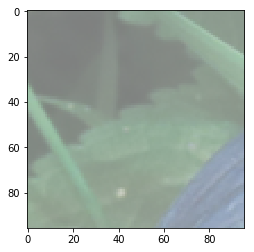

--------------------------------------------------------------------------------------


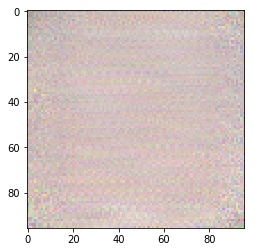

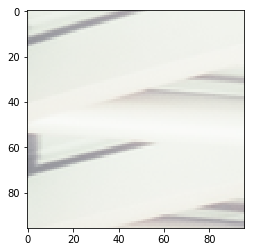

--------------------------------------------------------------------------------------


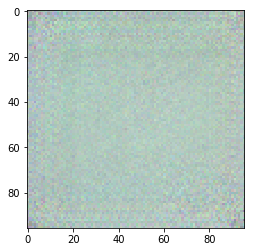

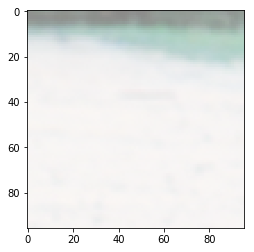

--------------------------------------------------------------------------------------


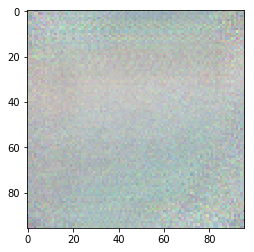

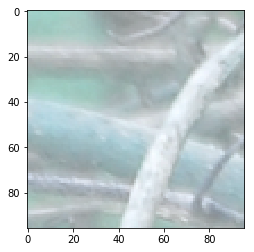

--------------------------------------------------------------------------------------


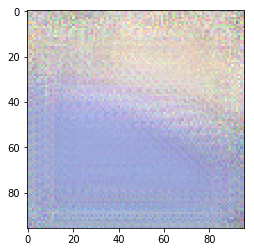

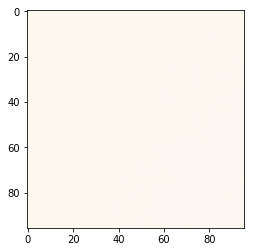

--------------------------------------------------------------------------------------


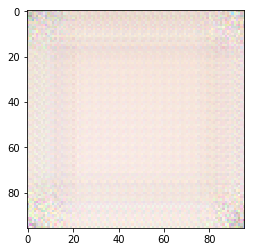

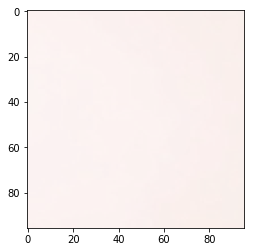

--------------------------------------------------------------------------------------


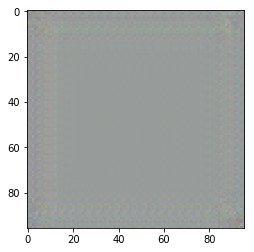

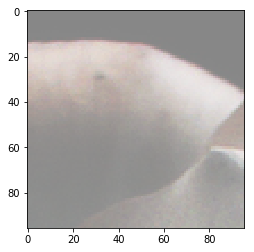

--------------------------------------------------------------------------------------


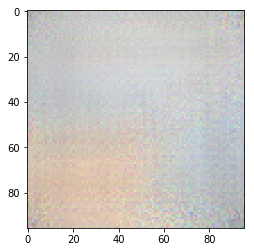

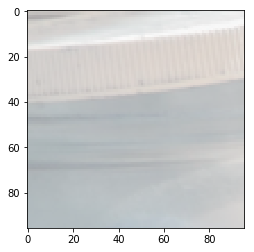

--------------------------------------------------------------------------------------


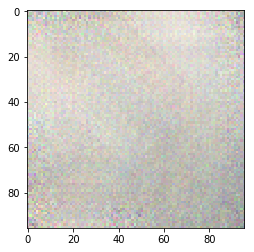

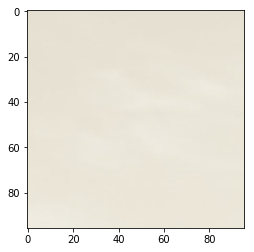

--------------------------------------------------------------------------------------
Epoch 29/50:
Train Loss: 0.2255
Test(Validation) Loss: 0.2278
Training...


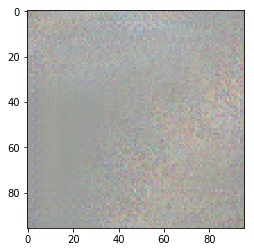

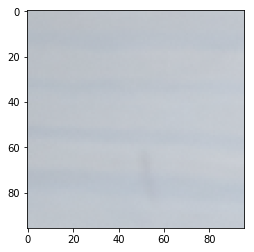

--------------------------------------------------------------------------------------


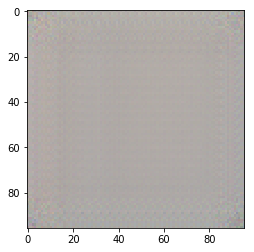

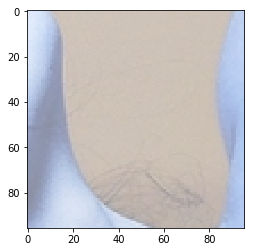

--------------------------------------------------------------------------------------
Testing...


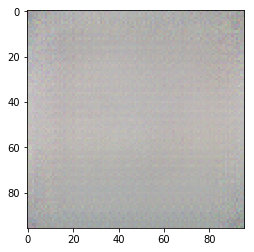

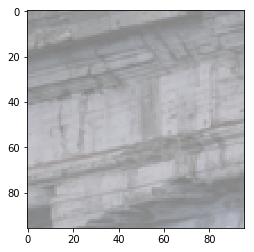

--------------------------------------------------------------------------------------


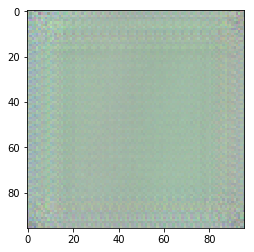

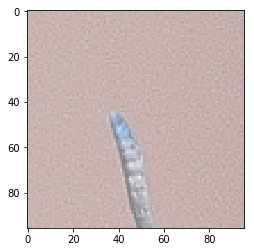

--------------------------------------------------------------------------------------


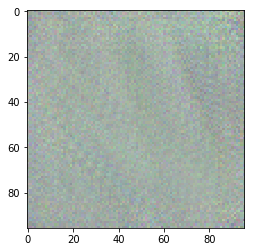

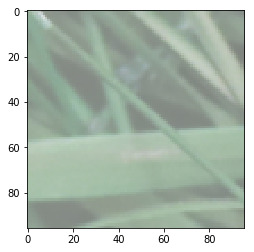

--------------------------------------------------------------------------------------


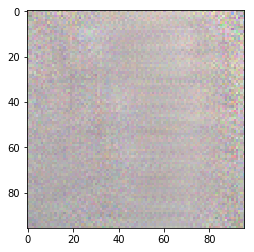

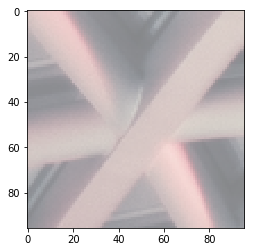

--------------------------------------------------------------------------------------


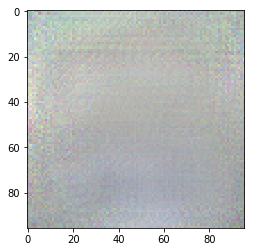

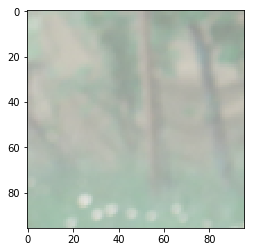

--------------------------------------------------------------------------------------


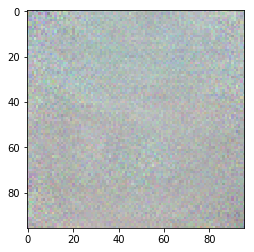

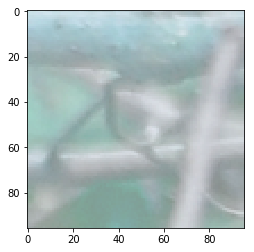

--------------------------------------------------------------------------------------


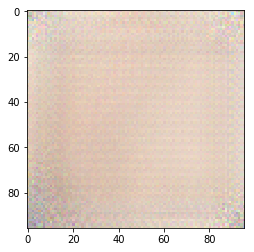

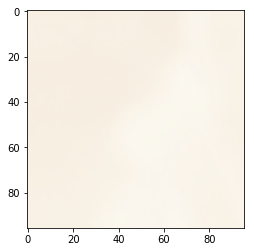

--------------------------------------------------------------------------------------


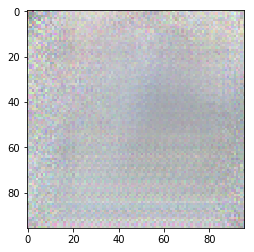

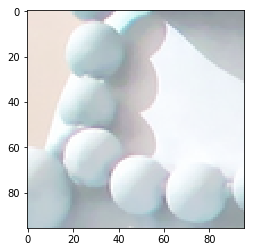

--------------------------------------------------------------------------------------


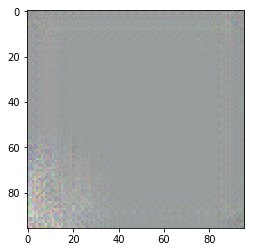

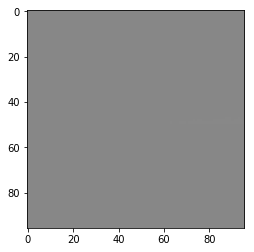

--------------------------------------------------------------------------------------


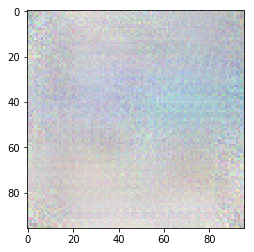

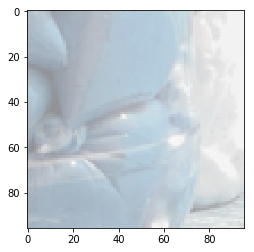

--------------------------------------------------------------------------------------


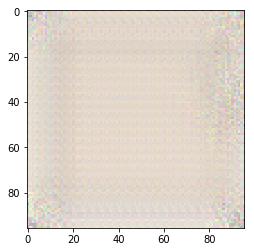

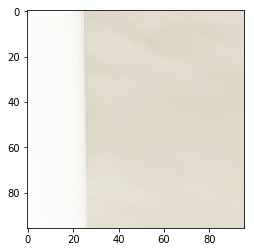

--------------------------------------------------------------------------------------
Epoch 30/50:
Train Loss: 0.2273
Test(Validation) Loss: 0.2132
[30 / 50] 	Learning_rate: 0.0001	 train_loss: 0.2273	 test_loss: 0.2132


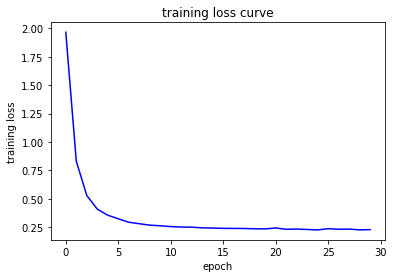

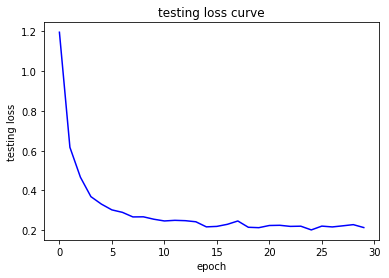

Training...


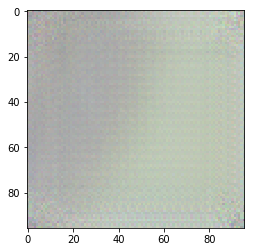

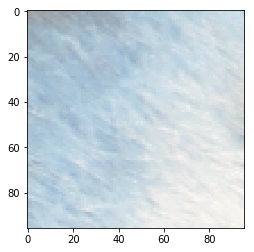

--------------------------------------------------------------------------------------


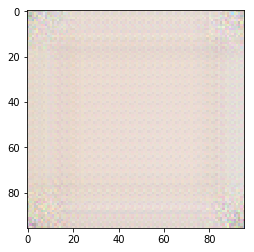

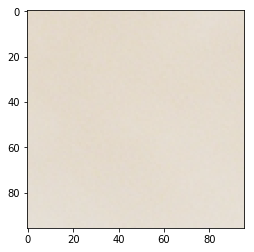

--------------------------------------------------------------------------------------
Testing...


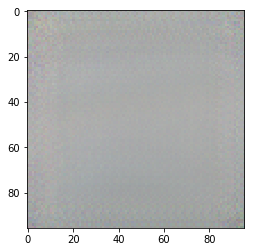

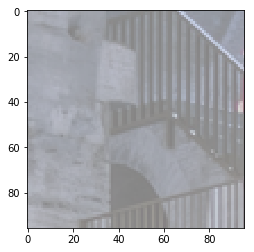

--------------------------------------------------------------------------------------


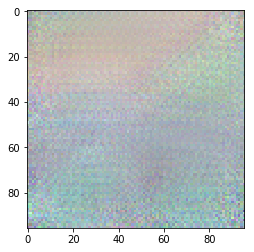

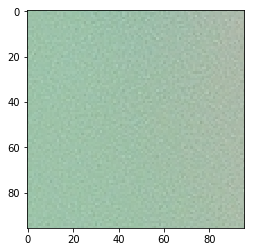

--------------------------------------------------------------------------------------


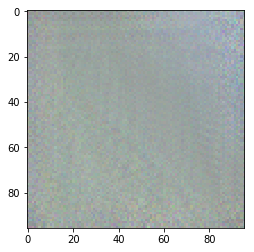

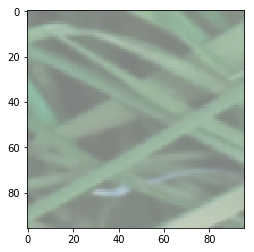

--------------------------------------------------------------------------------------


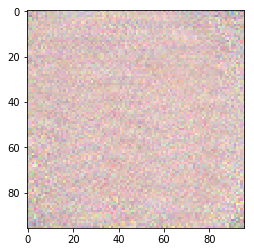

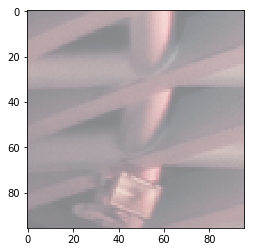

--------------------------------------------------------------------------------------


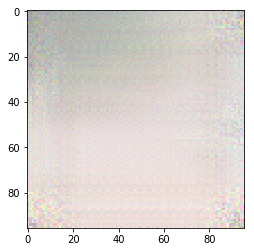

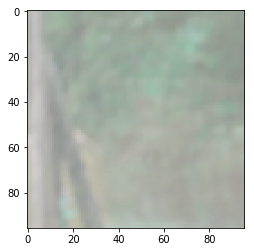

--------------------------------------------------------------------------------------


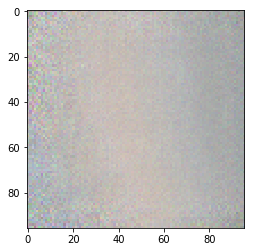

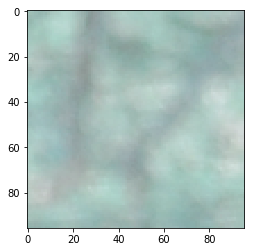

--------------------------------------------------------------------------------------


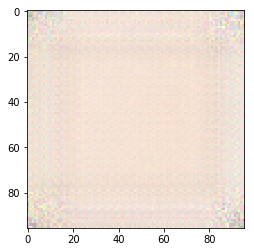

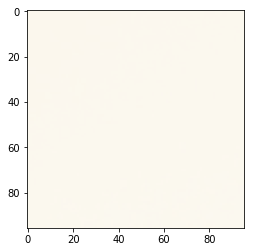

--------------------------------------------------------------------------------------


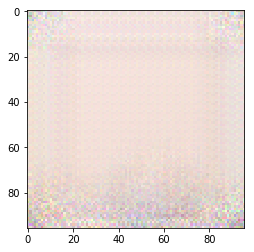

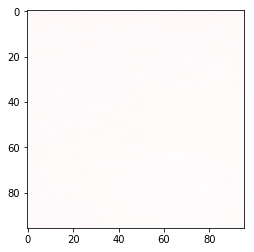

--------------------------------------------------------------------------------------


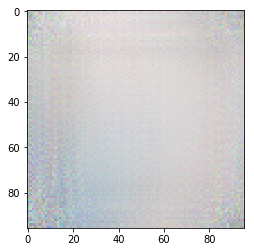

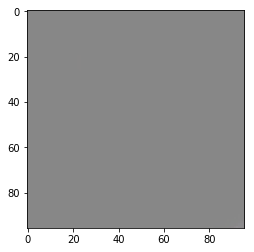

--------------------------------------------------------------------------------------


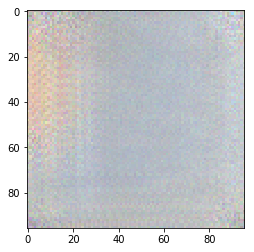

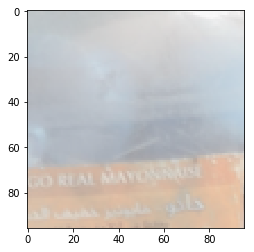

--------------------------------------------------------------------------------------


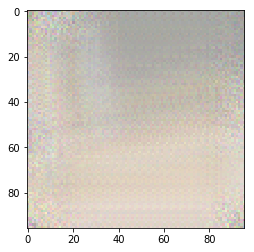

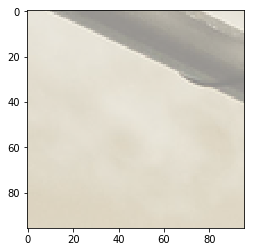

--------------------------------------------------------------------------------------
Epoch 31/50:
Train Loss: 0.2290
Test(Validation) Loss: 0.2192
Training...


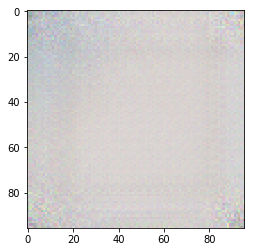

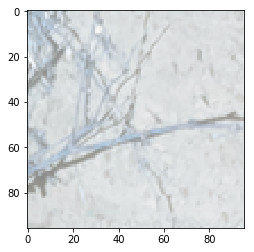

--------------------------------------------------------------------------------------


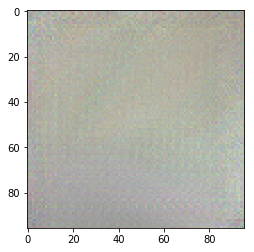

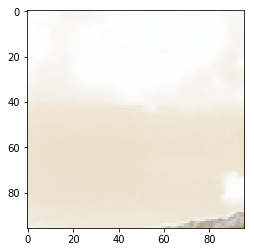

--------------------------------------------------------------------------------------
Testing...


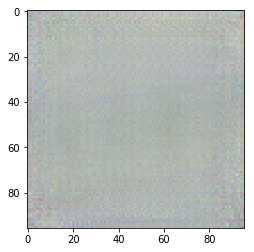

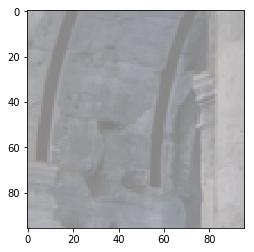

--------------------------------------------------------------------------------------


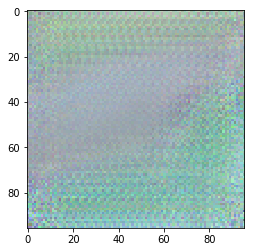

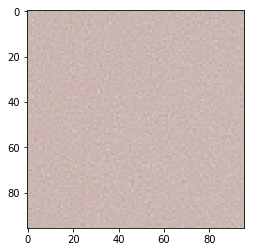

--------------------------------------------------------------------------------------


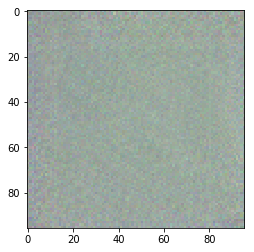

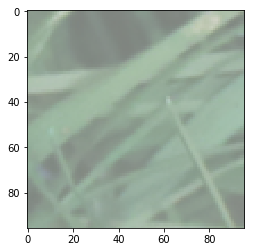

--------------------------------------------------------------------------------------


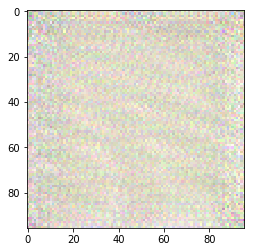

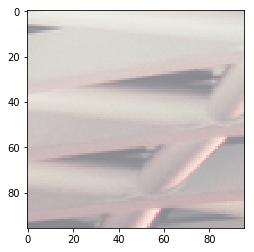

--------------------------------------------------------------------------------------


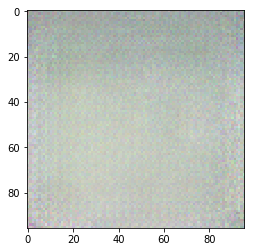

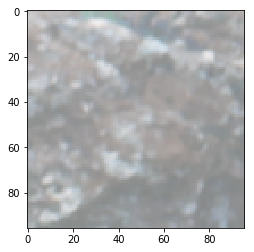

--------------------------------------------------------------------------------------


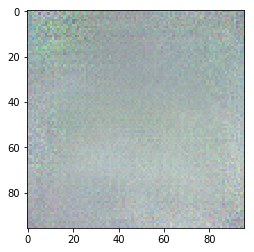

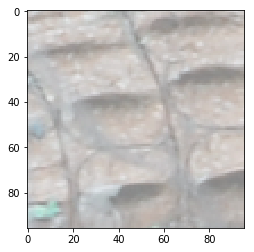

--------------------------------------------------------------------------------------


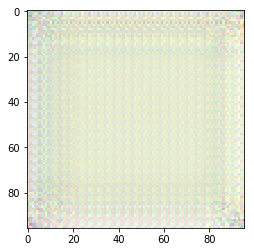

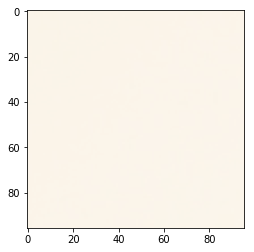

--------------------------------------------------------------------------------------


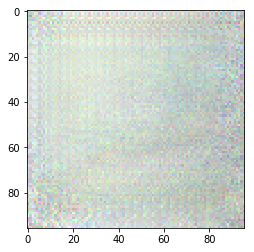

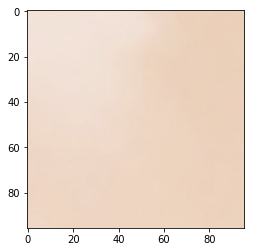

--------------------------------------------------------------------------------------


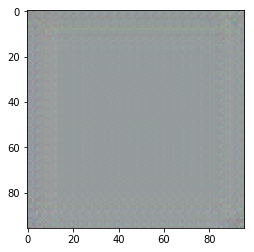

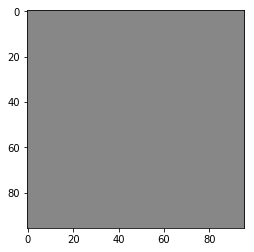

--------------------------------------------------------------------------------------


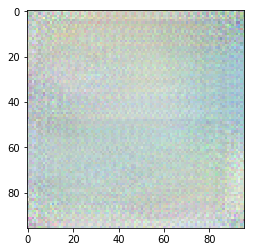

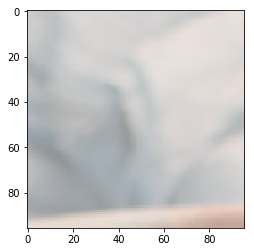

--------------------------------------------------------------------------------------


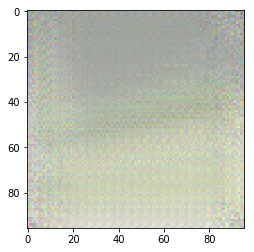

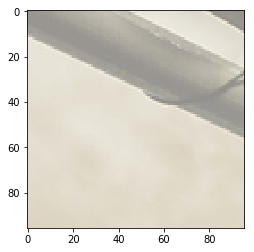

--------------------------------------------------------------------------------------
Epoch 32/50:
Train Loss: 0.2293
Test(Validation) Loss: 0.2137
Training...


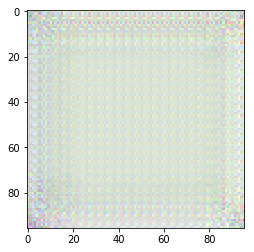

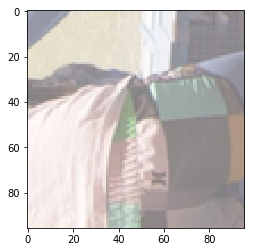

--------------------------------------------------------------------------------------


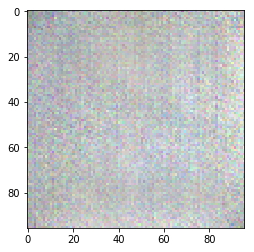

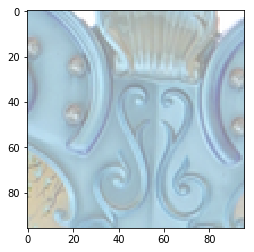

--------------------------------------------------------------------------------------
Testing...


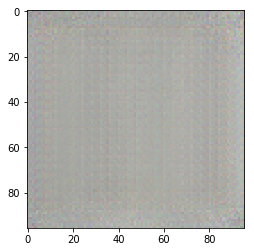

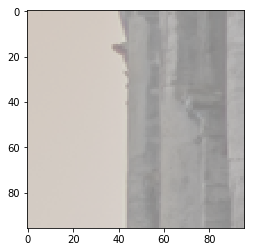

--------------------------------------------------------------------------------------


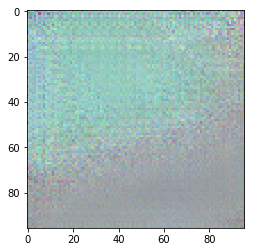

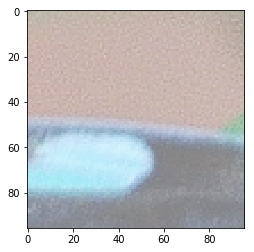

--------------------------------------------------------------------------------------


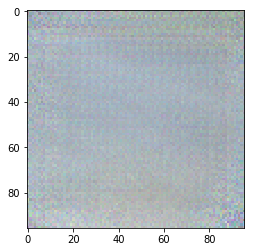

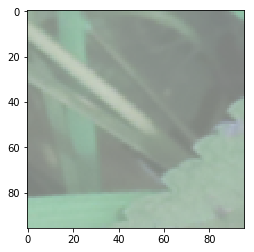

--------------------------------------------------------------------------------------


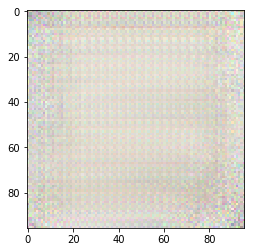

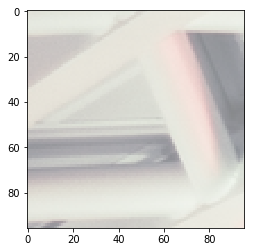

--------------------------------------------------------------------------------------


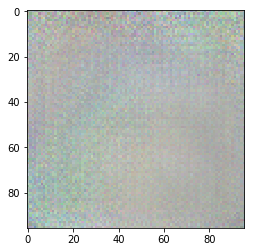

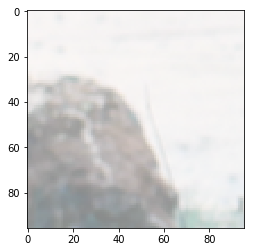

--------------------------------------------------------------------------------------


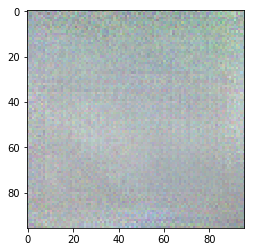

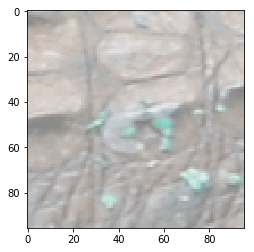

--------------------------------------------------------------------------------------


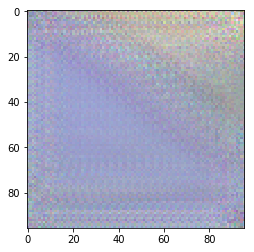

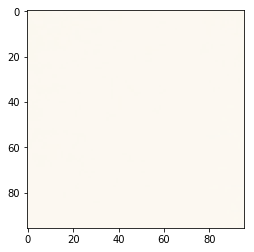

--------------------------------------------------------------------------------------


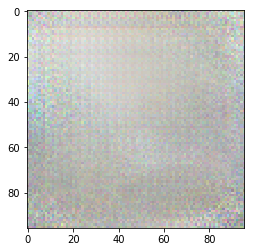

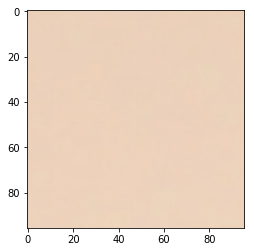

--------------------------------------------------------------------------------------


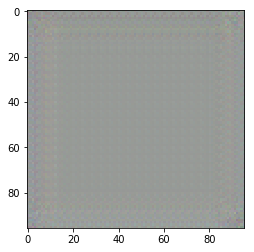

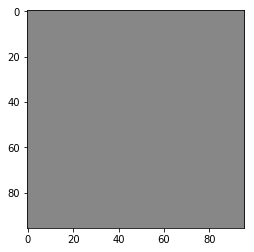

--------------------------------------------------------------------------------------


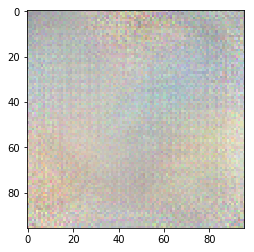

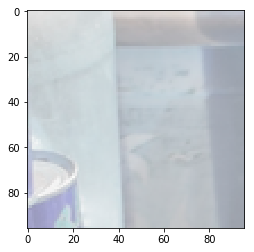

--------------------------------------------------------------------------------------


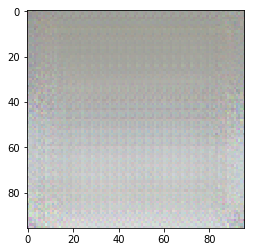

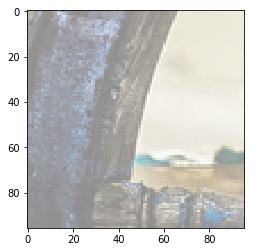

--------------------------------------------------------------------------------------
Epoch 33/50:
Train Loss: 0.2293
Test(Validation) Loss: 0.2338
Training...


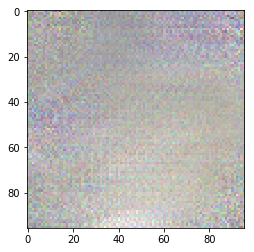

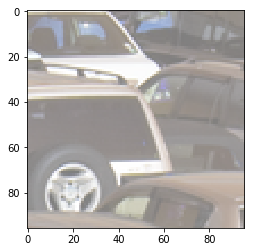

--------------------------------------------------------------------------------------


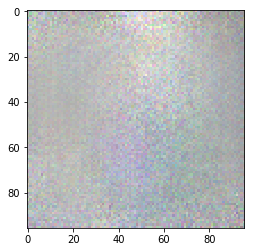

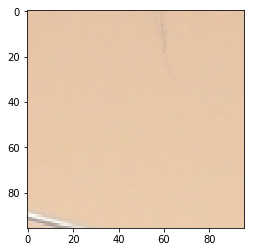

--------------------------------------------------------------------------------------
Testing...


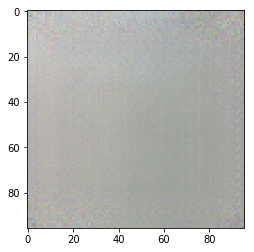

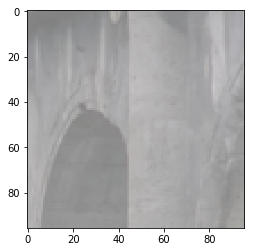

--------------------------------------------------------------------------------------


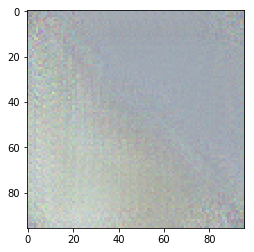

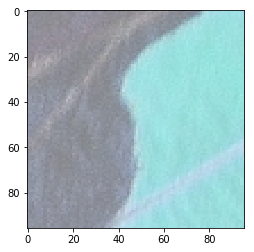

--------------------------------------------------------------------------------------


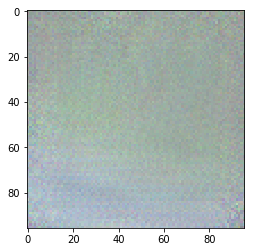

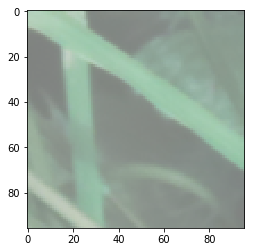

--------------------------------------------------------------------------------------


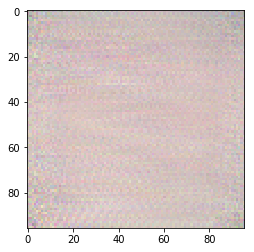

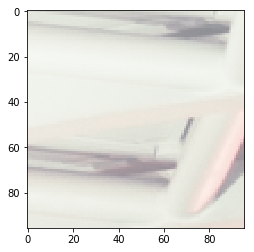

--------------------------------------------------------------------------------------


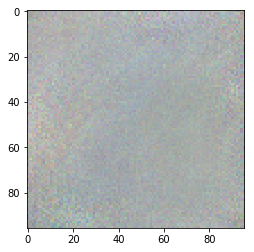

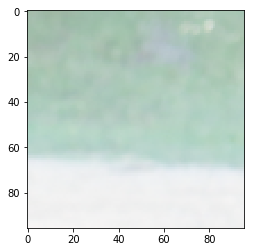

--------------------------------------------------------------------------------------


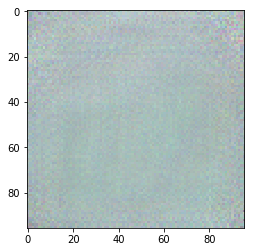

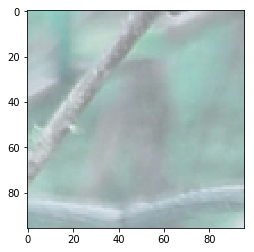

--------------------------------------------------------------------------------------


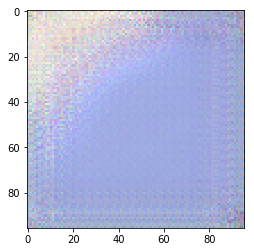

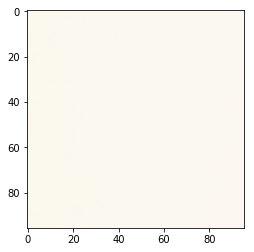

--------------------------------------------------------------------------------------


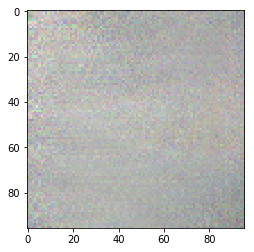

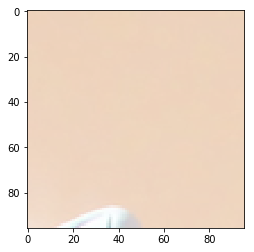

--------------------------------------------------------------------------------------


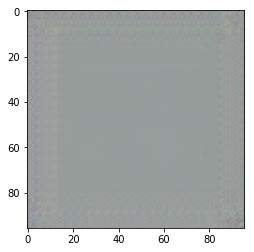

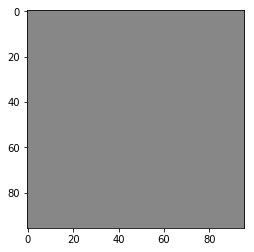

--------------------------------------------------------------------------------------


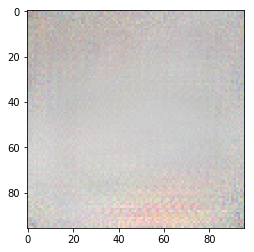

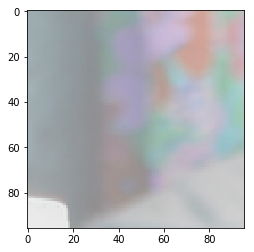

--------------------------------------------------------------------------------------


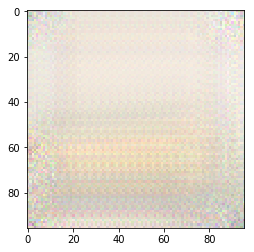

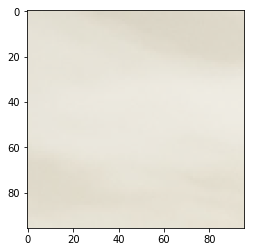

--------------------------------------------------------------------------------------
Epoch 34/50:
Train Loss: 0.2255
Test(Validation) Loss: 0.2206
Training...


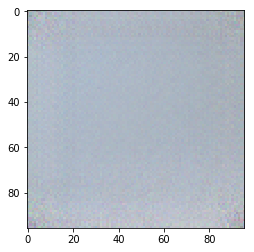

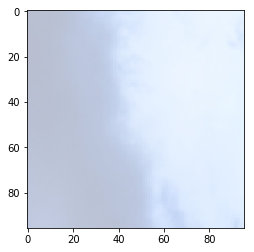

--------------------------------------------------------------------------------------


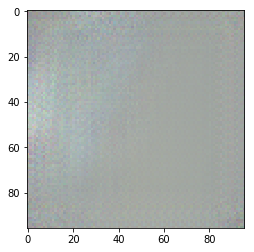

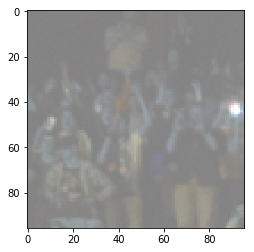

--------------------------------------------------------------------------------------
Testing...


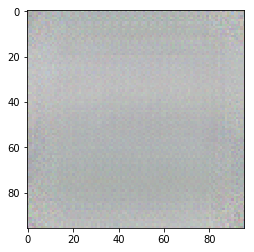

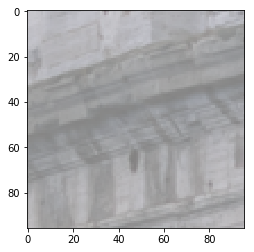

--------------------------------------------------------------------------------------


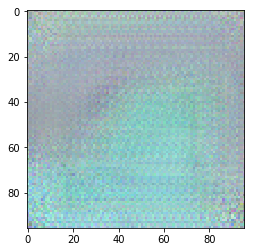

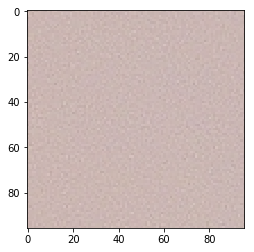

--------------------------------------------------------------------------------------


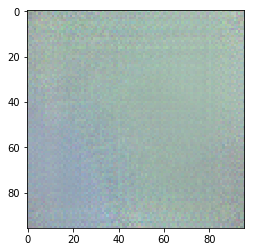

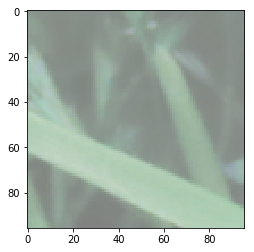

--------------------------------------------------------------------------------------


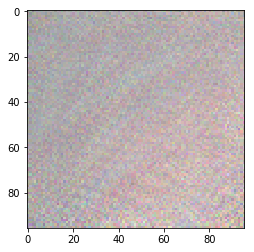

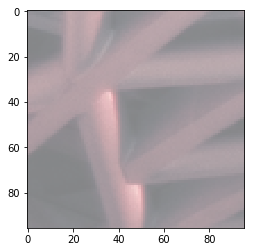

--------------------------------------------------------------------------------------


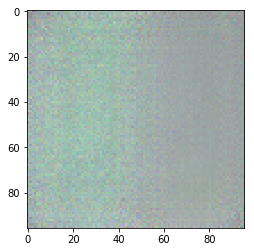

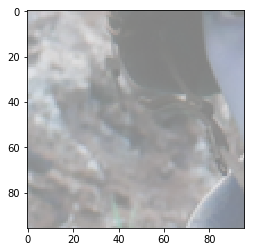

--------------------------------------------------------------------------------------


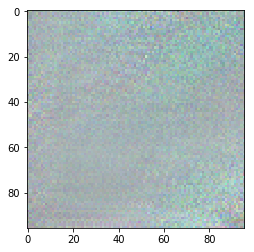

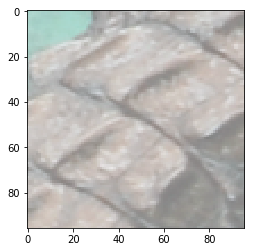

--------------------------------------------------------------------------------------


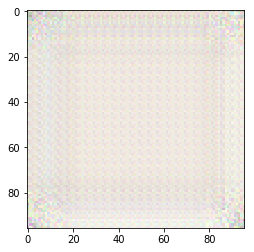

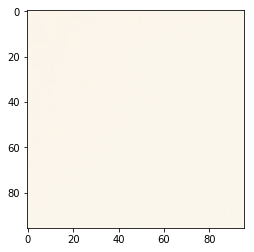

--------------------------------------------------------------------------------------


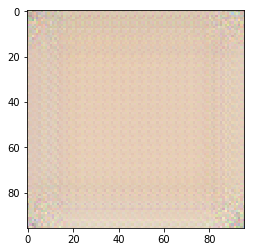

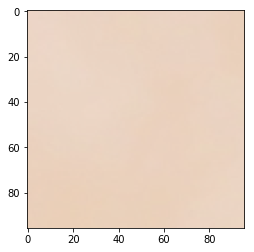

--------------------------------------------------------------------------------------


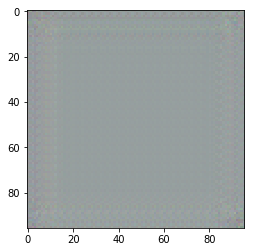

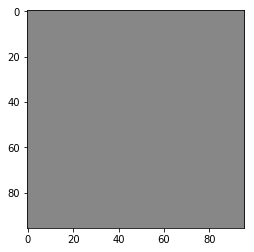

--------------------------------------------------------------------------------------


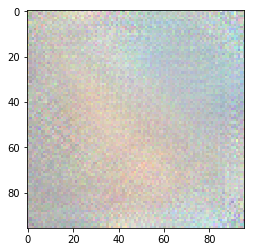

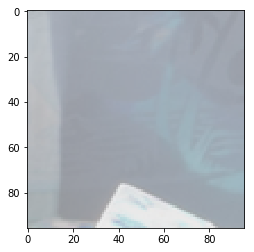

--------------------------------------------------------------------------------------


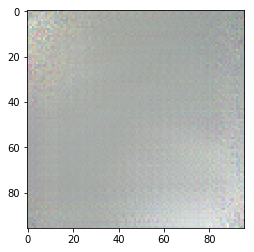

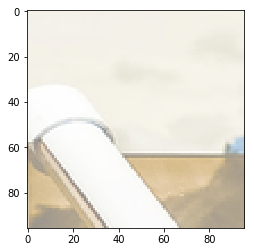

--------------------------------------------------------------------------------------
Epoch 35/50:
Train Loss: 0.2310
Test(Validation) Loss: 0.2332
Training...


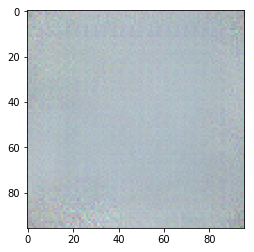

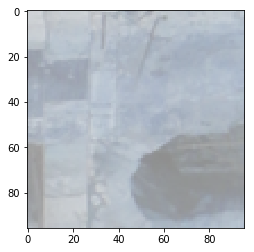

--------------------------------------------------------------------------------------


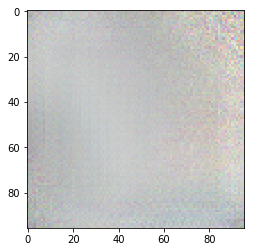

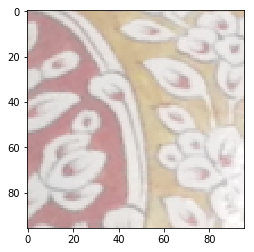

--------------------------------------------------------------------------------------
Testing...


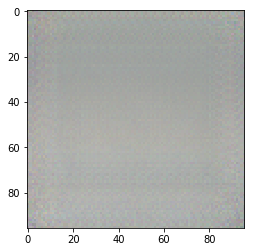

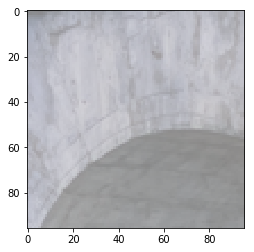

--------------------------------------------------------------------------------------


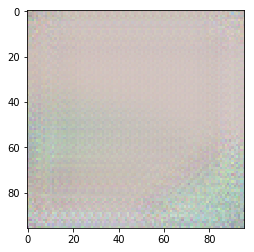

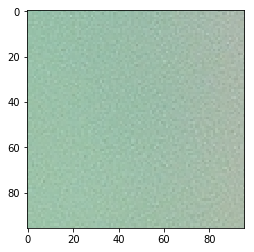

--------------------------------------------------------------------------------------


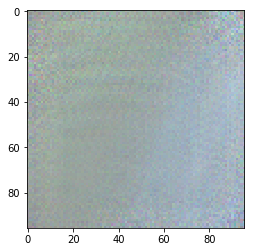

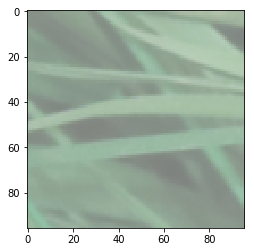

--------------------------------------------------------------------------------------


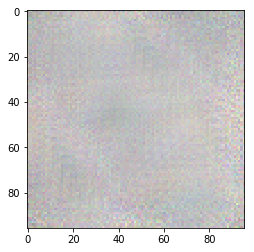

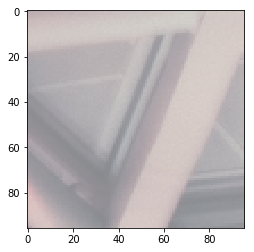

--------------------------------------------------------------------------------------


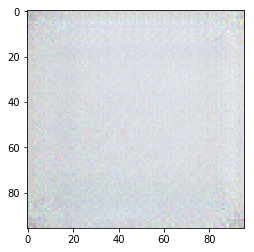

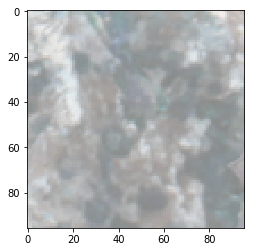

--------------------------------------------------------------------------------------


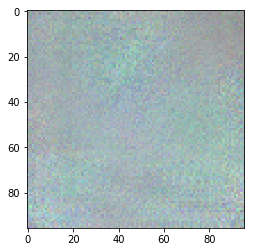

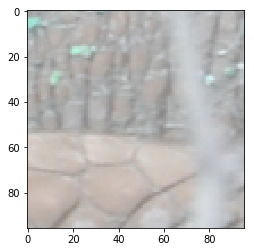

--------------------------------------------------------------------------------------


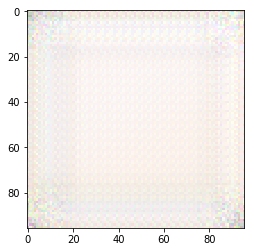

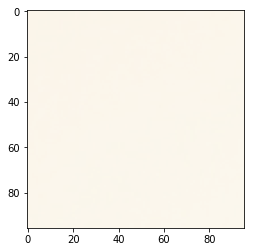

--------------------------------------------------------------------------------------


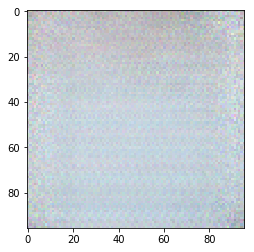

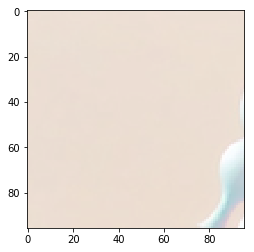

--------------------------------------------------------------------------------------


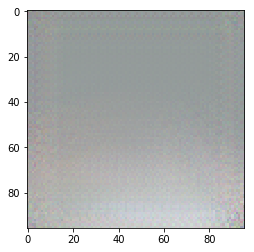

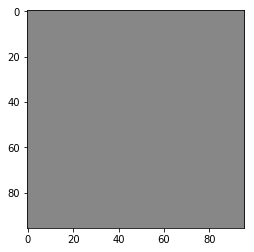

--------------------------------------------------------------------------------------


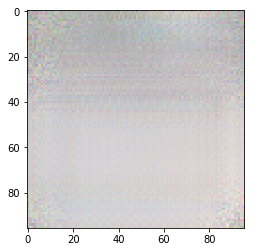

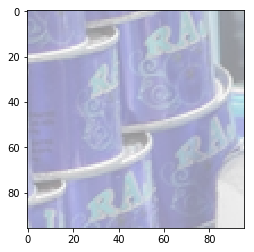

--------------------------------------------------------------------------------------


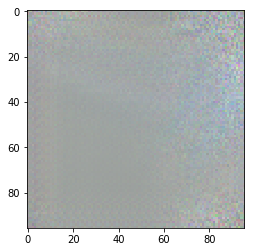

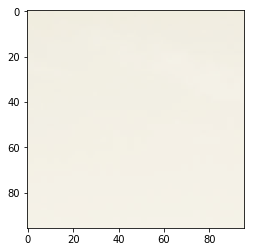

--------------------------------------------------------------------------------------
Epoch 36/50:
Train Loss: 0.2230
Test(Validation) Loss: 0.2276
Training...


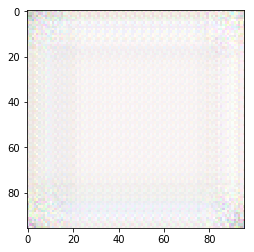

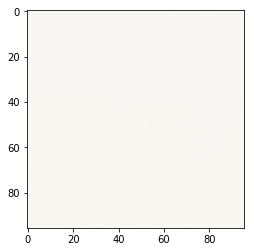

--------------------------------------------------------------------------------------


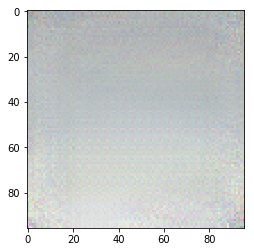

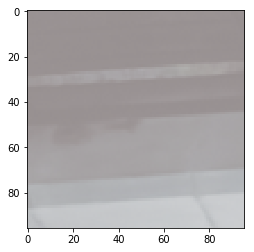

--------------------------------------------------------------------------------------
Testing...


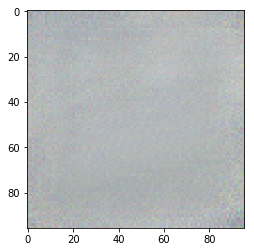

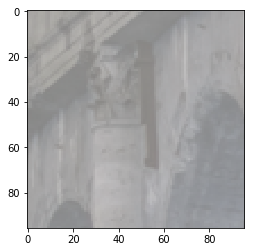

--------------------------------------------------------------------------------------


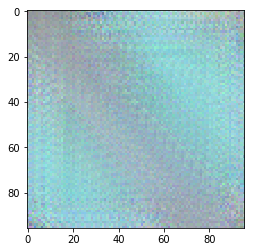

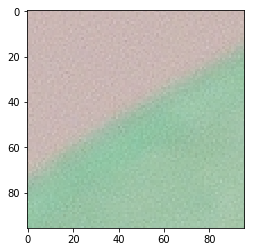

--------------------------------------------------------------------------------------


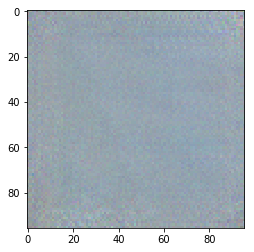

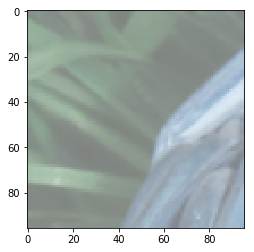

--------------------------------------------------------------------------------------


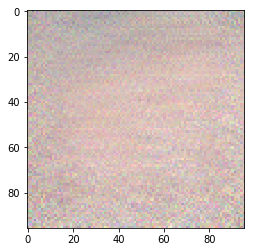

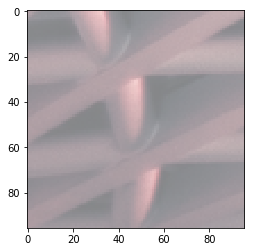

--------------------------------------------------------------------------------------


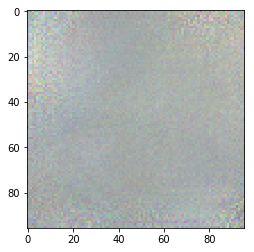

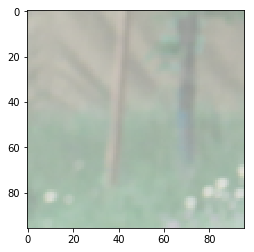

--------------------------------------------------------------------------------------


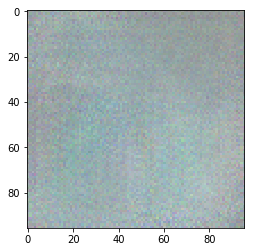

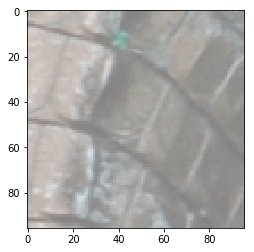

--------------------------------------------------------------------------------------


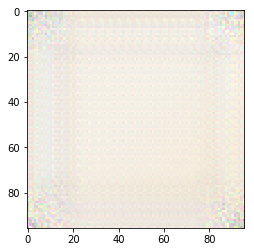

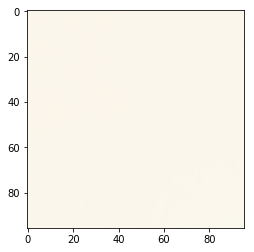

--------------------------------------------------------------------------------------


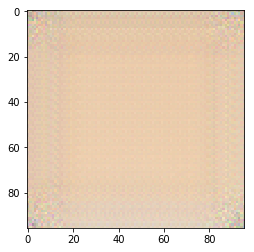

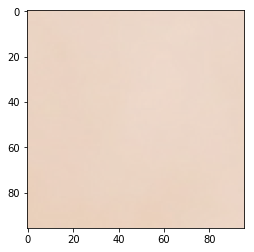

--------------------------------------------------------------------------------------


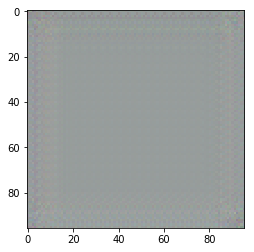

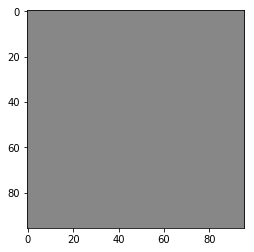

--------------------------------------------------------------------------------------


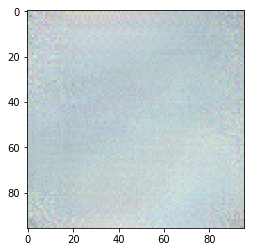

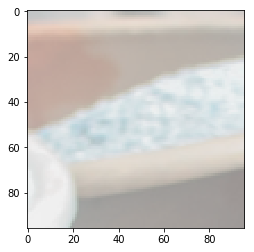

--------------------------------------------------------------------------------------


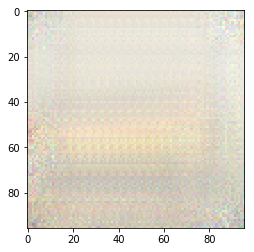

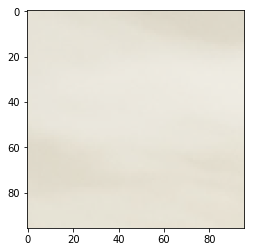

--------------------------------------------------------------------------------------
Epoch 37/50:
Train Loss: 0.2277
Test(Validation) Loss: 0.2081
Training...


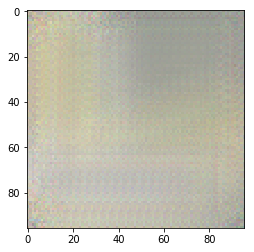

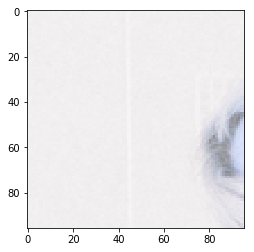

--------------------------------------------------------------------------------------


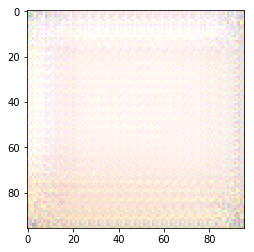

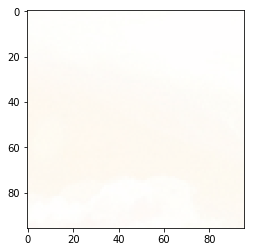

--------------------------------------------------------------------------------------
Testing...


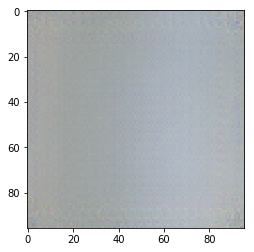

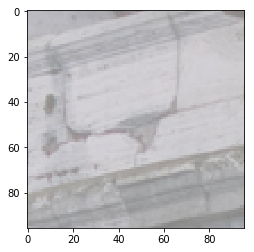

--------------------------------------------------------------------------------------


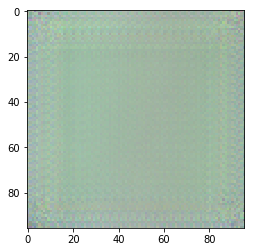

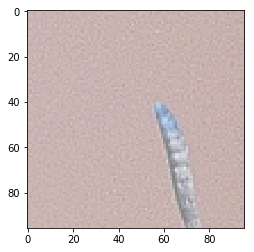

--------------------------------------------------------------------------------------


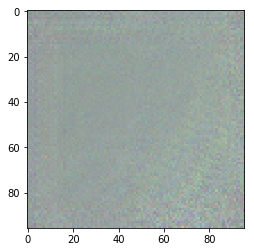

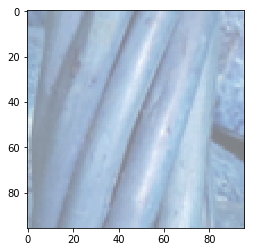

--------------------------------------------------------------------------------------


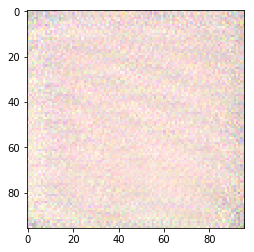

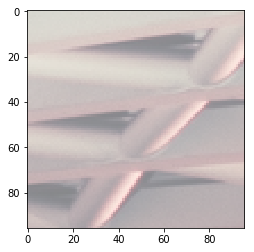

--------------------------------------------------------------------------------------


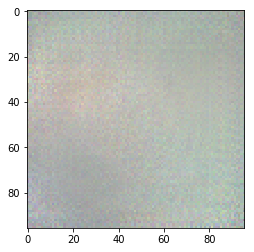

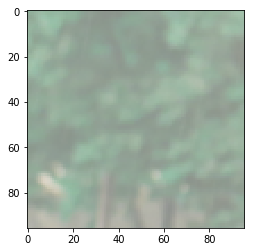

--------------------------------------------------------------------------------------


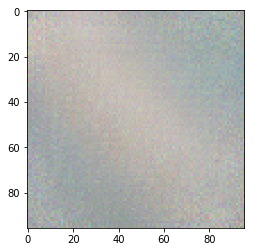

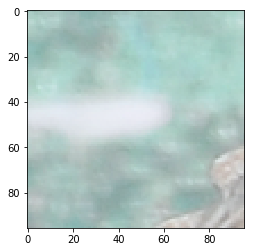

--------------------------------------------------------------------------------------


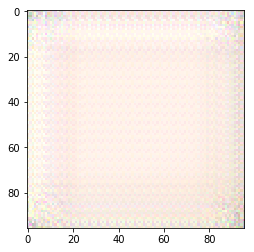

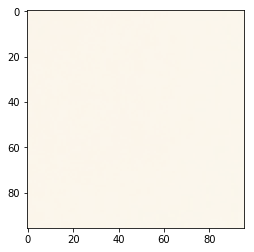

--------------------------------------------------------------------------------------


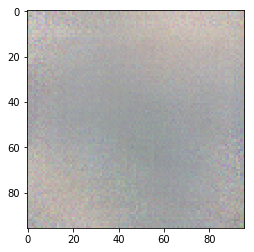

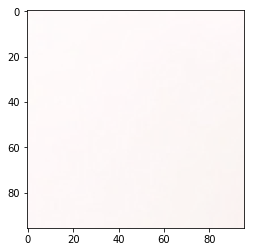

--------------------------------------------------------------------------------------


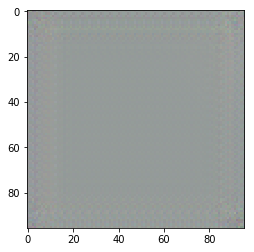

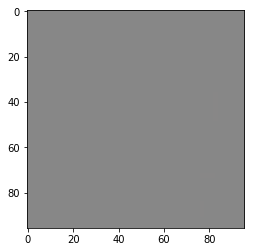

--------------------------------------------------------------------------------------


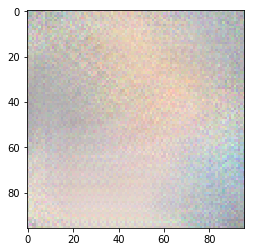

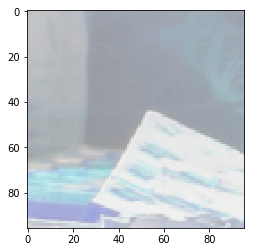

--------------------------------------------------------------------------------------


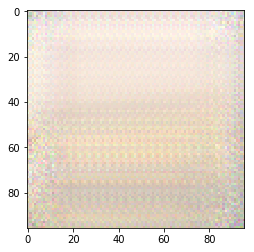

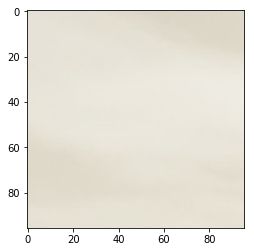

--------------------------------------------------------------------------------------
Epoch 38/50:
Train Loss: 0.2255
Test(Validation) Loss: 0.2224
Training...


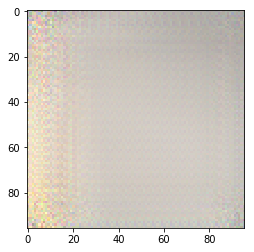

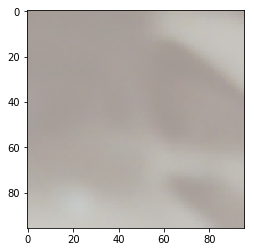

--------------------------------------------------------------------------------------


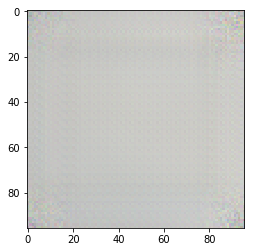

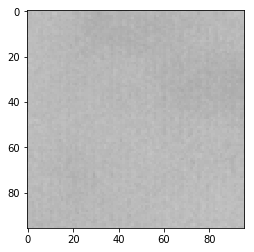

--------------------------------------------------------------------------------------
Testing...


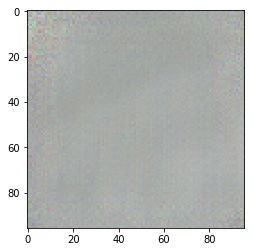

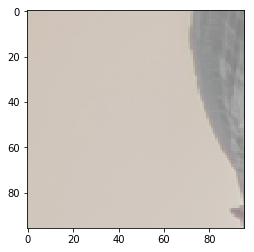

--------------------------------------------------------------------------------------


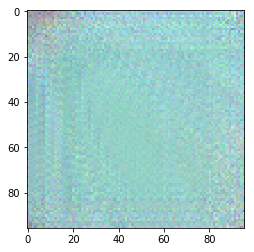

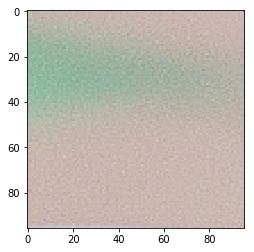

--------------------------------------------------------------------------------------


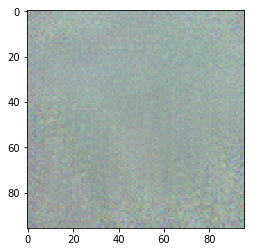

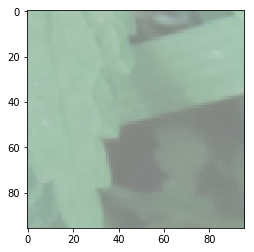

--------------------------------------------------------------------------------------


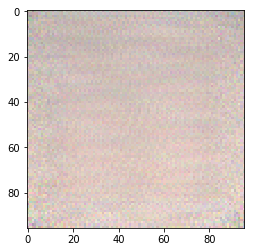

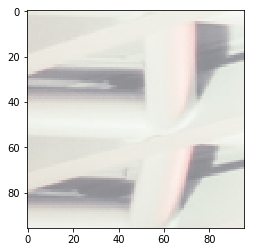

--------------------------------------------------------------------------------------


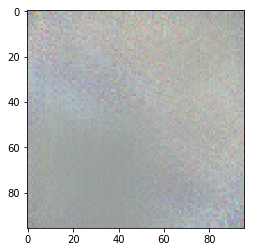

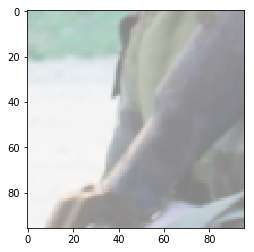

--------------------------------------------------------------------------------------


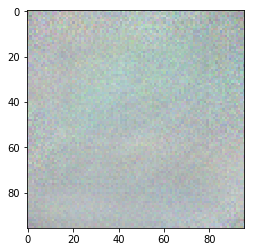

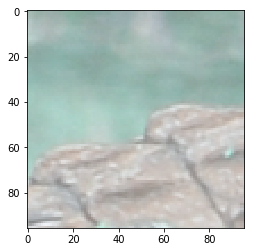

--------------------------------------------------------------------------------------


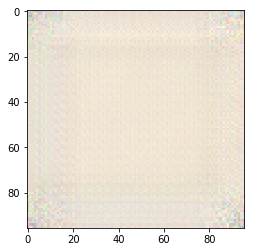

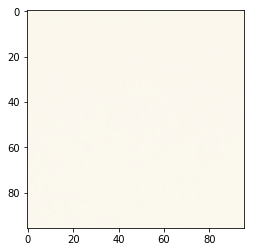

--------------------------------------------------------------------------------------


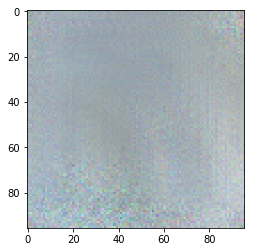

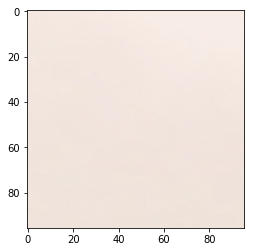

--------------------------------------------------------------------------------------


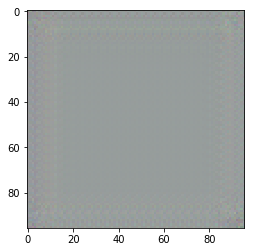

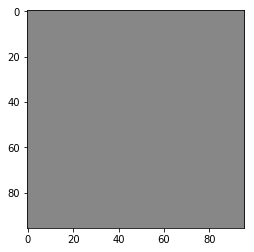

--------------------------------------------------------------------------------------


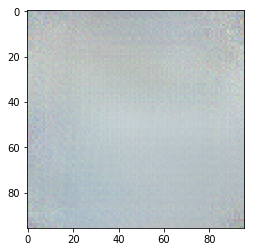

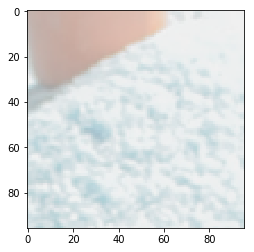

--------------------------------------------------------------------------------------


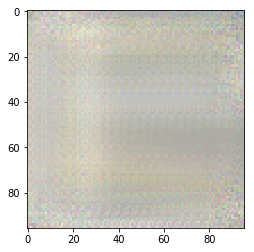

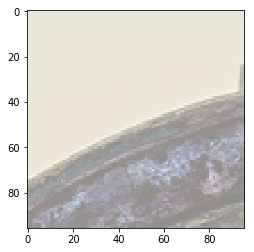

--------------------------------------------------------------------------------------
Epoch 39/50:
Train Loss: 0.2197
Test(Validation) Loss: 0.2262
Training...


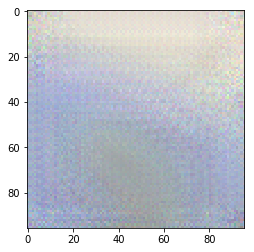

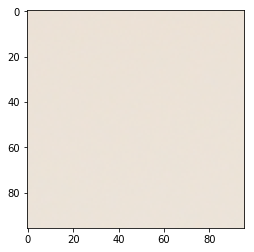

--------------------------------------------------------------------------------------


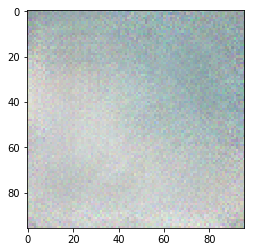

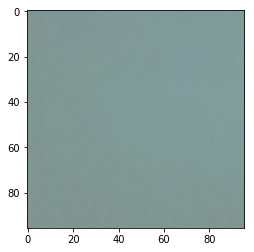

--------------------------------------------------------------------------------------
Testing...


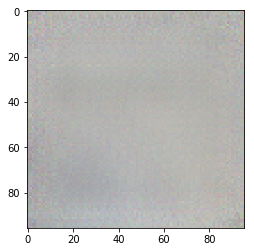

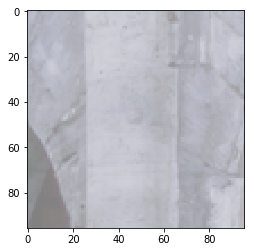

--------------------------------------------------------------------------------------


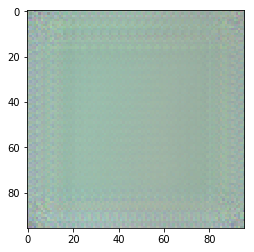

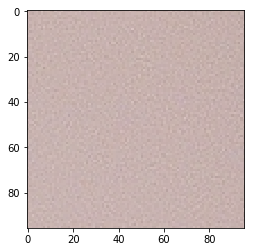

--------------------------------------------------------------------------------------


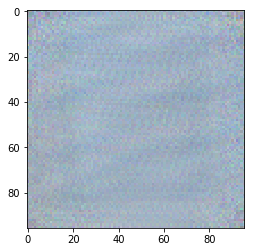

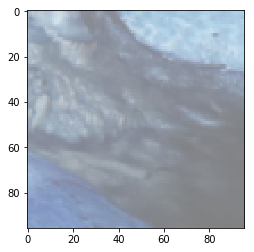

--------------------------------------------------------------------------------------


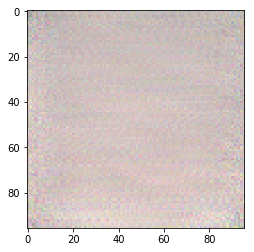

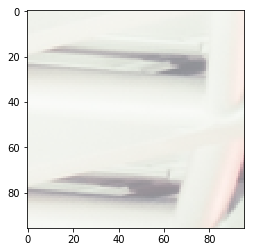

--------------------------------------------------------------------------------------


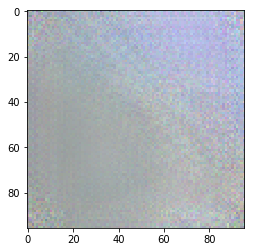

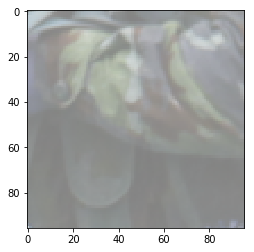

--------------------------------------------------------------------------------------


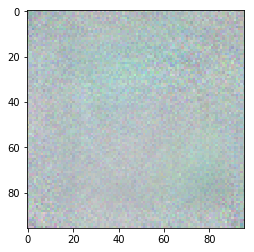

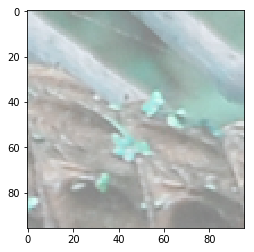

--------------------------------------------------------------------------------------


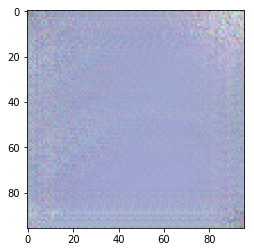

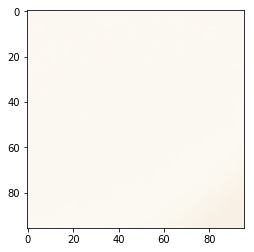

--------------------------------------------------------------------------------------


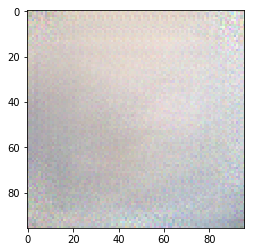

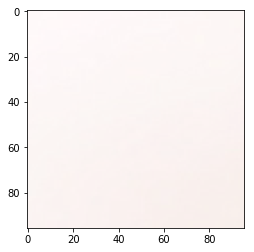

--------------------------------------------------------------------------------------


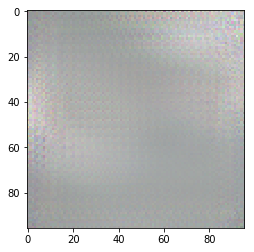

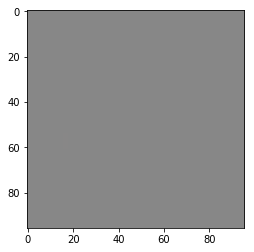

--------------------------------------------------------------------------------------


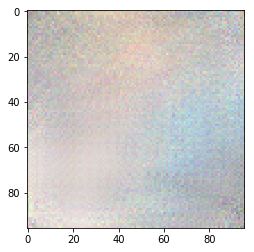

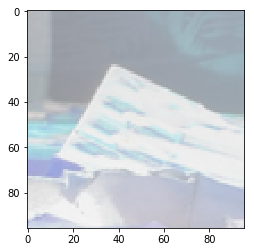

--------------------------------------------------------------------------------------


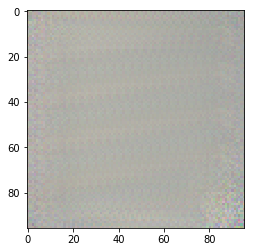

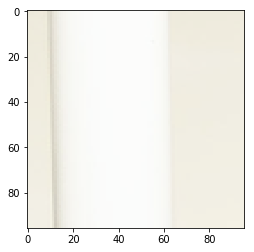

--------------------------------------------------------------------------------------
Epoch 40/50:
Train Loss: 0.2225
Test(Validation) Loss: 0.2266
[40 / 50] 	Learning_rate: 0.0001	 train_loss: 0.2225	 test_loss: 0.2266


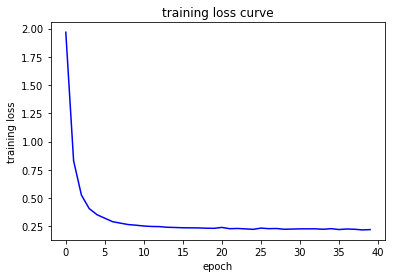

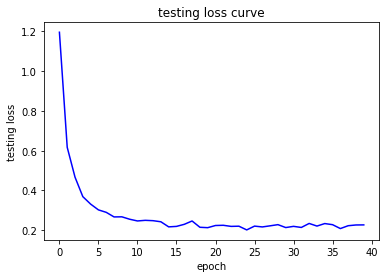

Training...


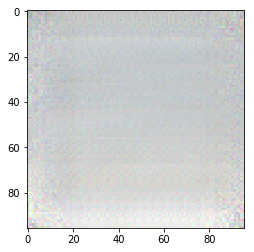

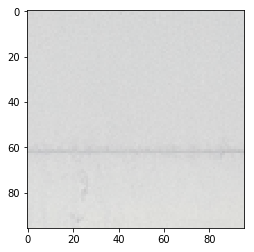

--------------------------------------------------------------------------------------


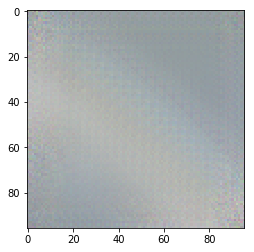

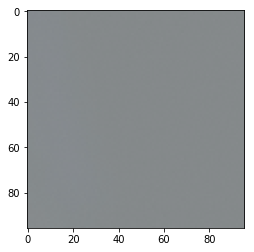

--------------------------------------------------------------------------------------
Testing...


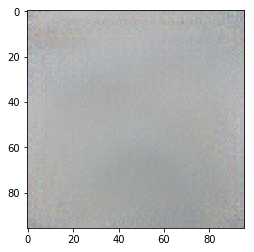

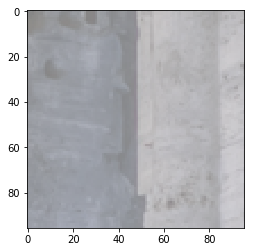

--------------------------------------------------------------------------------------


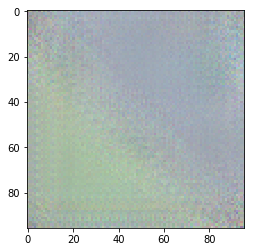

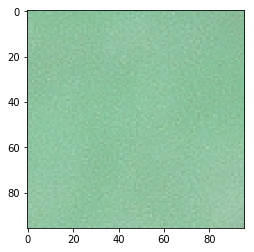

--------------------------------------------------------------------------------------


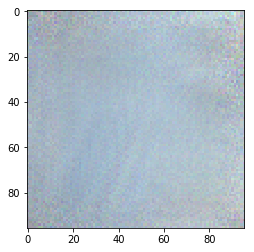

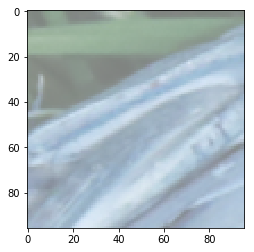

--------------------------------------------------------------------------------------


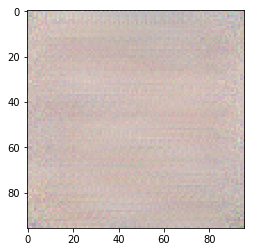

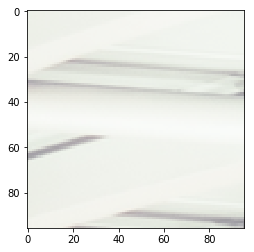

--------------------------------------------------------------------------------------


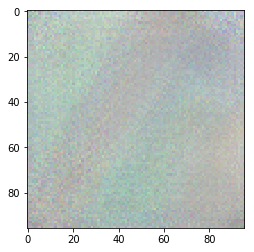

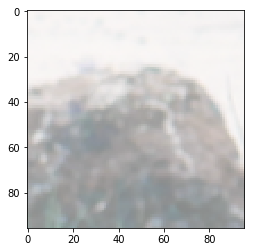

--------------------------------------------------------------------------------------


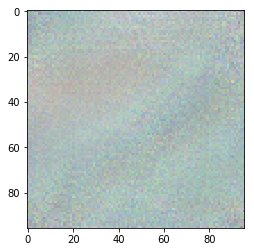

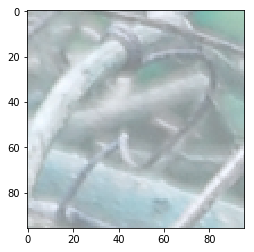

--------------------------------------------------------------------------------------


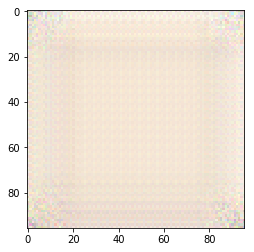

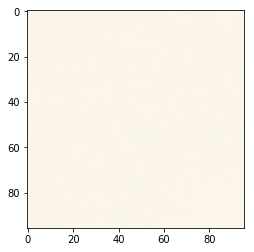

--------------------------------------------------------------------------------------


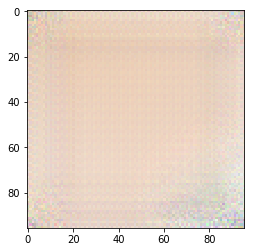

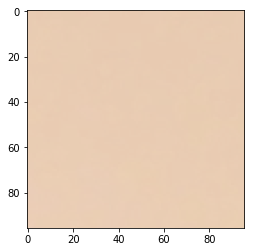

--------------------------------------------------------------------------------------


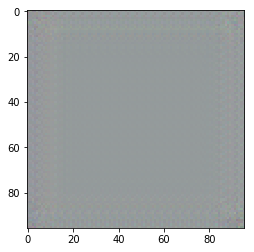

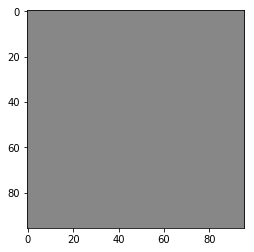

--------------------------------------------------------------------------------------


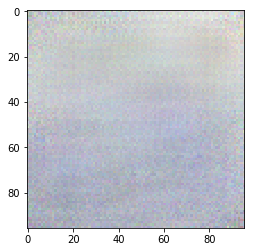

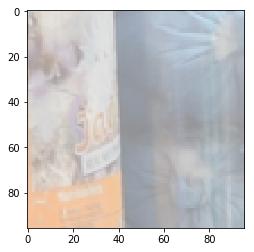

--------------------------------------------------------------------------------------


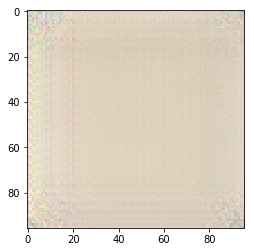

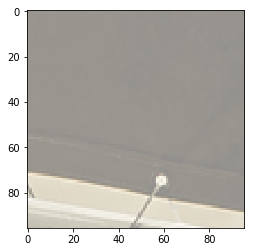

--------------------------------------------------------------------------------------
Epoch 41/50:
Train Loss: 0.2186
Test(Validation) Loss: 0.2164
Training...


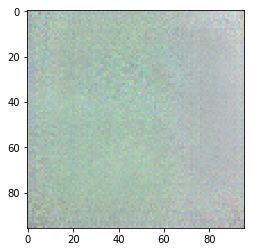

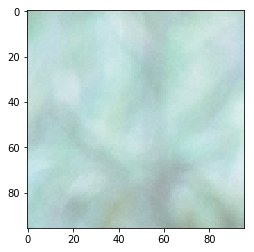

--------------------------------------------------------------------------------------


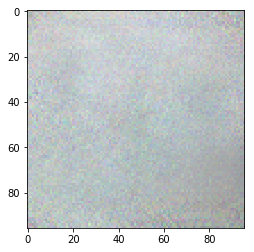

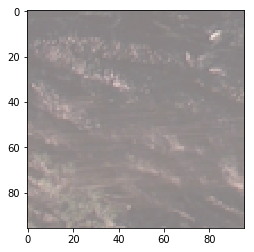

--------------------------------------------------------------------------------------
Testing...


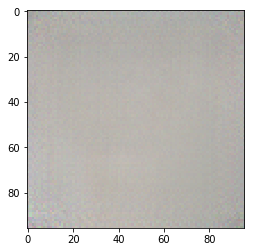

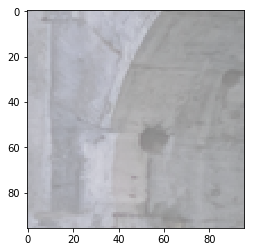

--------------------------------------------------------------------------------------


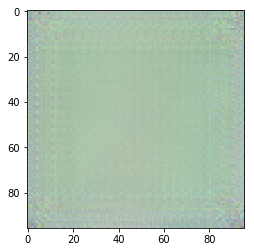

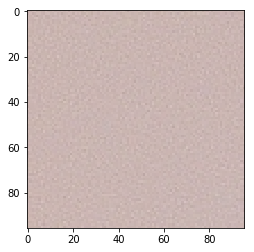

--------------------------------------------------------------------------------------


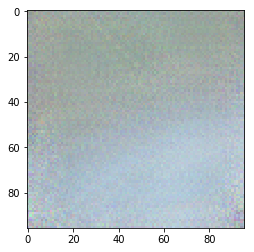

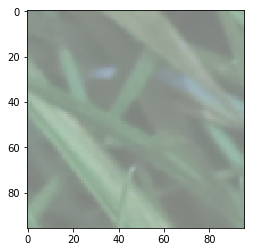

--------------------------------------------------------------------------------------


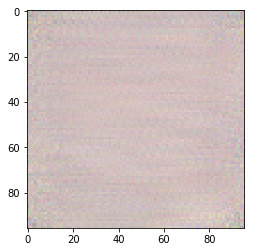

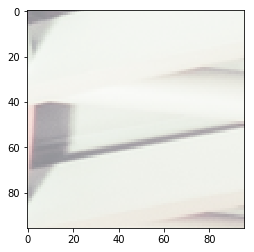

--------------------------------------------------------------------------------------


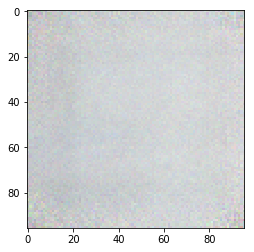

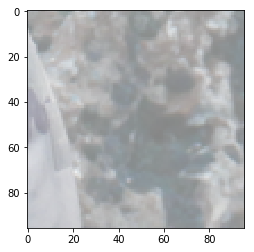

--------------------------------------------------------------------------------------


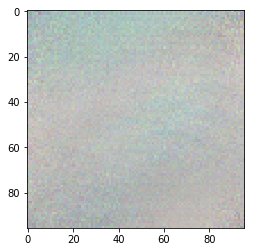

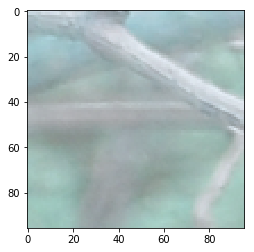

--------------------------------------------------------------------------------------


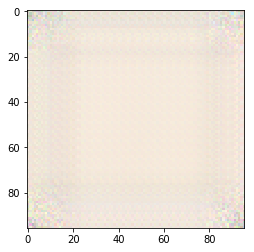

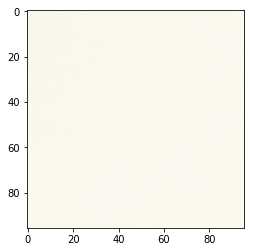

--------------------------------------------------------------------------------------


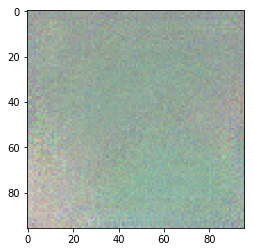

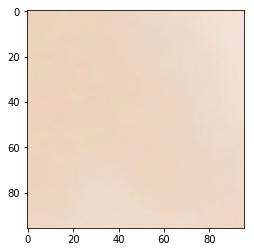

--------------------------------------------------------------------------------------


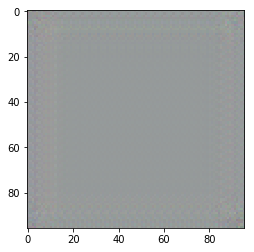

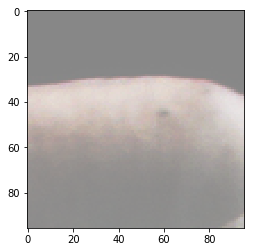

--------------------------------------------------------------------------------------


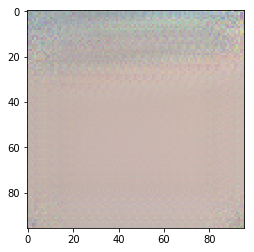

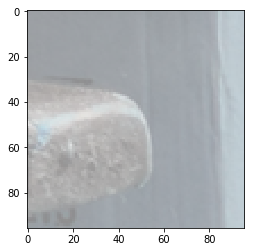

--------------------------------------------------------------------------------------


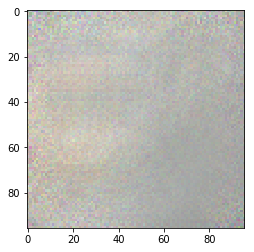

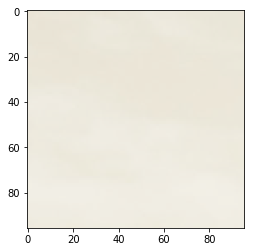

--------------------------------------------------------------------------------------
Epoch 42/50:
Train Loss: 0.2225
Test(Validation) Loss: 0.2173
Training...


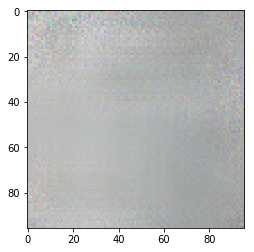

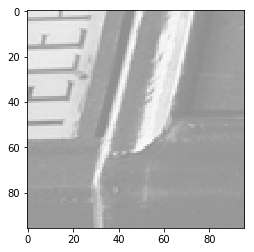

--------------------------------------------------------------------------------------


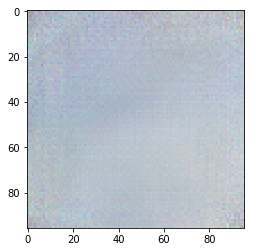

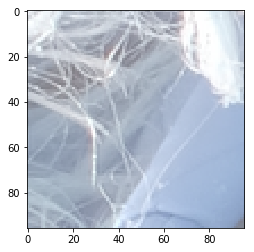

--------------------------------------------------------------------------------------
Testing...


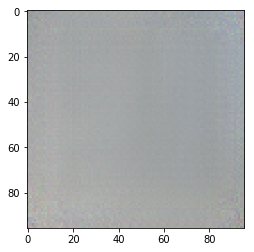

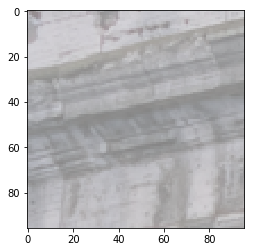

--------------------------------------------------------------------------------------


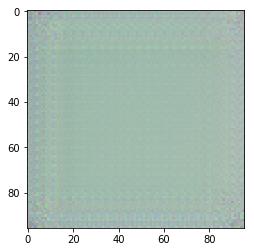

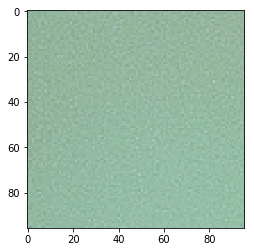

--------------------------------------------------------------------------------------


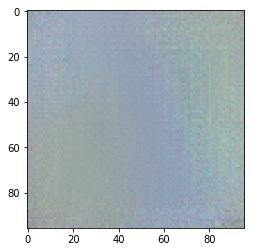

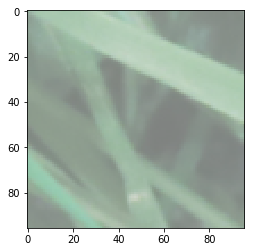

--------------------------------------------------------------------------------------


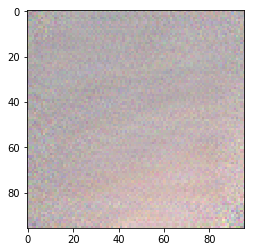

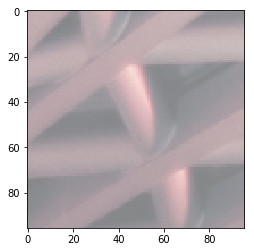

--------------------------------------------------------------------------------------


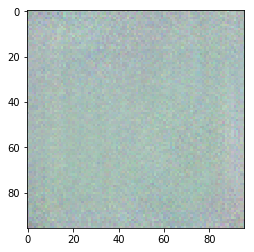

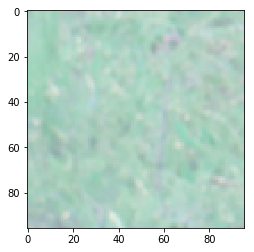

--------------------------------------------------------------------------------------


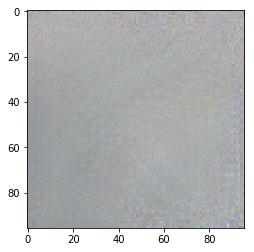

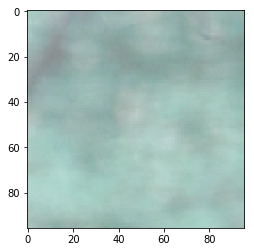

--------------------------------------------------------------------------------------


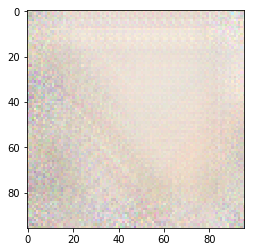

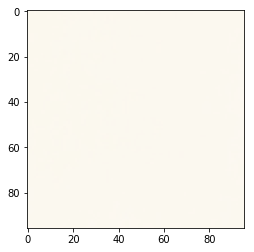

--------------------------------------------------------------------------------------


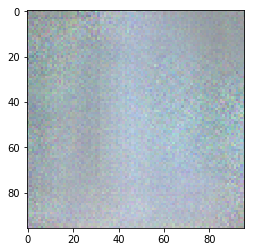

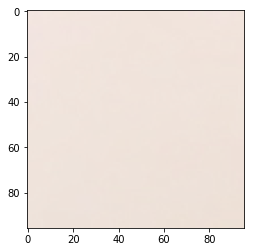

--------------------------------------------------------------------------------------


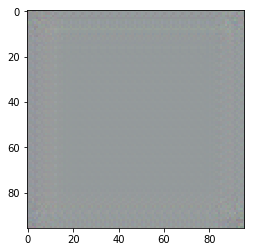

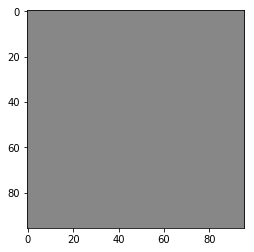

--------------------------------------------------------------------------------------


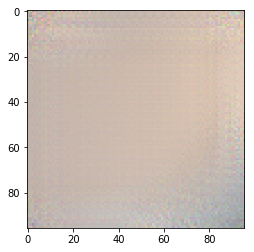

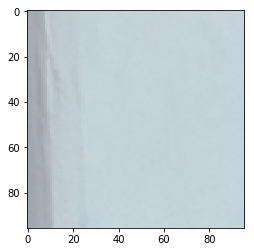

--------------------------------------------------------------------------------------


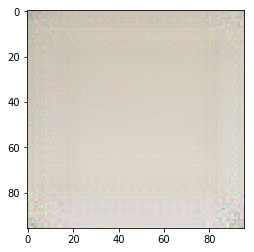

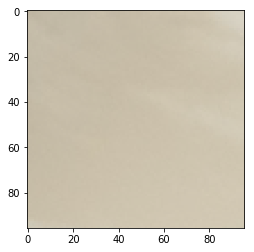

--------------------------------------------------------------------------------------
Epoch 43/50:
Train Loss: 0.2267
Test(Validation) Loss: 0.2062
Training...


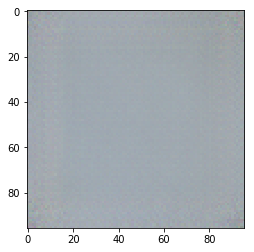

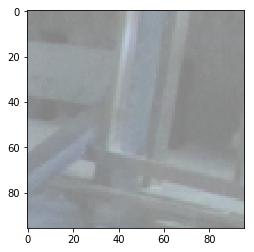

--------------------------------------------------------------------------------------


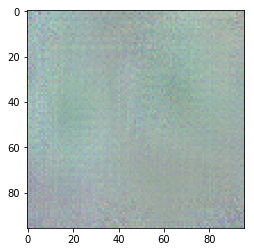

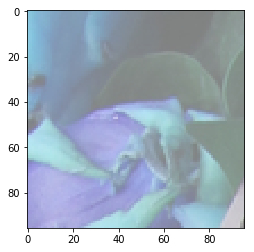

--------------------------------------------------------------------------------------
Testing...


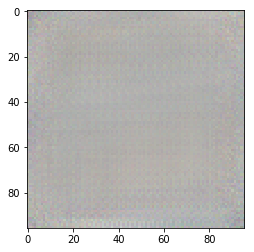

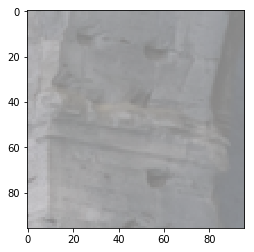

--------------------------------------------------------------------------------------


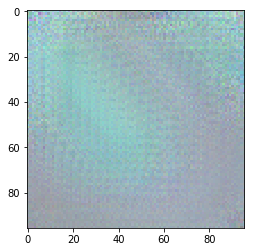

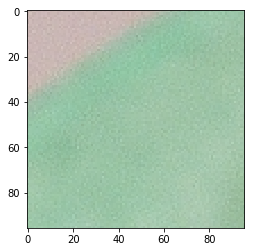

--------------------------------------------------------------------------------------


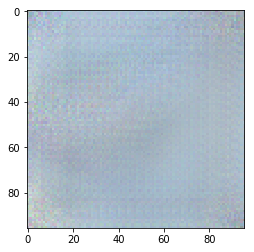

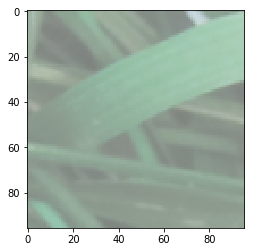

--------------------------------------------------------------------------------------


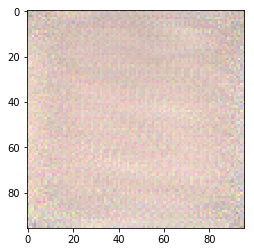

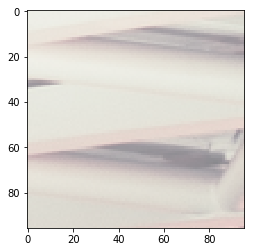

--------------------------------------------------------------------------------------


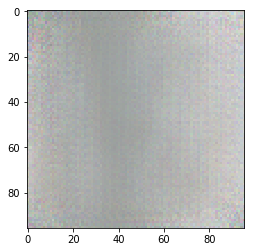

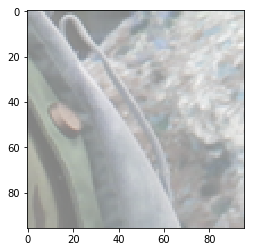

--------------------------------------------------------------------------------------


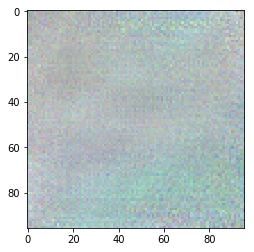

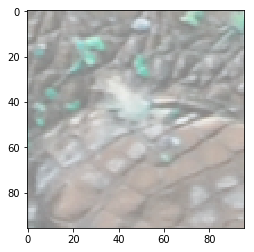

--------------------------------------------------------------------------------------


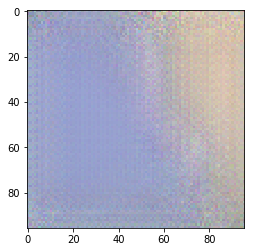

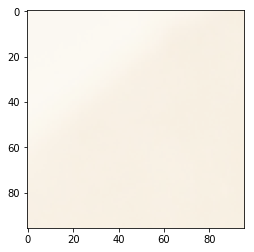

--------------------------------------------------------------------------------------


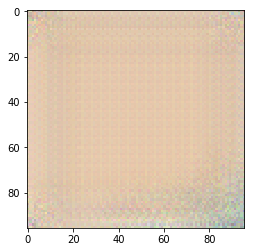

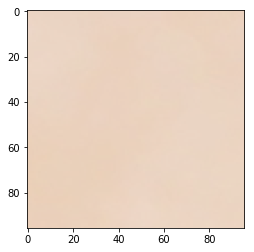

--------------------------------------------------------------------------------------


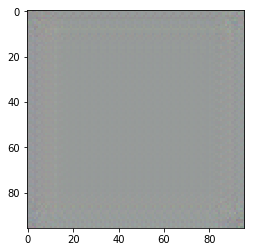

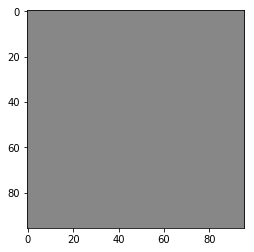

--------------------------------------------------------------------------------------


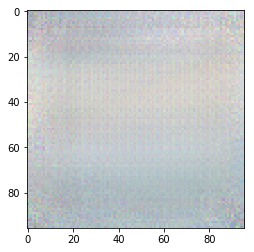

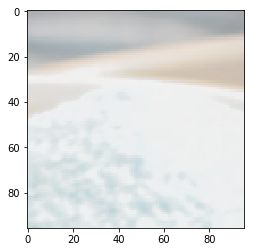

--------------------------------------------------------------------------------------


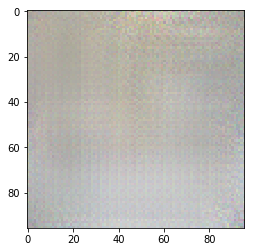

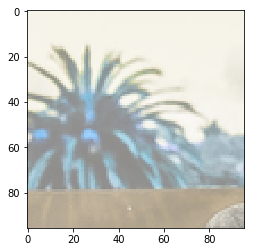

--------------------------------------------------------------------------------------
Epoch 44/50:
Train Loss: 0.2238
Test(Validation) Loss: 0.2193
Training...


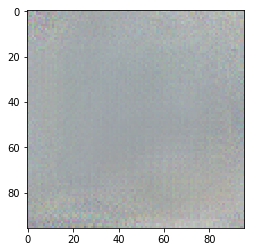

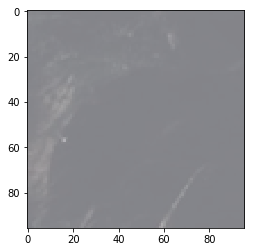

--------------------------------------------------------------------------------------


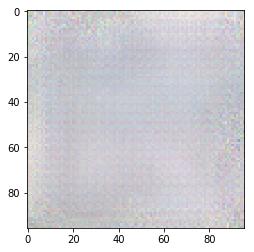

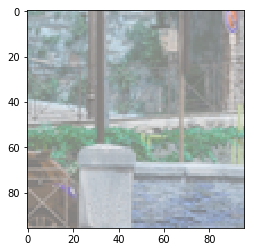

--------------------------------------------------------------------------------------
Testing...


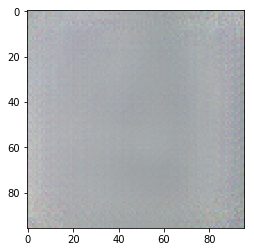

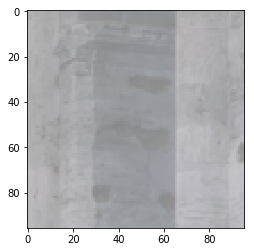

--------------------------------------------------------------------------------------


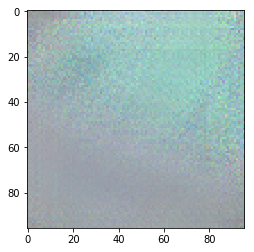

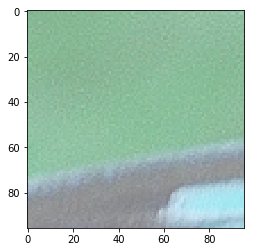

--------------------------------------------------------------------------------------


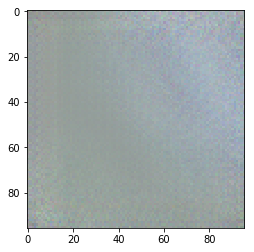

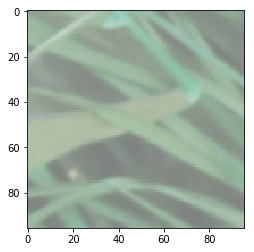

--------------------------------------------------------------------------------------


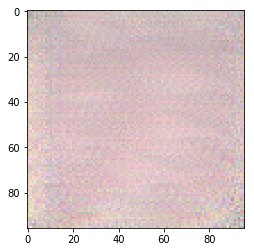

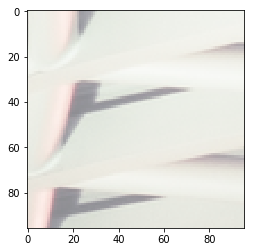

--------------------------------------------------------------------------------------


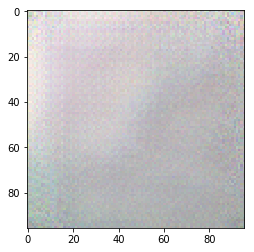

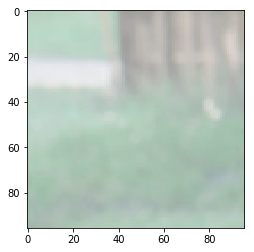

--------------------------------------------------------------------------------------


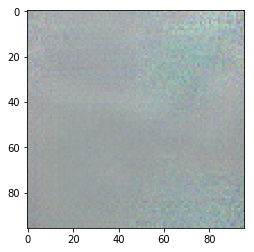

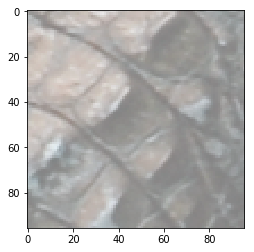

--------------------------------------------------------------------------------------


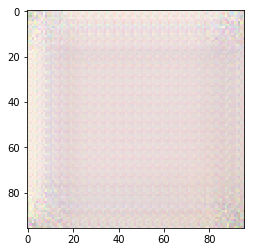

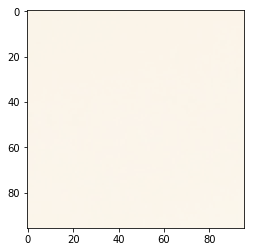

--------------------------------------------------------------------------------------


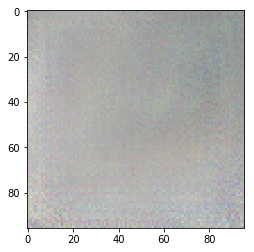

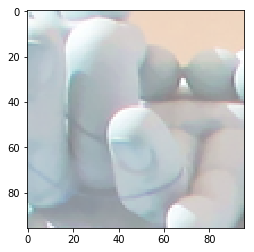

--------------------------------------------------------------------------------------


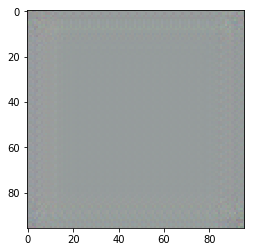

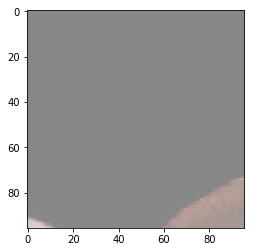

--------------------------------------------------------------------------------------


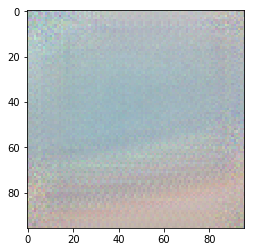

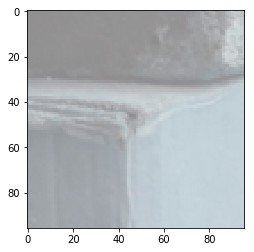

--------------------------------------------------------------------------------------


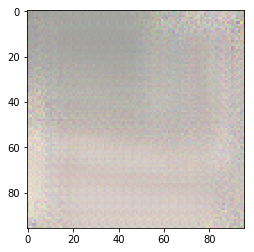

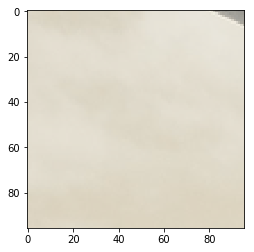

--------------------------------------------------------------------------------------
Epoch 45/50:
Train Loss: 0.2225
Test(Validation) Loss: 0.2141
Training...


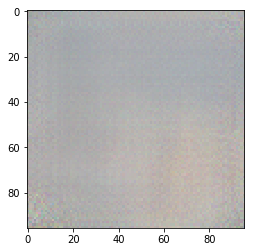

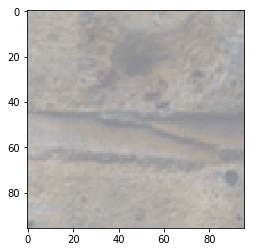

--------------------------------------------------------------------------------------


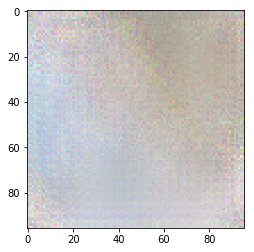

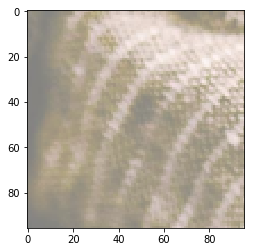

--------------------------------------------------------------------------------------
Testing...


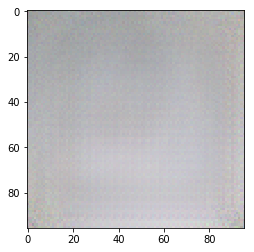

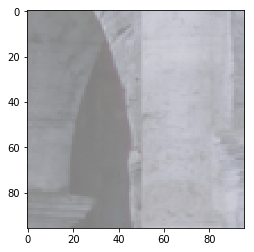

--------------------------------------------------------------------------------------


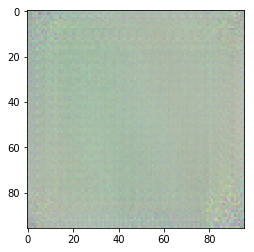

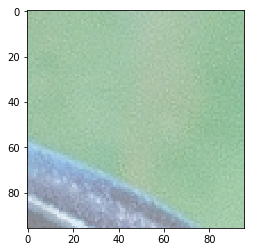

--------------------------------------------------------------------------------------


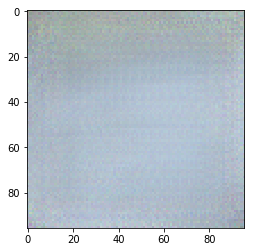

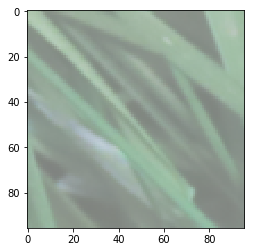

--------------------------------------------------------------------------------------


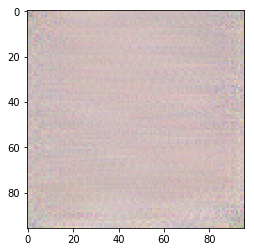

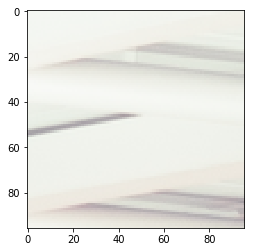

--------------------------------------------------------------------------------------


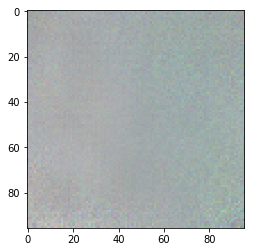

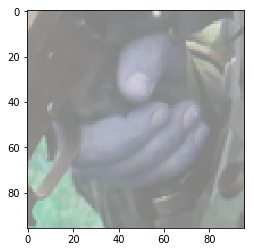

--------------------------------------------------------------------------------------


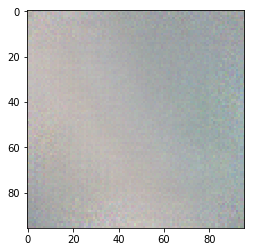

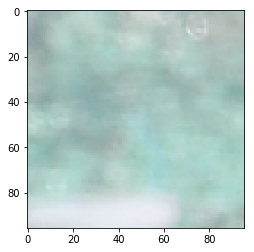

--------------------------------------------------------------------------------------


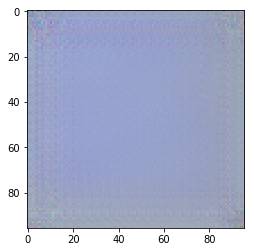

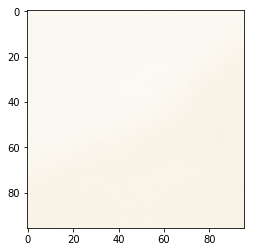

--------------------------------------------------------------------------------------


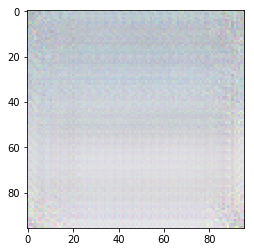

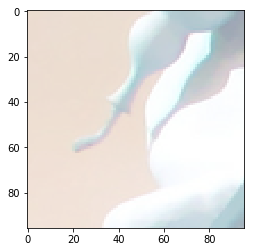

--------------------------------------------------------------------------------------


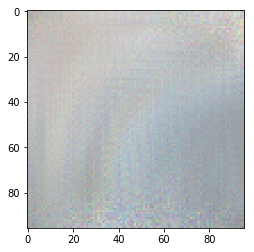

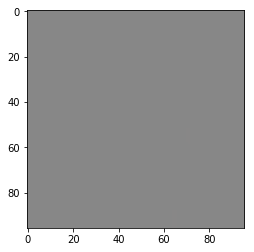

--------------------------------------------------------------------------------------


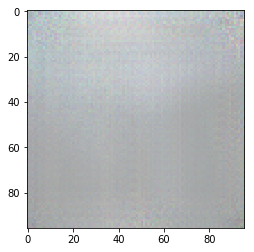

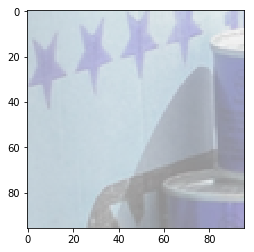

--------------------------------------------------------------------------------------


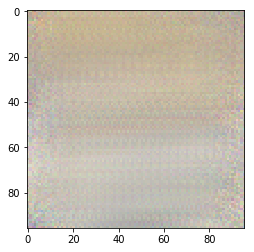

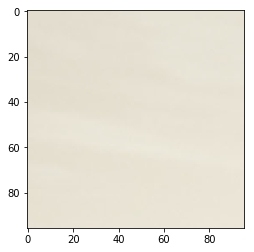

--------------------------------------------------------------------------------------
Epoch 46/50:
Train Loss: 0.2223
Test(Validation) Loss: 0.2300
Training...


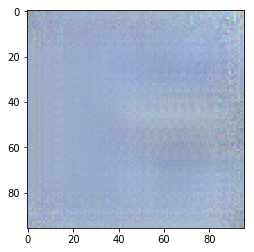

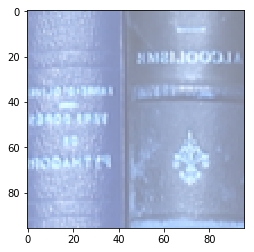

--------------------------------------------------------------------------------------


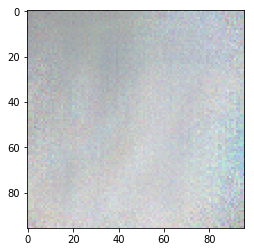

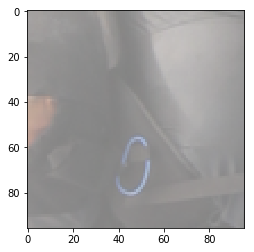

--------------------------------------------------------------------------------------
Testing...


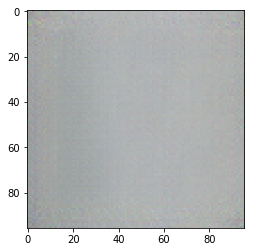

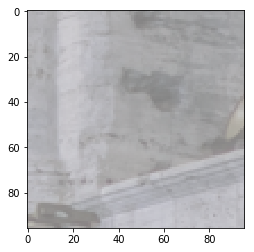

--------------------------------------------------------------------------------------


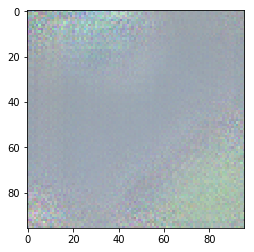

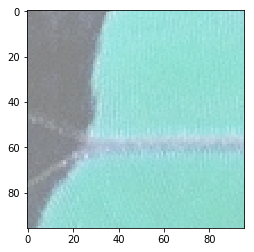

--------------------------------------------------------------------------------------


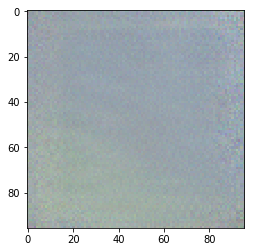

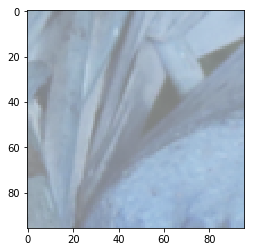

--------------------------------------------------------------------------------------


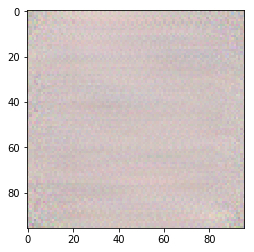

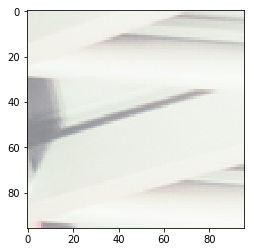

--------------------------------------------------------------------------------------


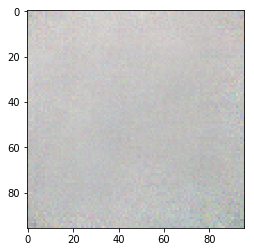

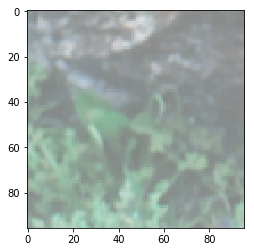

--------------------------------------------------------------------------------------


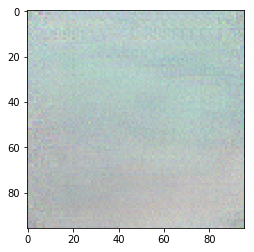

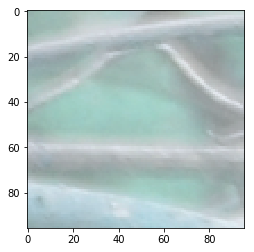

--------------------------------------------------------------------------------------


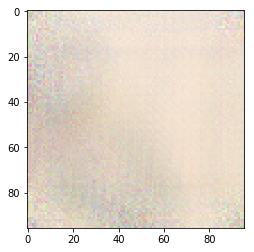

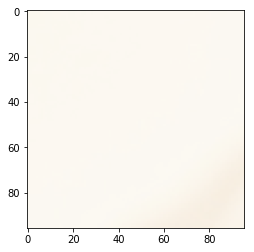

--------------------------------------------------------------------------------------


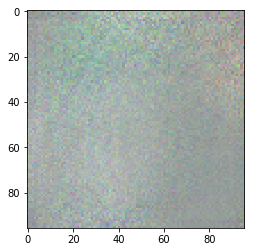

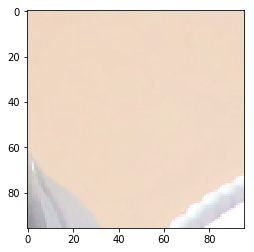

--------------------------------------------------------------------------------------


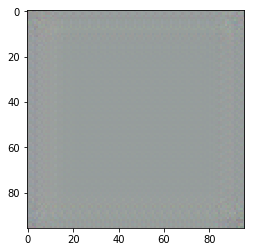

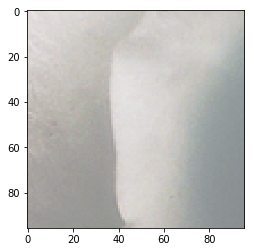

--------------------------------------------------------------------------------------


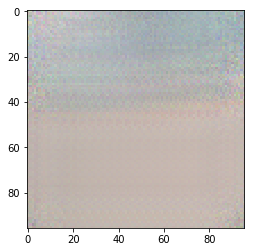

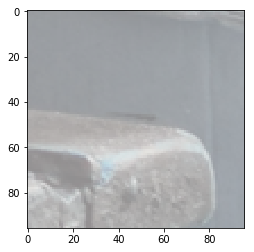

--------------------------------------------------------------------------------------


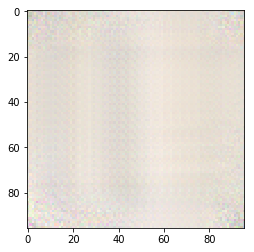

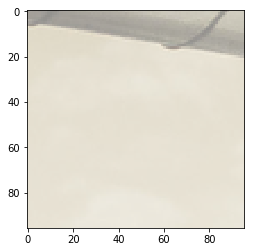

--------------------------------------------------------------------------------------
Epoch 47/50:
Train Loss: 0.2242
Test(Validation) Loss: 0.2231
Training...


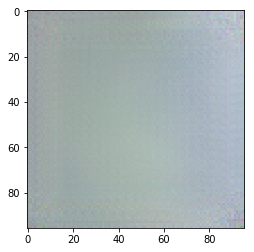

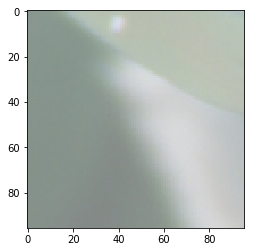

--------------------------------------------------------------------------------------


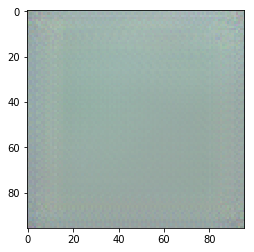

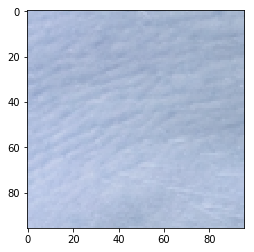

--------------------------------------------------------------------------------------
Testing...


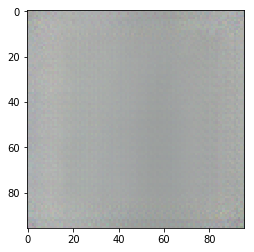

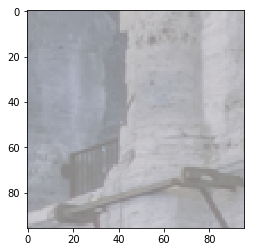

--------------------------------------------------------------------------------------


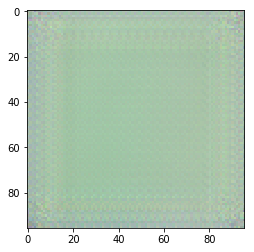

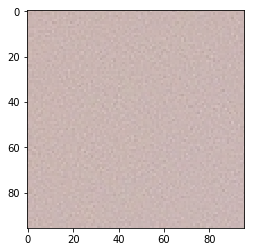

--------------------------------------------------------------------------------------


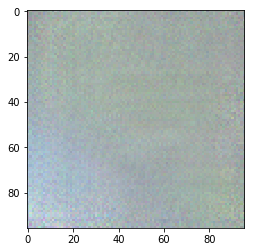

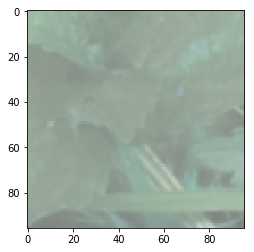

--------------------------------------------------------------------------------------


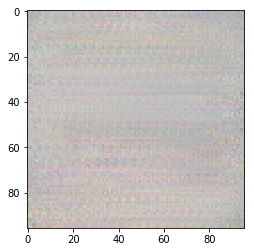

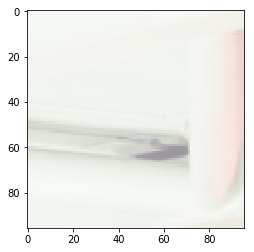

--------------------------------------------------------------------------------------


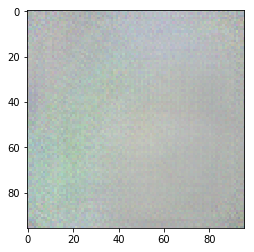

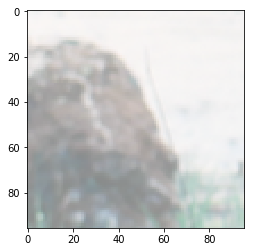

--------------------------------------------------------------------------------------


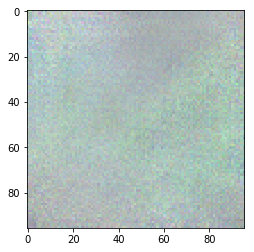

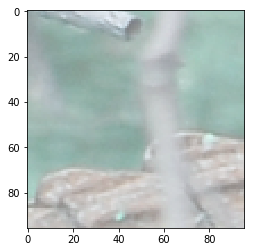

--------------------------------------------------------------------------------------


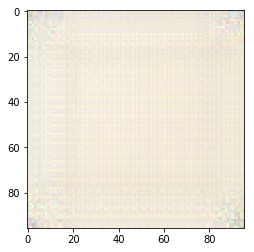

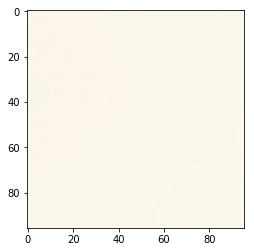

--------------------------------------------------------------------------------------


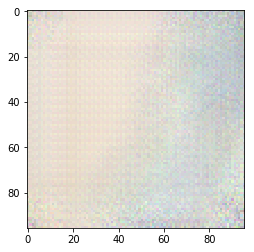

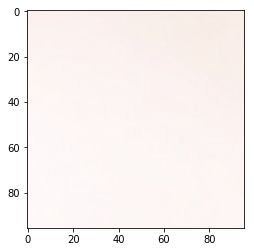

--------------------------------------------------------------------------------------


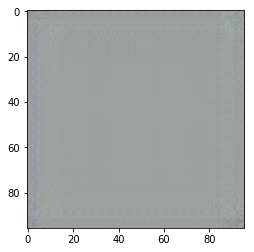

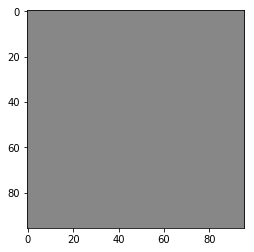

--------------------------------------------------------------------------------------


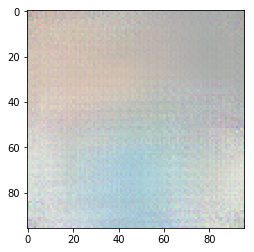

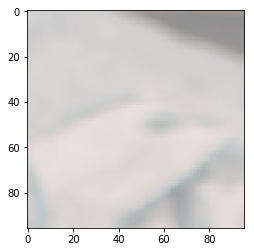

--------------------------------------------------------------------------------------


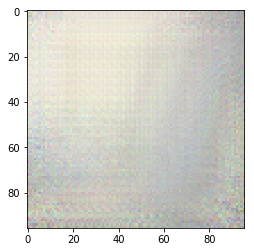

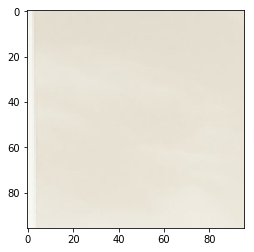

--------------------------------------------------------------------------------------
Epoch 48/50:
Train Loss: 0.2279
Test(Validation) Loss: 0.2255
Training...


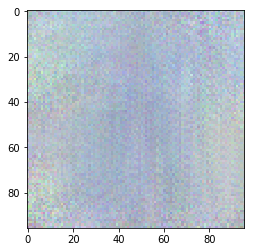

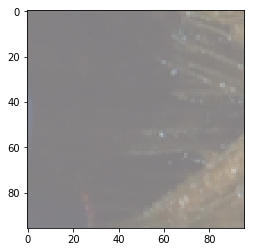

--------------------------------------------------------------------------------------


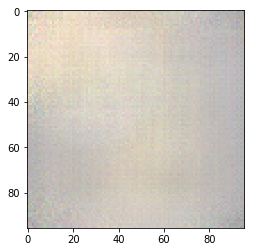

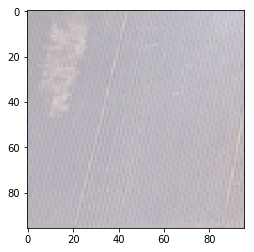

--------------------------------------------------------------------------------------
Testing...


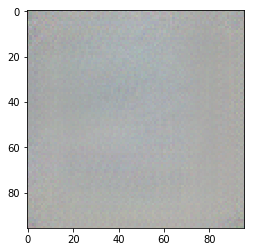

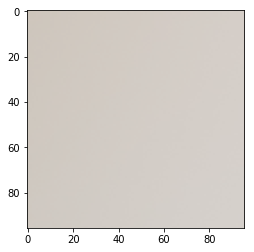

--------------------------------------------------------------------------------------


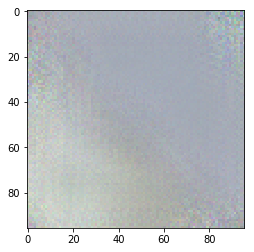

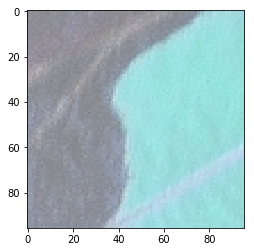

--------------------------------------------------------------------------------------


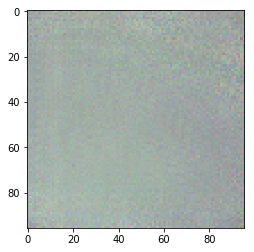

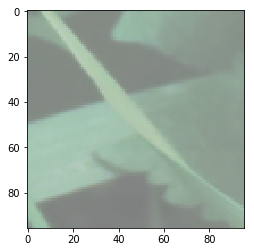

--------------------------------------------------------------------------------------


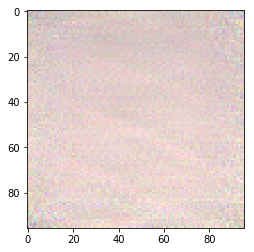

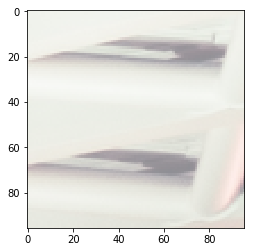

--------------------------------------------------------------------------------------


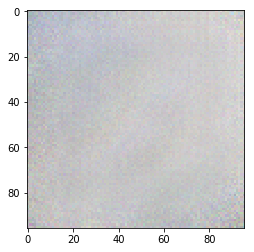

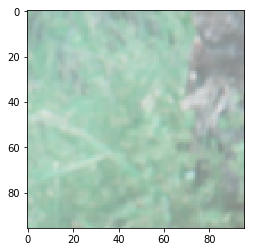

--------------------------------------------------------------------------------------


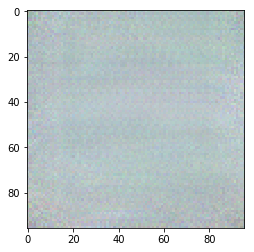

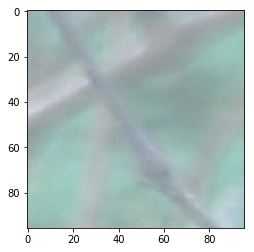

--------------------------------------------------------------------------------------


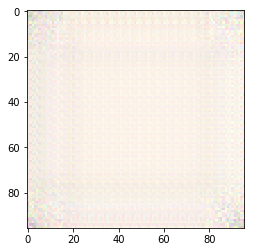

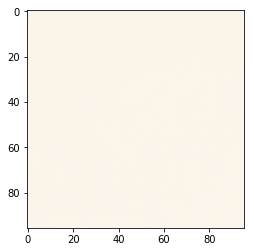

--------------------------------------------------------------------------------------


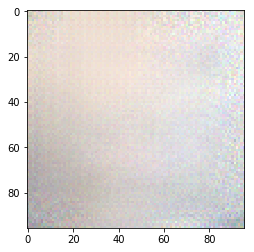

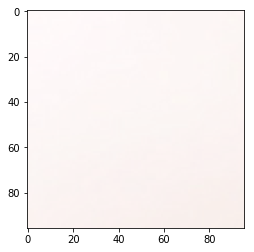

--------------------------------------------------------------------------------------


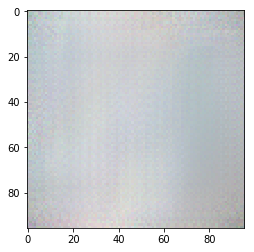

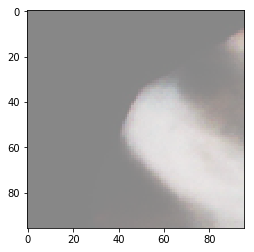

--------------------------------------------------------------------------------------


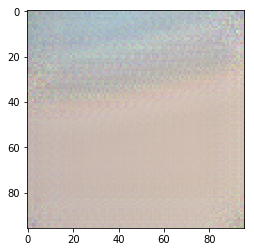

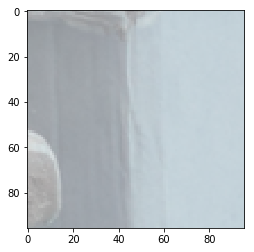

--------------------------------------------------------------------------------------


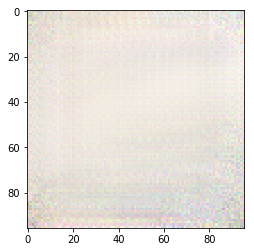

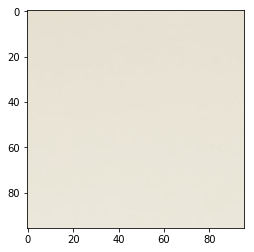

--------------------------------------------------------------------------------------
Epoch 49/50:
Train Loss: 0.2254
Test(Validation) Loss: 0.2121
Training...


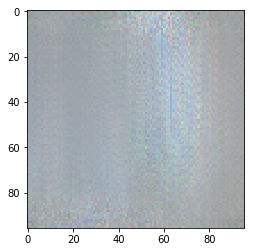

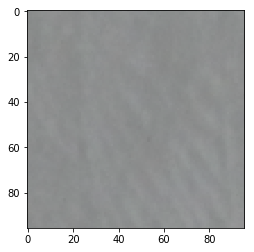

--------------------------------------------------------------------------------------


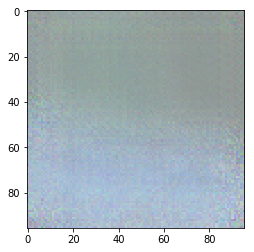

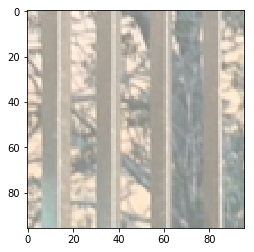

--------------------------------------------------------------------------------------
Testing...


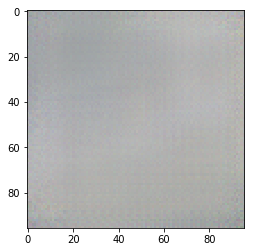

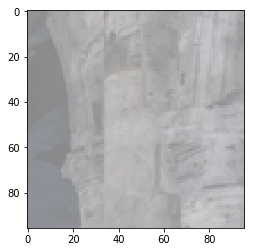

--------------------------------------------------------------------------------------


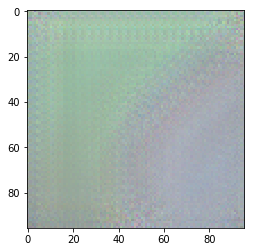

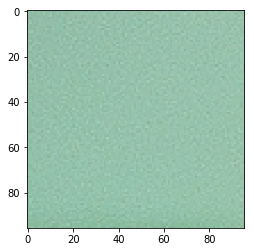

--------------------------------------------------------------------------------------


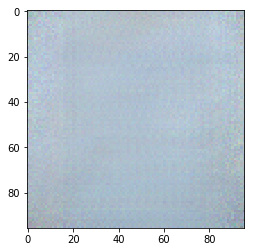

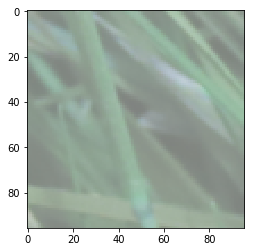

--------------------------------------------------------------------------------------


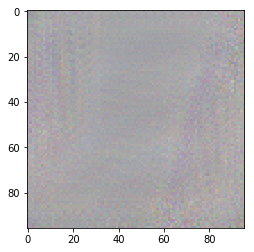

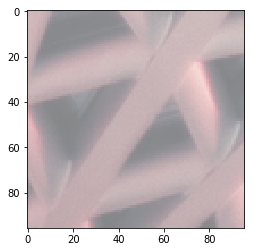

--------------------------------------------------------------------------------------


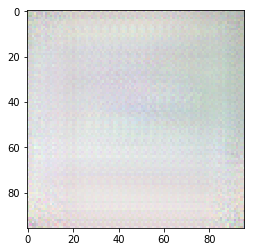

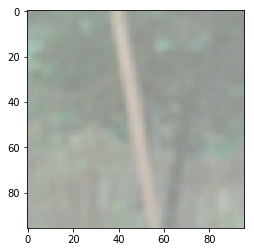

--------------------------------------------------------------------------------------


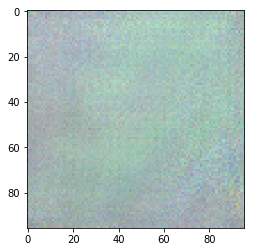

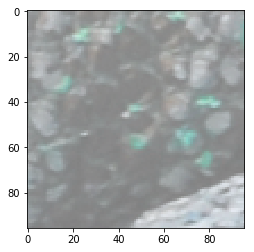

--------------------------------------------------------------------------------------


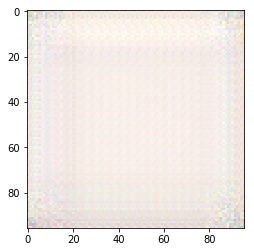

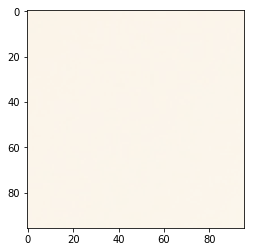

--------------------------------------------------------------------------------------


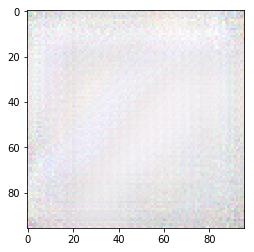

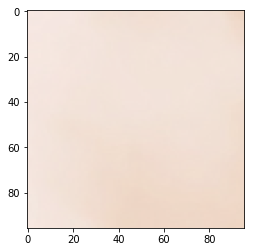

--------------------------------------------------------------------------------------


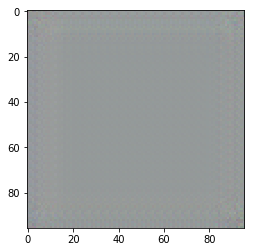

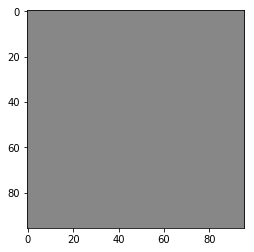

--------------------------------------------------------------------------------------


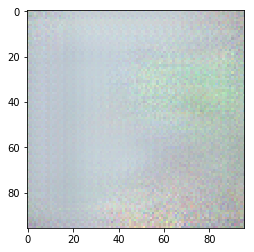

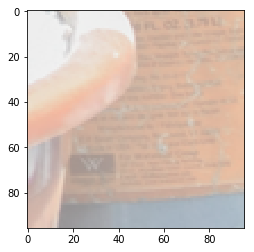

--------------------------------------------------------------------------------------


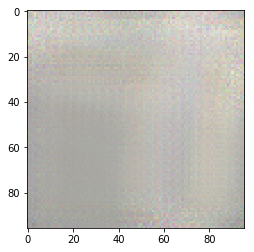

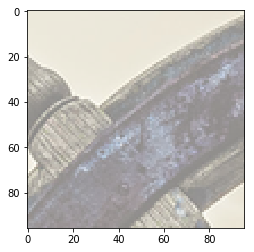

--------------------------------------------------------------------------------------
Epoch 50/50:
Train Loss: 0.2185
Test(Validation) Loss: 0.2025
[50 / 50] 	Learning_rate: 0.0001	 train_loss: 0.2185	 test_loss: 0.2025


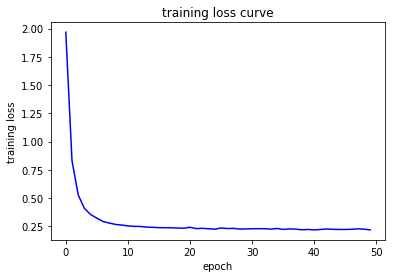

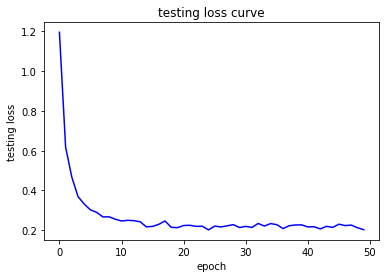

In [24]:
run_model(my_model, epochs, loss_fn, lr, lr_decay, device, train_loader, test_loader, save)

In [25]:
# save model

save_path = './result/model1.pt'
torch.save(my_model.state_dict(), save_path)

In [26]:
# get model saved
save_path = './result/model1.pt'
saved_parametes = torch.load(save_path)
saved_parametes

OrderedDict([('F_1.weight', tensor([[[[ 6.4159e-01, -2.4242e-01,  2.6141e-01],
                        [ 1.0748e-01,  5.6386e-02, -1.7874e-01],
                        [ 7.8270e-02, -1.7075e-01, -2.9490e-01]],
              
                       [[ 1.4413e-01,  2.9227e-01, -4.3566e-01],
                        [ 8.8968e-02, -9.0553e-02, -4.3231e-01],
                        [-1.5159e-01, -1.8758e-01,  8.0199e-02]],
              
                       [[-3.5455e-02,  1.3840e-01,  3.4933e-02],
                        [-4.2308e-02, -1.4527e-03,  4.6619e-01],
                        [ 4.7428e-02, -1.8322e-01, -4.5717e-01]]],
              
              
                      [[[-1.9337e-01,  1.0623e-01,  1.3619e-01],
                        [ 6.0582e-01, -3.7212e-02, -4.2077e-02],
                        [-1.5861e-01, -4.0295e-01,  2.5376e-01]],
              
                       [[-4.3366e-01, -9.7781e-02,  6.9840e-02],
                        [-1.0173e-01,  1.0563e-01, -6.6143e-0

In [27]:
new_model = model.RDN(scale=4)
new_model.apply(weights_init_kaiming)
new_model.load_state_dict(saved_parametes)

/home/jovyan/lab_project/utils.py:105: UserWarning: nn.init.kaiming_normal is now deprecated in favor of nn.init.kaiming_normal_.
  init.kaiming_normal(m.weight.data)
